# Preprocessing Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Image Preprocessing

In [ ]:
# Library yang digunakan dalam Preprocessing
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
from google.colab import files
import matplotlib.pyplot as plt
import zipfile, os
import pandas as pd

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import cv2

In [ ]:
# dir_path = '/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_2023_2022/fakta'


In [ ]:
# for filename in os.listdir(dir_path):
#     full_path = os.path.join(dir_path, filename)
#     if os.path.isfile(full_path):
#         # Menggunakan ekspresi reguler untuk mencocokkan nomor setelah tanda '_'
#         match = re.search(r'_(\d+)', filename)
#         if match:
#             number = int(match.group(1))
#             if number > 3881:
#                 os.remove(full_path)
#                 print(f"File {filename} dihapus.")


### Augmentasi Data Gambar

In [ ]:
# Mengubah data ukuran data gambar
width = 224
height = 224
batch_size = 4

aug_rps_train = ImageDataGenerator(
    rescale=1./255,
    preprocessing_function=lambda x: tf.image.resize_with_pad(x, target_height=height, target_width=width),
    validation_split=0.2
)

aug_rps_val = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
)


### Spliting Data Gambar

In [ ]:
# membuat data trainig dan testing
train_gen = aug_rps_train.flow_from_directory(
    '/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_2023_2022',
    target_size= (height, width),
    batch_size=batch_size,
    class_mode='binary',
    shuffle=False,
    subset='training'
)
val_gen = aug_rps_val.flow_from_directory(
    '/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_2023_2022',
    target_size= (height, width),
    batch_size=batch_size,
    class_mode='binary',
    shuffle=False,
    subset='validation'
)

Found 3103 images belonging to 2 classes.
Found 775 images belonging to 2 classes.


In [ ]:
# Mengubah gambar menjadi array untuk data gambar
# run ulang dari atas jika ValueError: could not broadcast input array from shape (224,224,3) into shape (150,200,3)
X_train_images = []
X_train_filenames = []
X_test_images = []
X_test_filenames = []
i = 0
k=0
# iterations = 1  # Ganti dengan jumlah iterasi yang diinginkan

# Mengambil data dari train_gen
for _ in range(len(train_gen)):
    i += 1
    print(i)
    images, labels = next(train_gen)
    filenames = train_gen.filenames  # Mendapatkan nama file dari generator
    X_train_images.extend(images)
    X_train_filenames.extend(filenames)  # Menambahkan nama file ke dalam array

# Mengambil data dari val_gen
for _ in range(len(val_gen)):
    k += 1
    print(k)
    images, labels = next(val_gen)
    filenames = val_gen.filenames  # Mendapatkan nama file dari generator
    X_test_images.extend(images)
    X_test_filenames.extend(filenames)  # Menambahkan nama file ke dalam array

In [ ]:
# [i for i in X_train_filenames]

In [ ]:
# # Simpan array NumPy ke dalam file
# np.save('X_train_images_fix2.npy', X_train_images)
# np.save('X_test_images_fix2.npy', X_test_images)

In [ ]:
# Membaca data dari file
X_train_images_np = np.load('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/X_train_images_fix2.npy')
X_test_images_np = np.load('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/X_test_images_fix2.npy')

In [ ]:
# Inisialisasi DataFrame
df_gen_train = pd.DataFrame({'image_path': train_gen.filepaths, 'label': train_gen.labels})
df_gen_val = pd.DataFrame({'image_path': val_gen.filepaths, 'label': val_gen.labels})



In [ ]:
# Memisahkan nama file dan indeks
df_gen_train[['image_name', 'index_terpilih']] = df_gen_train['image_path'].str.rsplit('_', n=1, expand=True)

# Konversi kolom 'index_terpilih' menjadi integer
df_gen_train['index_terpilih'] = df_gen_train['index_terpilih'].str.extract('(\d+)').astype(int)

# Mengatur kolom 'image_path' menjadi indeks DataFrame
df_gen_train.set_index('index_terpilih', inplace=True)

# Memisahkan nama file dan indeks
df_gen_val[['image_name', 'index_terpilih']] = df_gen_val['image_path'].str.rsplit('_', n=1, expand=True)

# Konversi kolom 'index_terpilih' menjadi integer
df_gen_val['index_terpilih'] = df_gen_val['index_terpilih'].str.extract('(\d+)').astype(int)

# Mengatur kolom 'image_path' menjadi indeks DataFrame
df_gen_val.set_index('index_terpilih', inplace=True)


# df_gen_train.sort_index(inplace=True)
# df_gen_val.sort_index(inplace=True)

In [ ]:
df_gen_train

,image_path,label,image_name
index_terpilih,,,
2631,/content/drive/MyDrive/Colab Notebooks/ml_stor...,0,/content/drive/MyDrive/Colab Notebooks/ml_stor...
2366,/content/drive/MyDrive/Colab Notebooks/ml_stor...,0,/content/drive/MyDrive/Colab Notebooks/ml_stor...
3018,/content/drive/MyDrive/Colab Notebooks/ml_stor...,0,/content/drive/MyDrive/Colab Notebooks/ml_stor...
2272,/content/drive/MyDrive/Colab Notebooks/ml_stor...,0,/content/drive/MyDrive/Colab Notebooks/ml_stor...
3873,/content/drive/MyDrive/Colab Notebooks/ml_stor...,0,/content/drive/MyDrive/Colab Notebooks/ml_stor...
...,...,...,...
1730,/content/drive/MyDrive/Colab Notebooks/ml_stor...,1,/content/drive/MyDrive/Colab Notebooks/ml_stor...
1355,/content/drive/MyDrive/Colab Notebooks/ml_stor...,1,/content/drive/MyDrive/Colab Notebooks/ml_stor...
697,/content/drive/MyDrive/Colab Notebooks/ml_stor...,1,/content/drive/MyDrive/Colab Notebooks/ml_stor...


#### Save and Checking

In [ ]:
# print(len(X_train_images_np))
# print(len(X_test_images_np))

In [ ]:
# train_gen.filenames

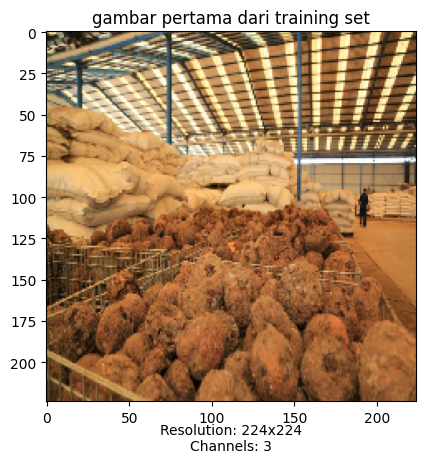

In [ ]:

# Menampilkan informasi gambar pada indeks pertama training Set
first_image = X_train_images_np[0]

# Mendapatkan image properties
height, width = first_image.shape[:2]
channels = 1 if len(first_image.shape) == 2 else first_image.shape[2]

# tamilkan informasi beserta gambar
plt.imshow(first_image, cmap='gray' if channels == 1 else None)
plt.title('gambar pertama dari training set')
plt.text(0.5, -0.1, f'Resolution: {width}x{height}\nChannels: {channels}',
         horizontalalignment='center', verticalalignment='center',
         transform=plt.gca().transAxes)
plt.show()

#### Visualize Data Proportion

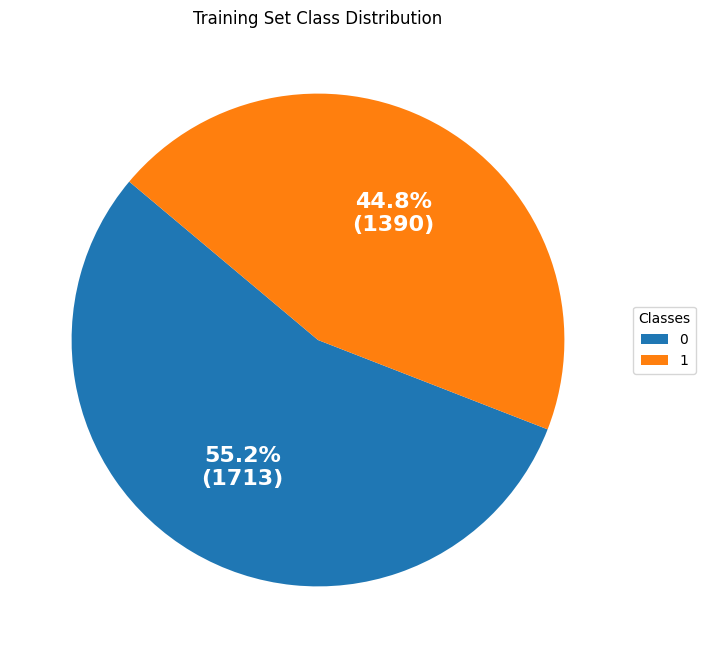

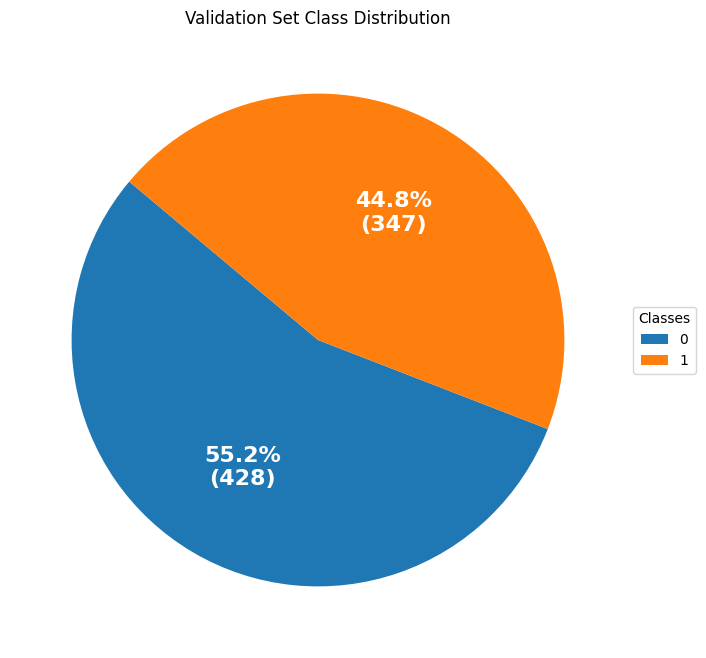

In [ ]:
# Function to plot pie chart with counts
def plot_pie_chart(df, title):
    class_counts = df['label'].value_counts()
    class_labels = list(class_counts.index)

    plt.figure(figsize=(8, 8))
    plt.title(title)
    wedges, texts, autotexts = plt.pie(class_counts, labels=class_labels, autopct=lambda p: '{:.1f}%\n({:d})'.format(p, int(round(p * sum(class_counts) / 100))),
                                      startangle=140, textprops=dict(color="w"))

    plt.setp(autotexts, size=16, weight="bold")

    plt.legend(wedges, class_labels, title="Classes", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

    plt.show()

# Plotting pie chart for training set
plot_pie_chart(df_gen_train, 'Training Set Class Distribution')

# Plotting pie chart for validation set
plot_pie_chart(df_gen_val, 'Validation Set Class Distribution')

## Text Preprocessing

Dataset disimpan dalam format Dataframe pada variable df

In [ ]:
import nltk
import pandas as pd
import re
import string

import matplotlib.pyplot as plt
import seaborn as sns
from nltk.tokenize import word_tokenize
!pip install Sastrawi
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
import statistics
import math  # Import the math module
nltk.download('punkt')


from nltk.probability import FreqDist
from nltk.corpus import stopwords
nltk.download('punkt')
plt.style.use('ggplot')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.7/209.7 kB 1.9 MB/s eta 0:00:00


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


### Explore Data

In [ ]:
# Membuat dua DataFrame terpisah untuk hoaks dan fakta
df_hoaks = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_2023_2022.xlsx')
df_fakta = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/half_republika_2023_2024.xlsx')
df_total = pd.concat([df_hoaks, df_fakta], ignore_index=True)
df_fakta.tail(2)

,Unnamed: 0,link,title,tag,image,date,paragraphs
2139,3880,https://sport.republika.co.id/berita/rr5plj456...,Alessandro Nesta Beri Saran kepada Bek Milan D...,"<a href=""https://republika.co.id/tag/alessandr...",https://static.republika.co.id/uploads/images/...,\n Selasa 07 Mar 2023 23:06 WIB,"['REPUBLIKA.CO.ID,\xa0MILAN -- Mantan bek AC M..."
2140,3881,https://sport.republika.co.id/berita/rr5rcb456...,Livescore Hasil Piala Asia U-20; Berjuang Kera...,"<a href=""https://republika.co.id/tag/piala-dun...",https://static.republika.co.id/uploads/images/...,\n Selasa 07 Mar 2023 23:04 WIB,"['REPUBLIKA.CO.ID,\xa0FERGANA -- Timnas Indone..."


In [ ]:

# Download stopwords jika belum dilakukan sebelumnya
nltk.download('stopwords')

# Tokenisasi dan penghapusan stopwords
stop_words = set(stopwords.words('indonesian'))

def calculate_freq_distribution(text_column):
    # Menggabungkan semua teks dalam satu paragraf
    all_text = ' '.join(text_column.dropna())

    # Tokenisasi kata
    tokens = word_tokenize(all_text)

    # Menghapus stopwords dan tanda baca
    filtered_tokens = [word.lower() for word in tokens if word.isalpha() and word.lower() not in stop_words]

    # Menghitung frekuensi kata
    freq_dist = FreqDist(filtered_tokens)
    return freq_dist

def classify_frequency(freq_dist):
    total_freq = sum(freq_dist.values())
    median_freq = statistics.median(freq_dist.values())
    avg_freq = total_freq / len(freq_dist)

    low_freq_tokens = [token for token, freq in freq_dist.items() if freq < math.floor(0.8 * median_freq)]
    median_freq_tokens = [token for token, freq in freq_dist.items() if math.floor(0.8 * median_freq) <= freq < math.floor(1.2 * median_freq)]
    high_freq_tokens = [token for token, freq in freq_dist.items() if freq >= math.floor(1.2 * median_freq)]

    return low_freq_tokens, median_freq_tokens, high_freq_tokens, total_freq, median_freq



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# Keseluruhan
freq_dist_total = calculate_freq_distribution(df_total['paragraphs'])
low_freq_total, median_freq_total, high_freq_total, total_freq_total, median_total = classify_frequency(freq_dist_total)

# Menampilkan hasil
print("Hoaks:")
print("Low Frequency Tokens:", low_freq_total)
print("Median Frequency Tokens:", median_freq_total)
print("High Frequency Tokens:", high_freq_total)
print("Total Frequency:", total_freq_total)
print("Banyak Jenis Token:", len(freq_dist_total))
print("Median Frequency:", median_total)

Hoaks:
Low Frequency Tokens: []
Median Frequency Tokens: ['newskantor', 'hangusemosi', 'membacaka', 'lucifer', 'wd', 'bapau', 'aniesganjar', 'gondangdia', 'berjema', 'newsjokowi', 'panikahok', 'menucapkan', 'pesugihan', 'goibsaya', 'seriushubungi', 'sender', 'wilm', 'direimburse', 'makasi', 'pelamar', 'nglonte', 'personfinal', 'detroit', 'michigan', 'slide', 'asiamediatelevisi', 'cushion', 'pads', 'copolymer', 'granules', 'foam', 'pengaplikasian', 'terhantam', 'timsar', 'terevakuasi', 'bhuana', 'tabas', 'semburkan', 'kesuluruhan', 'menipulasi', 'menyeramkan', 'ditujuan', 'digratisin', 'ama', 'syukron', 'papiloma', 'mandul', 'nasionalnya', 'dah', 'mengepalkan', 'kememteriam', 'suardika', 'mirwan', 'asral', 'menghacurkan', 'tirtoyoso', 'martharini', 'christiningsih', 'semmi', 'bersalawat', 'saung', 'ziyadatul', 'layaran', 'subspesialistik', 'perserta', 'antihoaxkesehatan', 'istanahasto', 'kristanto', 'bernaama', 'mrupakan', 'mdpasangan', 'makannya', 'ciganjur', 'berear', 'modelnya', 'mas

In [ ]:

# Hoaks
freq_dist_hoaks = calculate_freq_distribution(df_hoaks['paragraphs'])
low_freq_hoaks, median_freq_hoaks, high_freq_hoaks, total_freq_hoaks, median_hoaks = classify_frequency(freq_dist_hoaks)

# Fakta
freq_dist_fakta = calculate_freq_distribution(df_fakta['paragraphs'])
low_freq_fakta, median_freq_fakta, high_freq_fakta, total_freq_fakta, median_fakta = classify_frequency(freq_dist_fakta)

# Menampilkan hasil
print("Hoaks:")
print("Low Frequency Tokens:", low_freq_hoaks)
print("Median Frequency Tokens:", median_freq_hoaks)
print("High Frequency Tokens:", high_freq_hoaks)
print("Total Frequency:", total_freq_hoaks)
print("Banyak Jenis Token:", len(freq_dist_hoaks))
print("Median Frequency:", median_hoaks)

print("\nFakta:")
print("Low Frequency Tokens:", low_freq_fakta)
print("Median Frequency Tokens:", median_freq_fakta)
print("High Frequency Tokens:", high_freq_fakta)
print("Total Frequency:", total_freq_fakta)
print("Banyak Jenis Token:", len(freq_dist_fakta))
print("Median Frequency:", median_fakta)

Hoaks:
Low Frequency Tokens: []
Median Frequency Tokens: ['newskantor', 'hangusemosi', 'dilahap', 'jago', 'membacaka', 'tagline', 'lucifer', 'wd', 'bapau', 'aniesganjar', 'gondangdia', 'berjema', 'newsjokowi', 'panikahok', 'wakilnya', 'menucapkan', 'maja', 'bayangan', 'terselesaikan', 'pesugihan', 'goibsaya', 'seriushubungi', 'sender', 'dapet', 'wilm', 'tulisannya', 'direimburse', 'makasi', 'nabati', 'pelamar', 'berprestasi', 'nglonte', 'personfinal', 'mikroskop', 'detroit', 'michigan', 'memasukkannya', 'slide', 'education', 'paul', 'plastic', 'asiamediatelevisi', 'quality', 'cushion', 'pads', 'virgin', 'copolymer', 'granules', 'foam', 'pengaplikasian', 'kelebihannya', 'terhantam', 'timsar', 'terevakuasi', 'tewasnya', 'bhuana', 'karangasem', 'tabas', 'banjarmasin', 'semburkan', 'menyemburkan', 'semburan', 'balap', 'commitment', 'kesuluruhan', 'menggubah', 'mirna', 'menipulasi', 'menyeramkan', 'ditujuan', 'menopause', 'anehnya', 'sasarannya', 'laku', 'digratisin', 'lho', 'ama', 'faham',

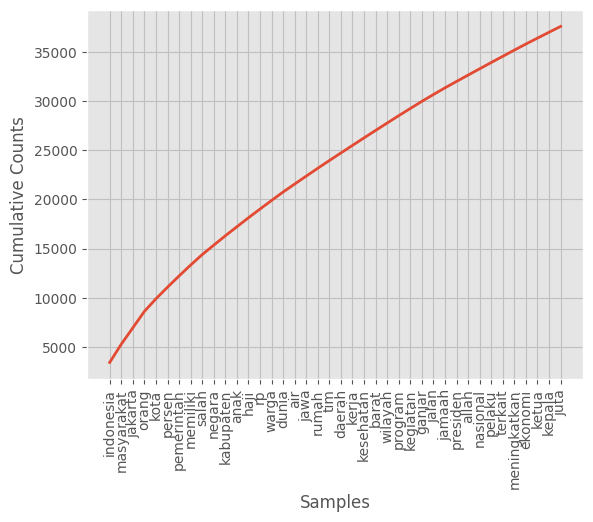

<Axes: xlabel='Samples', ylabel='Cumulative Counts'>

In [ ]:
freq_dist_fakta.plot(40,cumulative=True)

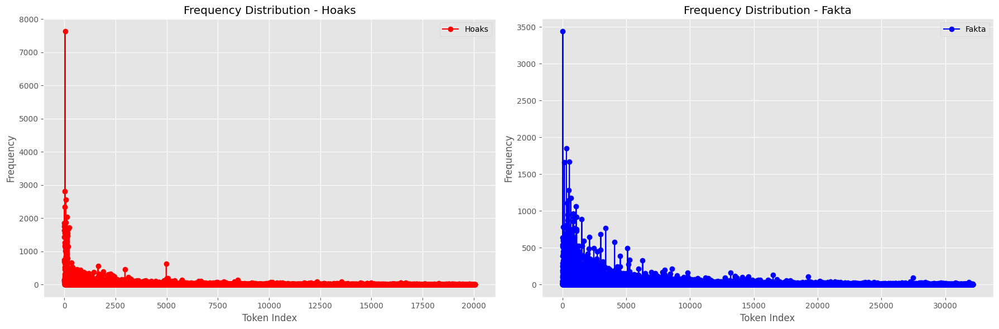

In [ ]:

# Plot untuk Hoaks dan Fakta secara bersampingan
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(18, 6))

# Plot Hoaks
axes[0].plot(list(freq_dist_hoaks.values()), label='Hoaks', color='red', linestyle='-', marker='o')
axes[0].set_title('Frequency Distribution - Hoaks')
axes[0].set_xlabel('Token Index')
axes[0].set_ylabel('Frequency')
axes[0].legend()

# Plot Fakta
axes[1].plot(list(freq_dist_fakta.values()), label='Fakta', color='blue', linestyle='-', marker='o')
axes[1].set_title('Frequency Distribution - Fakta')
axes[1].set_xlabel('Token Index')
axes[1].set_ylabel('Frequency')
axes[1].legend()

plt.tight_layout()
plt.show()


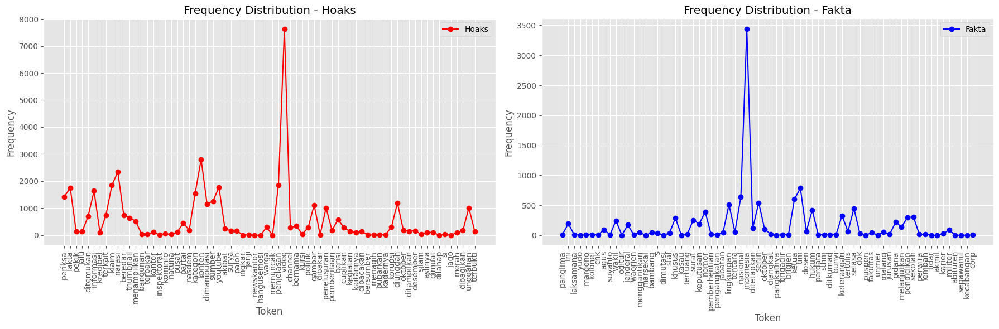

In [ ]:
# Plot untuk Hoaks dan Fakta secara bersampingan
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(18, 6))

# Plot Hoaks
axes[0].plot(list(freq_dist_hoaks.keys())[:70], list(freq_dist_hoaks.values())[:70], label='Hoaks', color='red', linestyle='-', marker='o')
axes[0].set_title('Frequency Distribution - Hoaks')
axes[0].set_xlabel('Token')
axes[0].set_ylabel('Frequency')
axes[0].legend()
axes[0].tick_params(axis='x', rotation=90)  # Rotasi label token

# Plot Fakta
axes[1].plot(list(freq_dist_fakta.keys())[:70], list(freq_dist_fakta.values())[:70], label='Fakta', color='blue', linestyle='-', marker='o')
axes[1].set_title('Frequency Distribution - Fakta')
axes[1].set_xlabel('Token')
axes[1].set_ylabel('Frequency')
axes[1].legend()
axes[1].tick_params(axis='x', rotation=90)  # Rotasi label token

plt.tight_layout()
plt.show()


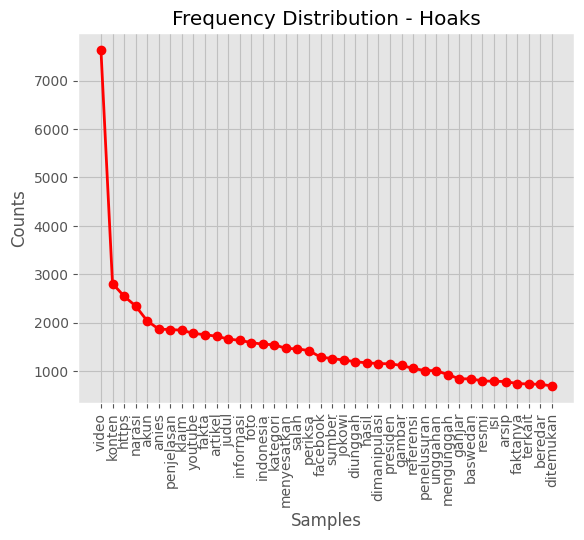

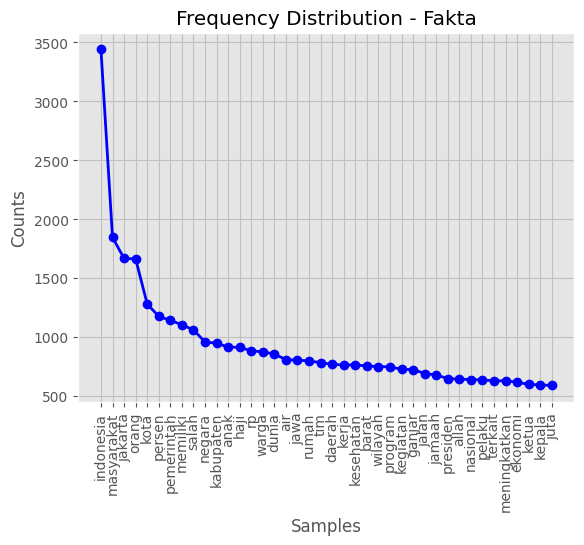

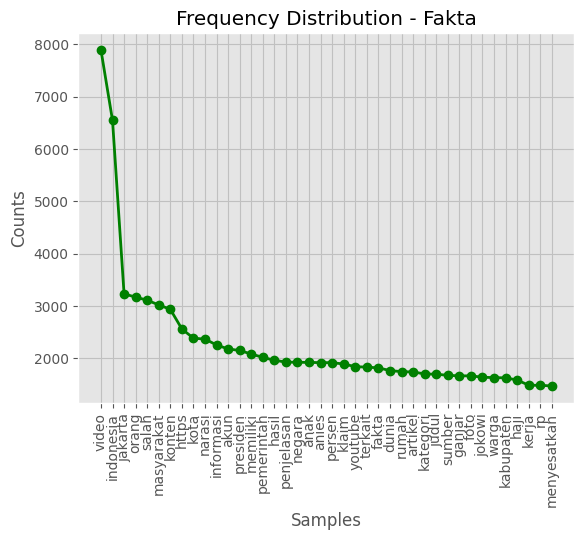

In [ ]:

# Plot Hoaks
freq_dist_hoaks.plot(40, cumulative=False, title='Frequency Distribution - Hoaks', color='red', marker='o')
plt.show()


# Plot Fakta
freq_dist_fakta.plot(40, cumulative=False, title='Frequency Distribution - Fakta', color='blue', marker='o')
plt.show()

# Plot Fakta
freq_dist_total.plot(40, cumulative=False, title='Frequency Distribution - Fakta', color='green', marker='o')
plt.show()

### Text Claening

#### Membersihkan paragraft

In [ ]:
df = pd.read_excel("/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/combine_2023_2022.xlsx")
df.tail(2)

,Unnamed: 0,link,title,tag,image,date,paragraphs
5163,5163,https://ihram.republika.co.id/berita/rnt7ka313...,Konsep Kesehatan Mental Menurut Dokter Muslim ...,"<a href=""https://republika.co.id/tag/ilmu-kedo...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:30 WIB,"['IHRAM.CO.ID,\xa0Konsep kesehatan mental atau..."
5164,5164,https://ekonomi.republika.co.id/berita/rnt9jv4...,Alih Fungsi Lahan Pertanian Tembus 100 Ribu He...,"<a href=""https://republika.co.id/tag/kementan""...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:28 WIB,"['REPUBLIKA.CO.ID,\xa0JAKARTA -- Kementerian P..."


In [ ]:
negara = ["Afganistan", "Afrika Selatan", "Afrika Tengah", "Albania", "Algeria", "Amerika Serikat", "Andorra", "Angola", "Antigua dan Barbuda", "Antillen Belanda", "Arab Saudi", "Argentina", "Armenia", "Aruba", "Australia", "Austria", "Azerbaijan",
 "Bahama", "Bahrain", "Bangladesh", "Barbados", "Belarus", "Belgia", "Belize", "Benin", "Bhutan", "Bolivia", "Bosnia dan Herzegovina", "Botswana", "Brunei Darussalam", "Bulgaria", "Burkina Faso", "Burundi", "Cile", "China", "Colombia", "Comoros",
 "Republik Demokratik Kongo", "Republik Kongo", "Korea Selatan", "Korea Utara", "Kosta Rika", "Kroasia", "Kuba", "Curaçao", "Siprus", "Ceko", "Denmark", "Jibuti", "Dominika", "Republik Dominika", "Ekuador", "El Salvador", "Guinea Khatulistiwa", "Eritrea", "Estonia", "Ethiopia", "Federasi Mikronesia", "Fiji", "Filipina", "Finlandia", "Prancis", "Polinesia Prancis", "Gabon", "Gambia", "Georgia", "Ghana", "Grenada", "Yunani", "Greenland", "Grenadines", "Guatemala", "Guinea", "Guinea-Bissau", "Guyana", "Haiti", "Honduras", "Hongaria",
 "Islandia", "India", "Indonesia", "Iran", "Irak", "Irlandia", "Israel", "Italia", "Jamaika", "Jepang", "Jerman", "Jersey",
 "Yordania", "Kazakhstan", "Kenya", "Kiribati", "Kosovo", "Kuwait", "Kirgizstan", "Laos", "Latvia", "Lebanon", "Lesotho", "Liberia", "Libya", "Liechtenstein", "Lituania", "Luksemburg",
 "Madagaskar", "Malawi", "Malaysia", "Maladewa", "Mali", "Malta", "Kepulauan Marshall", "Mauritania", "Mauritius", "Mayotte", "Meksiko", "Republik Federal Mikronesia", "Moldova", "Monako", "Mongolia", "Montenegro", "Maroko", "Mozambik", "Myanmar", "Namibia", "Nauru", "Nepal", "Belanda", "Kaledonia Baru", "Selandia Baru", "Nikaragua", "Niger", "Nigeria", "Macedonia Utara", "Norwegia", "Oman", "Pakistan", "Palau", "Palestina", "Panama", "Papua Nugini", "Paraguay", "Peru", "Polandia", "Portugal", "Puerto Rico", "Qatar", "Rumania", "Rusia",
 "Rwanda", "Saint Kitts dan Nevis",  "Saint Lucia",  "Saint Vincent dan Grenadines",  "Samoa",  "San Marino",  "Sao Tome dan Principe",  "Arab Saudi",  "Senegal",  "Serbia",  "Seychelles",  "Sierra Leone",  "Singapura",  "Slovakia",  "Slovenia",  "Solomon",  "Somalia",  "Spanyol",  "Sri Lanka",  "Sudan",  "Sudan Selatan",  "Suriah",  "Suriname",  "Swedia",  "Swiss",  "Taiwan",  "Tajikistan",  "Tanzania",  "Thailand",  "Timor Leste",  "Togo",  "Tonga",  "Trinidad dan Tobago",  "Tunisia",  "Turki",  "Turkmenistan",  "Tuvalu",  "Uganda",  "Ukraina",  "Uni Emirat Arab",
 "Inggris",  "Uruguay",  "Uzbekistan",  "Vanuatu",  "Vatikan",  "Venezuela",  "Vietnam",  "Wales",  "Yemen",  "Zambia",  "Zimbabwe"]
negara = [k.lower() for k in negara]

ibukota_negara = [
    "Kabul", "Pretoria", "Bangui", "Tirana", "Aljir", "Washington, D.C.", "Andorra la Vella", "Luanda", "Saint John's",
    "Willemstad", "Riyadh", "Buenos Aires", "Yerevan", "Oranjestad", "Canberra", "Wina", "Baku",
    "Nassau", "Manama", "Dhaka", "Bridgetown", "Minsk", "Brussels", "Belmopan", "Porto-Novo", "Thimphu", "La Paz", "Sarajevo", "Gaborone",
    "Bandar Seri Begawan", "Sofia", "Ouagadougou", "Bujumbura", "Santiago", "Beijing", "Bogotá", "Moroni", "Kinshasa", "Brazzaville", "Seoul", "Pyongyang",
    "San José", "Zagreb", "Havana", "Willemstad", "Nicosia", "Prague", "Copenhagen", "Djibouti", "Roseau", "Santo Domingo",
    "Quito", "San Salvador", "Malabo", "Asmara", "Tallinn", "Addis Ababa", "Palikir", "Suva", "Manila", "Helsinki", "Paris", "Papeete", "Libreville", "Banjul", "Tbilisi", "Accra", "St. George's", "Athens", "Nuuk", "Kingstown", "Guatemala City", "Conakry", "Bissau", "Georgetown", "Port-au-Prince", "Tegucigalpa", "Budapest",
    "Reykjavik", "New Delhi", "Jakarta", "Tehran", "Baghdad", "Dublin", "Jerusalem", "Rome", "Kingston", "Tokyo", "Berlin", "Saint Helier",
    "Amman", "Nur-Sultan", "Nairobi", "Tarawa", "Pristina", "Kuwait City", "Bishkek", "Vientiane", "Riga", "Beirut", "Maseru", "Monrovia", "Tripoli", "Vaduz", "Vilnius", "Luxembourg",
    "Antananarivo", "Lilongwe", "Kuala Lumpur", "Malé", "Bamako", "Valletta", "Majuro", "Nouakchott", "Port Louis", "Mamoudzou", "Mexico City", "Palikir", "Chisinau", "Monaco", "Ulaanbaatar", "Podgorica", "Rabat", "Maputo", "Naypyidaw", "Windhoek", "Yaren", "Kathmandu", "Amsterdam", "Nouméa", "Wellington", "Managua", "Niamey", "Abuja", "Skopje", "Oslo", "Muscat", "Islamabad", "Ngerulmud", "East Jerusalem", "Panama City", "Port Moresby", "Asunción", "Lima", "Warsaw", "Lisbon", "San Juan", "Doha", "Bucharest", "Moscow",
    "Kigali", "Basseterre", "Castries", "Kingstown", "Apia", "San Marino", "São Tomé", "Riyadh", "Dakar", "Belgrade", "Victoria", "Freetown", "Singapore", "Bratislava", "Ljubljana", "Honiara", "Mogadishu", "Madrid", "Colombo", "Khartoum", "Juba", "Damascus", "Paramaribo", "Stockholm", "Bern", "Taipei", "Dushanbe", "Dodoma", "Bangkok", "Dili", "Lomé", "Nuku'alofa", "Port of Spain", "Tunis", "Ankara", "Ashgabat", "Funafuti", "Kampala", "Kyiv", "Abu Dhabi",
    "London", "Montevideo", "Tashkent", "Port Vila", "Vatican City", "Caracas", "Hanoi", "Cardiff", "Sanaa", "Lusaka", "Harare"
]
ibukota_negara = [k.lower() for k in ibukota_negara]

In [ ]:
provinsi_kabupaten = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/daftar-nama-daerah.csv')
provinsi_kabupaten['name'] = [k.lower() for k in provinsi_kabupaten['name']]

In [ ]:
# [k for k in provinsi_kabupaten['name']]

In [ ]:
kata_depan_tempat = r'\b(?:di|ke|dari|atas|bawah|depan|belakang|kiri|kanan|dalam|luar|dekat|jauh|sekeliling|sekitar|tengah|pinggir)\b'
kata_depan_arah = r'\b(?:ke|dari|menuju|ke\ arah|dari\ arah|melalui|lewat|sepanjang|di\ sepanjang|di\ atas|di\ bawah|di\ depan|di\ belakang|di\ kiri|di\ kanan)\b'
kata_depan_waktu = r'\b(?:pada|sejak|sampai|dalam|selama|pada\ saat|sewaktu|setelah|sebelum|demi|hingga)\b'
kata_depan_asal = r'\b(?:dari|berasal\ dari|asal)\b'
kata_depan_tujuan = r'\b(?:ke|menuju|untuk|demi)\b'
kata_depan_perbandingan = r'\b(?:seperti|bagaikan|laksana)\b'
kata_depan_sebab_akibat = r'\b(?:karena|sebab|oleh\ karena|akibat)\b'
kata_depan_lain = r'\b(?:beserta|bersama|dengan|daripada|terhadap|untuk|buat|demi|bagi|akan|antara|demi|hingga|kecuali|tentang|seperti|serta|tanpa)\b'
kata_hubung = r'\b(?:dan|atau|juga|serta|tetapi|namun|sebab|karena|oleh\ karena\ itu|hingga|sampai|selain|bahkan|meskipun|sehingga)\b'
kata_sandang = r'\b(?:sang|si)\b'

# Daftar kata keterangan dan kata ganti
kata_keterangan = r'(cepat|perlahan|segera|selalu|sering|jarang|kemarin|besok|sekarang|nanti|juga|sama|hanya|malah|baru|sudah|terlalu|mungkin|pasti)\b'

# Daftar kata ganti yang berhubungan dengan subjek
kata_ganti_subjek = r'(saya|kamu|dia|kita|mereka|ini|itu|siapa|apa|yang|mana|milik|sendiri|semua|tak|dia|kalian|barangkali|aku|engkau)'

# Daftar kata ganti yang berhubungan dengan objek
kata_ganti_objek = r'(dia|mereka|itu|siapa|apa|yang|mana|milik|sendiri|semua|tak|dia|kalian|barangkali)'

# List singkatan yang akan dihapus
singkatan_to_remove = [
    'ASAP', 'DIY', 'FAQ', 'RSVP', 'VIP', 'ETA', 'IQ', 'LSM', 'OTW', 'FYI', 'TBA', 'IMHO', 'FAQ',
    'AI', 'IoT', 'VR', 'AR', '5G', 'HTML', 'URL', 'CSS', 'API', 'CPU',
    'PBB', 'IMF', 'WHO', 'UNICEF', 'NASA', 'FBI', 'CIA', 'NSA', 'EU', 'ASEAN','UN', 'USA', 'UK', 'NATO',
    'CEO', 'CFO', 'CTO', 'CMO', 'COO', 'CIO', 'HRD', 'GM', 'MD', 'VP',
    'RUU', 'Pemilu', 'KMP', 'BPIP', 'KPK', 'BPK', 'TNI', 'Polri', 'ABRI', 'WNI', 'DPRD', 'Pemda', 'Kepres', 'Kepmen',
    'SK', 'SE', 'Regulasi', 'RUU Pilkada', 'RUU Pemilu', 'NU', 'PT', 'CV', 'GPA', 'SAT', 'GRE', 'PhD', 'ESL', 'STEM', 'EDU',
    'PhD', 'MD', 'JD', 'DDS', 'MBA', 'MSc', 'MA', 'BA', 'BS', 'EngD', 'PsyD', 'RN', 'CPA', 'CFA',
    'CEO', 'CFO', 'COO', 'CMO', 'CTO', 'CIO', 'HRD', 'GM', 'VP', 'CFO', 'CIO', 'CRO', 'CTO',
    'PDIP', 'PDI', 'Golkar', 'PKS', 'PAN', 'Gerindra', 'NasDem', 'PPP', 'KPU', 'MK', 'KMP', 'BPIP', 'KPK', 'BPK', 'TNI', 'Polri', 'ABRI', 'WNI', 'DPRD', 'Pemda', 'Kepres', 'Kepmen''DPR', 'MPR', 'Demokrat',
    'Menteri', 'Dirjen', 'Kapolri', 'Kadiv', 'Kadis', 'Kabag', 'Kasi', 'Kasat', 'Kasubbag', 'Wakil', 'Ketua', 'Sekretaris', 'Anggota', 'Pjs', 'Plt', 'Staf', 'Komisaris', 'Dubes',
    'UI', 'UGM', 'ITS', 'UNPAD', 'UNHAS', 'UNM', 'UNAIR', 'STAN', 'STIS', 'STSN', 'SEKOLAHPOLISI', 'KEMENAG', 'KEMENHUB', 'KEMENDIKBUD', 'KEMENKES', 'KEMENPORA', 'KEMENDESA', 'KEMENPAN-RB', 'BPS', 'BPOM', 'BKN',
    'FB', 'IG', 'TW', 'YT', 'WA', 'TG', 'LI', 'SC', 'TikTok', 'Snap', 'FB Messenger', 'DM', 'PM', 'IGTV',
    'AC', 'TV', 'DVD', 'PC', 'MP3', 'GPS', 'ATM', 'USB', 'WiFi', 'CCTV', 'SUV', 'LED', 'DSLR', 'HDTV', 'FM', 'DVR', 'LED TV', 'Blu-ray', 'HVAC', 'UPS', 'DVD Player', 'DSL', 'HDMI', 'IP Camera', 'RFID', 'UPS', 'ECG', 'ATM Machine', 'OLED TV', 'DSL Internet',
    'LCD TV', 'AM/FM Radio', 'RCA Cable', 'FM Radio', 'CRT Monitor', 'LED Monitor', 'RGB Cable', 'HDMI Cable', 'DVD Recorder', 'CD Player', 'VHS Player', 'VHS Recorder', 'HD DVD Player', 'VCR', 'RCA Connector', 'CRT TV', 'OLED Monitor', 'CRT Monitor', 'DVD-ROM',
    'HD DVD-ROM', 'CRT Display', 'HDD Recorder', 'LCD Monitor', 'LCD Display', 'LED Display', 'CFL Bulb', 'LED Bulb', 'CFL Light', 'LED Light', 'USB Cable', 'USB Drive', 'OLED Screen',
    'ASN', 'SK', 'SKP', 'PPK', 'LHKPN', 'BKN', 'UU', 'PP', 'SE', 'Kepres', 'Menteri', 'Kemen', 'Kepala Daerah', 'KADIN', 'RT/RW', 'KADIS', 'SEKDA', 'BKD', 'BAPPEDA', 'DPRD', 'APBD', 'PNS',
    'SKPD', 'SIPKD', 'ASN', 'PPK', 'Menteri', 'Kemen', 'Kepala Daerah', 'BPD', 'DPR', 'KPU', 'MK', 'BPIP', 'KPK', 'BPK', 'PPATK', 'Kemendagri', 'BUMN', 'BKPM', 'Ditjen', 'Ditjen',
    'Kemenhub', 'Puskesmas', 'BPJS Kesehatan', 'SKB', 'PKB', 'RT', 'RW', 'JL', 'JLN', 'pemkab', tbk, fc, menlu, umkm, gmp, pych, ggn, dki,
    swt, pssi, briptu, esq


]

frasa_to_remove = [
    'penjelasanberedarsebuah',
    'penjelasanberedar sebuah',
   'penjelasan beredar sebuah',
    'penjelasan halaman',
    'penjelasanhalaman',
    'penjelasansebuah',
    'penjelasanberedar',
        'penjelasan beredar',
        'penjelasan sebuah',
        'penjelasanchannel',
    'penjelasan channel',
        'penjelasan kanal',
    'penjelasankanal',
        'penjelasan',
        'hasilperiksafakta',
        'hasilperiksa fakta',
        'hasil periksa fakta'
    ]

# Remove numeric words and numeric representations
kata_angka = [
        'satu', 'dua', 'tiga', 'empat', 'lima',
        'enam', 'tujuh', 'delapan', 'sembilan',
        'sepuluh', 'sebelas', 'duabelas', 'tigabelas',
        'empatbelas', 'limabelas', 'enambelas', 'tujuhbelas',
        'delapanbelas', 'sembilanbelas', 'belasan', 'duapuluh', 'tigapuluh',
        'empatpuluh', 'limapuluh', 'enampuluh', 'tujuhpuluh',
        'delapanpuluh', 'sembilanpuluh', 'puluhan', 'seratus', 'seratusan', 'ratusan',
        'seribu', 'seribuan', 'ribuan', 'sejuta', 'jutaan', 'miliar', 'miliaran', 'triliun', 'triliunan'
    ]


In [ ]:
massa_regex = r'\b(kilogram|kg|ton|t|kiloton|kt|megaton|mt|gigaton|gt|kuintal|kwintal|kg|gram|g|mg|miligram|pound|lb|ounce|oz|stone|st)\b'
jarak_regex = r'\b(meter|m|kilometer|km|sentimeter|cm|milimeter|mm|mil|mile|yard|kaki|inchi|inci|thou|leauge|hektar|hektare|hasta|feet)\b'
volume_regex = r'\b(liter|l|galon|gallon|qt|kuintal|kwintal|ml)\b'
suhu_regex = r'\b(celsius|c|fahrenheit|f|kelvin|k)\b'

In [ ]:

def bersih_bersih(sentence):

  sentence = sentence.lower()
  sentence = re.sub(r'(REFRENCE|REFRENSI|RFERENSI|RFRENSI).*https://\S+', '', sentence, flags=re.DOTALL | re.IGNORECASE)
  sentence = re.sub(r'REFERENSI', '', sentence)  # Menghapus kata "REFERENSI"
  sentence = re.sub(r'\\n', ' ', sentence)  # Menghapus newline (\n)

  unicode_chars_to_remove = ['\\xa0', '\\u2063', '\\u2063\'', '\\u2022', '\\u2013', '\\u2026'] # Daftar karakter Unicode yang ingin dihapus
  for char in unicode_chars_to_remove:
      sentence = sentence.replace(char, '') # Menghapus karakter Unicode yang tidak diinginkan

  sentence = re.sub(r'^.*\[narasi\]:?["“‘]?(.*?)["“‘]?(?=\[|\Z)', '', sentence, flags=re.DOTALL) # Menghapus teks sebelum [narasi]
  sentence = re.sub(r'^(\\\\|-\\\\|-)\s*', '', sentence) # Menghapus kalimat yang diawali dengan '\\', '-\\', atau '-'
  sentence = re.sub(r'@\w+\s*', '', sentence) # Menghapus mention (pemberian tag)
  sentence = re.sub(r'#\w+\s*', '', sentence)# Menghapus hashtag

  sentence = re.sub(r'\d{4}-\d{2}-\d{2}\s\d{2}:\d{2}:\d{2}\.','',sentence) # Menghilangkan format tanggal dan waktu
  sentence = re.sub(r'\d{2}\s\w{3,}\s\d{4}.','', sentence) # Menghilangkan format tanggal "XX NAMA BULAN TAHUN"
  sentence = re.sub(r'(menit|mnt|thn|tahun|tahunan|minggu|mingguan|mg|hari|harian|hr|jam|jm|detik|dtk|sekon|bulan|bulanan|bln)*','', sentence) # Menghilangkan satuan waktu
  sentence = re.sub(r'(\d{1,}\s*gb|\d{1,}\s*kb|\d{1,}\s*mb|\d{1,}\s*tb|lte)',"", sentence) # Menghilangkan satuan byte dan kata lte
  sentence = re.sub(r'(ribu|ribuan|rb|jt|juta|jutaan|milyar|miliaran|miliar|triliun|triliunan|trilyun|rp|rupiah|dolar|yen|ringgit)',"", sentence) # Menghilangkan satuan uang
  sentence = re.sub(r'\w*\.*\w{1,}\.*\/\w{1,}','',sentence) # Menghilangkan pecahan
  sentence = re.sub(r'rp\s*\d{1,}\s','',sentence) # Menghilangkan jumlah tarif
  sentence = re.sub(massa_regex, '', sentence, flags=re.IGNORECASE)
  sentence = re.sub(jarak_regex, '', sentence, flags=re.IGNORECASE)
  sentence = re.sub(volume_regex, '', sentence, flags=re.IGNORECASE)
  sentence = re.sub(suhu_regex, '', sentence, flags=re.IGNORECASE)

  sentence = re.sub(r"\*\d{3,}\*\d{3,}\#","", sentence) # Menghilangkan kode aktivasi-1
  sentence = re.sub(r"\*\d{3,}\#","", sentence) # Menghilangkan kode aktivasi-2
  sentence = re.sub(r'https?\S+', '', sentence)  # Menghilangkan URL
  sentence = re.sub(r"https?://\S*|www\.\S+","", sentence) # Menghilangkan web

  sentence = re.sub(r'(\d{1,}\.*\d{0,})','', sentence) # Menghilangkan angka
  sentence = re.sub(r'[\U0001F600-\U0001F6FF]|[\U0001F300-\U0001F5FF]|[\U0001F900-\U0001F9FF]|[\U0001F1E0-\U0001F1FF]|[\U00002600-\U000027BF]|[\U0001F100-\U0001F1FF]|[\U0001F600-\U0001F64F]|[\U0001F680-\U0001F6FF]|[\U0001F1E6-\U0001F1FF]|[\U0001F910-\U0001F96B]|[\U0001F980-\U0001F9E0]',
                    '', sentence)  # Menghilangkan emoticon
  sentence = re.sub(r'[\u4E00-\u9FFF\u1100-\u11FF\u3130-\u318F\uAC00-\uD7AF\u30A0-\u30FF]+', '', sentence)# Menghapus teks dalam bahasa Tionghoa (Cina), Korea, dan Jepang
  sentence = re.sub(r'[\u0600-\u06FF\u0750-\u077F\u08A0-\u08FF\uFB50-\uFDFF\uFE70-\uFEFF]+', '', sentence)# Menghapus teks dalam bahasa Arab
  exclude_punctuation = set(string.punctuation).union(set([chr(i) for i in [34, 39, 8220, 8221, 8212, 8230, 8216, 8217, 8211 ]])).union(set(chr(j) for j in range(8208,8332))) # Menghapus tanda baca dari judul artikel, kecuali tanda kutip dan tanda petik dua
  sentence = ''.join(char for char in sentence if char not in exclude_punctuation)


  jenis_kata = f'{kata_depan_tempat}|{kata_depan_arah}|{kata_depan_waktu}|{kata_depan_asal}|{kata_depan_tujuan}|{kata_depan_perbandingan}|{kata_depan_sebab_akibat}|{kata_depan_lain}|{kata_keterangan}|{kata_ganti_objek}|{kata_ganti_subjek}|{kata_hubung}' # Menggabungkan semua kata depan dalam satu ekspresi reguler
  sentence = re.sub(jenis_kata, '', sentence) # Menghapus kata depan dari teks
  singkatan_pattern = r'\b(?:' + '|'.join(singkatan_to_remove) + r')\b' # regex untuk menghapus singkatan-singkatan
  sentence = re.sub(singkatan_pattern, '', sentence, flags=re.IGNORECASE) # Hapus singkatan dengan regex
  sentence = re.sub(r'\b\w\b', '', sentence) # Menghapus kata-kata dengan satu karakter
  sentence = re.sub(r'\b\w{26,}\b', '', sentence)# hapus kata lebih dari 25 characters

  # sentence = re.sub(r'\s+', ' ', sentence)  # Mengganti multiple spaces menjadi single space
  sentence = sentence.strip()
  print(sentence + "---------berhasil-----------" + '\n')

  return sentence

In [ ]:
df['text_bersih'] = df['paragraphs'].apply(bersih_bersih)
# df.head(2)

Streaming output truncated to the last 5000 lines.
republikacoid jakarta   umum asosiasi personal vaporizer indonesia apvi aryo andrianto mengaan rokok elektrik beotensi menjadi industri unggulan   indonesia industri rokok elektrik  ada    indonesia   mendt perhatian  dikenai cukai   akhirnya   terus berkembang kataaryo  diskusi  zat adiktif   kesehatan  jakarta beber waktu lalu menurut  saat  tidak ada negara  dunia  melarang penggunaan rokok elektrik  sejumlah negara  tadinya memberlkan pembatasan ketat  membuka diri  mempeaharui  saat  kata   kesehatan omnibus law terus menjadi diskursus publik salah satu poin  menuai pro  kontra adalah produk tembakau  dikategorikan sebagai zat adiktif   narkotika psikotropika  minuman beralkohol aryo menuturkan rokok elektrik merujuk  riset  sejumlah negara  inggris  new zealand  saat  ada enam  pengguna rokok elektrik  indonesia   membuka   lngan pekerjaan  industrinya   berkembang   berdampingan  petani tembakau ujarnya  menekankan pihaknya  ter

In [ ]:

def bersih_bersih_2(sentence):

  sentence = re.sub(r'\b(kabupaten|provinsi)\b', '', sentence, flags=re.IGNORECASE) # Hapus kata "kabupaten" dan "provinsi" dari kalimat

  for k_angka in kata_angka:
      sentence = re.sub(r'\b{}\b'.format(re.escape(k_angka)), '', sentence, flags=re.IGNORECASE)
  for frasa in frasa_to_remove:
      sentence = re.sub(r'\b{}\b'.format(re.escape(frasa)), '', sentence, flags=re.IGNORECASE)
  # Hapus nama-nama negara dari kalimat
  for negara_nama in negara:
      sentence = re.sub(r'\b{}\b'.format(re.escape(negara_nama)), '', sentence, flags=re.IGNORECASE)

   # Hapus nama-nama ibu kota negara dari kalimat
  for ibunegara_nama in ibukota_negara:
      sentence = re.sub(r'\b{}\b'.format(re.escape(ibunegara_nama)), '', sentence, flags=re.IGNORECASE)
  # Hapus nama-nama provinsi dan kabupaten dari kalimat
  for nama_daerah in provinsi_kabupaten['name']:
      sentence = re.sub(r'\b{}\b'.format(re.escape(nama_daerah)), '', sentence, flags=re.IGNORECASE)



  sentence = re.sub(r'\brepublikacoid\w*\b', '', sentence, flags=re.IGNORECASE)# Remove words starting with "republikacoid" (case-insensitive)
  sentence = re.sub(r'\b\w\b', '', sentence) # Menghapus kata-kata dengan satu karakter
  sentence = re.sub(r'[^a-zA-Z\s]', '', sentence)# Menghapus karakter selain Latin dan spasi
  sentence = re.sub(r'\s+', ' ', sentence)  # Mengganti multiple spaces menjadi single space
  sentence = sentence.strip()
  print(sentence + "---------berhasil-----------" + '\n')

  return sentence

In [ ]:
df['text_bersih'][1900] = bersih_bersih_2(df['text_bersih'][1900])

jungkook bts dikenal kerap mengejutkan army sebutan penggemar bts video dance terduganya kali jungkook berencana mengumumkan dance challengenya kepada para penggemarnya hal rupanya berkat dorongan rekan grupnya suga jungkook terinspirasi oleh hyungnya saat mencipan dance challenge sebelumnya jungkook melkan live weverse oktober army bisa melihat maknae berada rumahnya sang idola beristirahat panjang jungkook memulai streaming beicara sedikit albumnya datang golden kemun ia beagi cerita bahwa sangat bekerja keras saat mengerjakan debut album solonya tersebut pelantun mulai berinteraksi melihat komentar penggemar sambil memutar musik jungkook turut memainkan lagu solo member bts lain ketika giliran lagu suga diputar jungkook memainkan haegeum dday membagikan sedikit cerita lucu mengungkapkan bahwa lagu tersebut dirilis suga mengejutkan army koreografi lengkap kemun berlanjut mengeluarkan dance challenge suga melkan tantangan tarian banyak artis termasuk newjeans le sserafim txt seventeen

<ipython-input-76-a818f6a733a0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text_bersih'][1900] = bersih_bersih_2(df['text_bersih'][1900])


In [ ]:
df['text_bersih'] = df['text_bersih'].apply(bersih_bersih_2)
# df.head(2)

Streaming output truncated to the last 5000 lines.
umum asosiasi personal vaporizer apvi aryo andrianto mengaan rokok elektrik beotensi menjadi industri unggulan industri rokok elektrik ada mendt perhatian dikenai cukai akhirnya terus berkembang kataaryo diskusi zat adiktif kesehatan beber waktu lalu menurut saat tidak ada negara dunia melarang penggunaan rokok elektrik sejumlah negara tadinya memberlkan pembatasan ketat membuka diri mempeaharui saat kata kesehatan omnibus law terus menjadi diskursus publik salah poin menuai pro kontra adalah produk tembakau dikategorikan sebagai zat adiktif narkotika psikotropika minuman beralkohol aryo menuturkan rokok elektrik merujuk riset sejumlah negara new zealand saat ada pengguna rokok elektrik membuka lngan pekerjaan industrinya berkembang berdampingan petani tembakau ujarnya menekankan pihaknya terus mengembangkan riset mengenai produk tembakau lokal bahan rokok elektrik rokok elektrik vape kata persen lebih tembakau lokal saat pihaknya teru

In [ ]:
df['paragraphs'][1200]

"['Hasil periksa fakta Pekik Jalu Utomo.Faktanya judul dan isi video tidak berkaitan. Dalam video tersebut sama sekali tidak menampilkan pembakaran mobil hakim oleh massa, thumbnail pada video tersebut merupakan foto aksi demo mahasiswa di Bandung.', '====', '[KATEGORI]: Konten yang dimanipulasi', '====', '[SUMBER]:\\xa0https://archive.cob.web.id/archive/1678000230.673365/singlefile.html\\xa0(facebook)', '====', '[NARASI]:H4KIM S3SAT TUNDA PEMILU !! MOBIL LUDES DIB4K4R M4SS4 — BERITA TERBARU.', 'Mencekam!!…MOBIL H4K1M DIB4K4R MASS4PN JAKARTA PUSAT DI SEGEL PENDEMO (Dalam thumbnail)', '====', '[PENJELASAN]:Beredar video dari halaman facebook bernama Perspektif dengan narasi yang mengklaim bahwa mobil hakim ludes dibakar massa akibat tunda pemilu.', 'Setelah dilakukan penelusuran, isi dalam video tersebut menayangkan cuplikan video yang identik dengan video yang diunggah oleh channel youtube Rocky Gerung Official dengan judul “LAWAN! PUTUSAN HAKIM JAKPUS BAGIAN DARI SKENARIO BESAR TUNDA 

In [ ]:
df['text_bersih'][1200]

'video halaman facebook bernama perspektif narasi mengklaim bahwa mobil hakim ludes dibakar massa tunda dilkan penelusuran isi video tersebut menakan cuplikan video identik video diunggah oleh channel youtube rocky gerung official judul lawan putusan hakim jakpus bagian skenario besar tunda ta maret narator video tersebut membacakan berita darikompascomberjudul pn jakpus perintahkan dnda partai prima menangi gugatan artikel darikompastvdengan judul profil partai prima sebabkan diputuskan dnda pernah bikin ricuh gedung thumbnail video tersebut identik foto diunggah olehjabaridntimescompada judul demonsterasi berlanjut mahasiswa siap bergabung foto tersebut merupakan foto aksi demo mahasiswa sebagai bentuk ketidakpuasan kinerja pemerintah pusat berdasarkan aatas klaim bahwa mobil hakim dibakar massa tunda tidak teukti termasuk konten dimanipulasi referensi'

In [ ]:
# df.to_excel('turnbackhoax_Republica_bersih.xlsx', index=False)

In [ ]:
df = pd.read_excel("/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_Republica_bersih.xlsx")
df.tail(2)

,Unnamed: 0,link,title,tag,image,date,paragraphs,text_bersih
5163,5163,https://ihram.republika.co.id/berita/rnt7ka313...,Konsep Kesehatan Mental Menurut Dokter Muslim ...,"<a href=""https://republika.co.id/tag/ilmu-kedo...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:30 WIB,"['IHRAM.CO.ID,\xa0Konsep kesehatan mental atau...",iamcoidkonsep kesehatan mental altibb alruhani...
5164,5164,https://ekonomi.republika.co.id/berita/rnt9jv4...,Alih Fungsi Lahan Pertanian Tembus 100 Ribu He...,"<a href=""https://republika.co.id/tag/kementan""...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:28 WIB,"['REPUBLIKA.CO.ID,\xa0JAKARTA -- Kementerian P...",kementerian pertanian kementan mencatat alih f...


#### Menghapus Data Tanpa Gambar

In [ ]:
# Mencari baris dengan nilai kosong di kolom 'image' dan menghapusnya
index_to_drop = df[df['image'].isna()].index

# Menampilkan baris yang dihapus menggunakan iloc
# print("\nBaris yang Dihapus:")
# deleted_rows = df.iloc[index_to_drop]
# df.iloc[index_to_drop].head(2)

In [ ]:
index_to_drop

Int64Index([], dtype='int64')

In [ ]:
df = df.drop(index_to_drop)
df.head(2)

,Unnamed: 0,link,title,tag,image,date,paragraphs,text_bersih
0,0,https://turnbackhoax.id/2023/10/13/salah-kanto...,[SALAH] KANTOR PUSAT NASDEM DIBAKAR AKIBAT SUR...,Fitnah / Hasut / Hoax,https://turnbackhoax.id/wp-content/uploads/202...,"Oktober 13, 2023",['Hasil periksa fakta Pekik Jalu Utomo.Tidak d...,video channel youtube bernama kursi politik me...
1,1,https://turnbackhoax.id/2023/10/13/salah-anies...,[SALAH] ANIES DAN SURYA PALOH NGEMIS JADI CAWA...,Fitnah / Hasut / Hoax,https://turnbackhoax.id/wp-content/uploads/202...,"Oktober 13, 2023",['Hasil periksa fakta Pekik Jalu Utomo.Faktany...,video bernarasi anies baswedan surya paloh nge...


#### Mengisi Label Kosong

In [ ]:
df[df['label2'].isna()].index

In [ ]:
# Ganti nilai NaN dengan "fakta" dalam kolom "label2"
df['label2'] = df['label2'].fillna('fakta')

In [ ]:
# Ganti nilai selain "hoax" dengan "fakta" (huruf kecil)
df['label2'] = df['label2'].apply(lambda x: 'fakta' if x.lower() != 'hoax' else x.lower())

### Lemmatizing

In [ ]:
# proses Lemmatizing, yakni proses untuk mengubah kata imbuhan menjadi kata dasarnya

# create stemmer
factory = StemmerFactory()
stemmer = factory.create_stemmer()

# Fungsi Lemmatizer
i = 0
def lemmatizer(sentence):
  global i
  i += 1
  output = stemmer.stem(sentence)
  print(str(i) + ": " + output + " ---------berhasil-----------" + '\n')
  return output

df['text_bersih'] = df['text_bersih'].apply(lemmatizer)

In [ ]:
df['title'][3880]

'Alessandro Nesta Beri Saran kepada Bek Milan Demi Meredam Pergerakan Harry Kane'

In [ ]:
# Membuat kolom label
df['label'] = 0  # Menginisialisasi seluruh kolom label dengan nilai 0
df.loc[:1740, 'label'] = 1  # Mengatur nilai 1 pada indeks 0 hingga 1740

# Menambahkan pengecualian pada label 1
exception_indices = [344, 638, 1237, 1419]
df.loc[exception_indices, 'label'] = 0  # Mengatur nilai 0 pada indeks yang dikecualikan

# Menampilkan DataFrame
df.head()

In [ ]:
# Menghitung jumlah baris yang memiliki label [SALAH] dari baris 0 hingga 1740
jumlah_salah = df['title'][:1741].str.contains(r'\[SALAH\]').sum()

# Menghitung jumlah baris yang selain dari label [SALAH] dari baris 0 hingga 1740
jumlah_selain_salah = 1741 - jumlah_salah

print("Jumlah baris dengan label [SALAH]:", jumlah_salah)
print("Jumlah baris selain dari label [SALAH]:", jumlah_selain_salah)

Jumlah baris dengan label [SALAH]: 1737
Jumlah baris selain dari label [SALAH]: 4


In [ ]:
# Mencari indeks dari baris yang memiliki label selain [SALAH]
indeks_selain_salah = df['title'][:1741][~df['title'][:1741].str.contains(r'\[SALAH\]')].index

print("Indeks yang memiliki label selain [SALAH]:")
print(indeks_selain_salah)

Indeks yang memiliki label selain [SALAH]:
Int64Index([344, 638, 1237, 1419], dtype='int64')


### Tokenizing

In [ ]:
# # fungsi untuk menghitung jumlah frekuensi kata dari suatu kalimat
# # Import package yang diperlukan
# import nltk
# from collections import Counter

# nltk.download('punkt')
# from nltk.tokenize import word_tokenize

# # Fungsi Frekuensi Kata
# def word_frequency(sentence, n_gram = 1):
#   sentence = " ".join(sentence)
#   new_tokens = word_tokenize(sentence)
#   counted = Counter(new_tokens)
#   word_freq = pd.DataFrame(counted.items(), columns = ['Kata','Frekuensi']).sort_values(by = 'Frekuensi',ascending = False)
#   return word_freq

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
# nltk.download('punkt')
# def token(sentence):
#   tokens = word_tokenize(sentence)
#   print(str(tokens) + "---------berhasil-----------" + '\n')
#   return tokens

# df['token'] = df['text_bersih'].apply(token)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


['video', 'channel', 'youtube', 'nama', 'kursi', 'politik', 'tampil', 'gambar', 'thumbnail', 'buah', 'bangun', 'teakar', 'narasi', 'menyaan', 'bahwa', 'bangun', 'sebut', 'adalah', 'kantor', 'pusat', 'partai', 'bakar', 'oleh', 'warga', 'surya', 'paloh', 'ingkar', 'janji', 'dil', 'telusur', 'awal', 'akhir', 'video', 'tidak', 'temu', 'berita', 'kait', 'kantor', 'pusat', 'partai', 'bakar', 'video', 'sebut', 'isi', 'cuplik', 'giat', 'partai', 'tidak', 'ada', 'kait', 'klaim', 'narasi', 'narasi', 'baca', 'video', 'sebut', 'sumber', 'artikeltnnewscomberjudul', 'tagih', 'janji', 'surya', 'paloh', 'bubar', 'partai', 'jika', 'ada', 'kader', 'korupsi', 'unggah', 'gambar', 'bangun', 'teakar', 'tampil', 'thumbnail', 'video', 'sebut', 'rupa', 'kantor', 'inspektorat', 'kominfo', 'teakar', 'silam', 'gambar', 'asli', 'muat', 'kantor', 'inspektorat', 'kominfo', 'lahap', 'si', 'jago', 'merah', 'demikian', 'klaim', 'narasi', 'bagi', 'video', 'unggah', 'channel', 'youtube', 'kursi', 'politik', 'tidak', 'teu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['kapolsek', 'pesanggrahan', 'polisi', 'tedjo', 'asmoro', 'benar', 'ada', 'tindak', 'pidana', 'curi', 'timpa', 'artis', 'baim', 'wong', 'kaca', 'mobil', 'mitsubishi', 'xpander', 'pria', 'nama', 'asli', 'muhammad', 'ibrahim', 'pecah', 'oleh', 'maling', 'senin', 'turut', 'tedjo', 'asmoro', 'benar', 'pintu', 'masuk', 'rumah', 'jaga', 'ketat', 'tugas', 'kean', 'tembok', 'batas', 'rumah', 'lokasi', 'kejan', 'tidak', 'tinggialhasil', 'tembok', 'batas', 'setinggi', 'dada', 'orang', 'dewasa', 'sebut', 'mudah', 'pel', 'panjat', 'lancar', 'aksi', 'baca', 'sinead', 'oconnor', 'makam', 'cara', 'islami', 'an', 'orang', 'hadir', 'lihat', 'prosesi', 'makam', 'jungkook', 'bts', 'nyanyi', 'bollywood', 'saat', 'live', 'weverse', 'army', 'in', 'heboh', 'rambut', 'rm', 'bts', 'nyata', 'bukan', 'mau', 'wamil', 'tapi', 'garagara', 'tembok', 'pel', 'manjat', 'tembok', 'dada', 'kalau', 'panjat', 'bisa', 'langsung', 'kali', 'belakang', 'jadi', 'tembok', 'kali', 'belakangkata', 'tedjo', 'mengaan', 'aneh', 'untu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['umum', 'partai', 'surya', 'paloh', 'temu', 'umum', 'partai', 'prabowo', 'subianto', 'keman', 'padepokan', 'garuda', 'yaksa', 'ahad', 'temu', 'sebut', 'rupa', 'kunjung', 'balas', 'belum', 'prabowo', 'bersilaturahim', 'kantor', 'dpp', 'partai', 'juni', 'seusaipertemuan', 'tutup', 'langsung', 'sekira', 'sebut', 'dua', 'saling', 'lempar', 'dukung', 'surya', 'paloh', 'beri', 'semangat', 'kepada', 'prabowo', 'kembali', 'usung', 'partai', 'bagai', 'calon', 'presiden', 'capres', 'hubung', 'kami', 'hubung', 'sahabat', 'mas', 'prabowo', 'capres', 'posisi', 'bisa', 'dil', 'sikap', 'betulbetul', 'mampu', 'beri', 'spirit', 'semangat', 'mas', 'prabowo', 'bagai', 'sumbangsih', 'sahabat', 'ujar', 'surya', 'paloh', 'keman', 'prabowo', 'ahad', 'jelas', 'peedaan', 'sikap', 'kurang', 'niat', 'sahabat', 'prabowo', 'seusaipertemuan', 'dua', 'sepakat', 'saling', 'hormat', 'putus', 'politik', 'masingmasing', 'beolitik', 'tidak', 'kalah', 'penting', 'hubung', 'komunikasi', 'kami', 'peran', 'beri', 'kontsi',

### Menyimpan Data Preprocessing Teks

In [ ]:
# df.to_excel('turnbackhoax_republika_lemmatization.xlsx', index=False)

In [ ]:
df = pd.read_excel("/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/turnbackhoax_republika_lemmatization.xlsx")
df.tail(2)

,Unnamed: 0,link,title,tag,image,date,paragraphs,text_bersih
5163,5163,https://ihram.republika.co.id/berita/rnt7ka313...,Konsep Kesehatan Mental Menurut Dokter Muslim ...,"<a href=""https://republika.co.id/tag/ilmu-kedo...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:30 WIB,"['IHRAM.CO.ID,\xa0Konsep kesehatan mental atau...",iamcoidkonsep sehat mental altibb alruhani per...
5164,5164,https://ekonomi.republika.co.id/berita/rnt9jv4...,Alih Fungsi Lahan Pertanian Tembus 100 Ribu He...,"<a href=""https://republika.co.id/tag/kementan""...",https://static.republika.co.id/uploads/images/...,\n Ahad 01 Jan 2023 21:28 WIB,"['REPUBLIKA.CO.ID,\xa0JAKARTA -- Kementerian P...",menteri tani tan catat alih fungsi lahan tani ...


#### Data Exploration check

In [ ]:
df['date'][3888]

'\n      Senin   06 Mar 2023  23:50 WIB    '

In [ ]:
df_hoaks_clean = df['text_bersih'][:1741]
df_fakta_clean = df['text_bersih'][1741:3882]
df_total_clean = pd.concat([df_hoaks_clean, df_fakta_clean], ignore_index=True)

In [ ]:
df_fakta_clean.tail(2)

3880    mantan bek mil alessandro nesta suka sepak ter...
3881    timnas harus pulang lebih main imbang gol lawa...
Name: text_bersih, dtype: object

In [ ]:
# Fakta
freq_dist_total = calculate_freq_distribution(df_total_clean)
low_freq_total, median_freq_total, high_freq_total, total_freq_total, median_total = classify_frequency(freq_dist_total)

# Menampilkan hasil
print("Hoaks:")
print("Low Frequency Tokens:", low_freq_total)
print("Median Frequency Tokens:", median_freq_total)
print("High Frequency Tokens:", high_freq_total)
print("Total Frequency:", total_freq_total)
print("Banyak Jenis Token:", len(freq_dist_total))
print("Median Frequency:", median_total)

Hoaks:
Low Frequency Tokens: []
Median Frequency Tokens: ['membacaka', 'lucifer', 'wd', 'artikelbisniscomberjudul', 'gondang', 'artikempocoberjudul', 'menucapkan', 'terselesaikanpesugihan', 'nowhatsapp', 'sugih', 'goib', 'seriushubungi', 'syamsunnowhatsapp', 'emailrecruitmentcom', 'infowilmarcoid', 'instagraminfowilmarcoid', 'kpkselengkapnya', 'nglonte', 'detroit', 'michigan', 'slide', 'asiametelevisi', 'alibabacom', 'cushion', 'pads', 'copolymer', 'ef', 'granules', 'foam', 'butiranbutiran', 'prabowobansos', 'turnbackhoaxcom', 'gelimpang', 'terevasi', 'bhuana', 'tabas', 'kesuluruhan', 'menipulasi', 'papiloma', 'pengucnnya', 'kememteriam', 'suardika', 'mirwan', 'asral', 'tirtoyoso', 'martni', 'cistngsih', 'semmi', 'bersalawat', 'saung', 'ziyadatul', 'subspesialistik', 'bahwapernah', 'teecayayuk', 'dariberitasatucomberjudul', 'bernaama', 'mrupakan', 'trah', 'ciganjur', 'berear', 'ibarruri', 'ilya', 'erosana', 'detar', 'biodot', 'bartlett', 'daricnbcindonesiacomengan', 'prabowoganjar', 'm

In [ ]:

# Hoaks
freq_dist_hoaks = calculate_freq_distribution(df_hoaks_clean)
low_freq_hoaks, median_freq_hoaks, high_freq_hoaks, total_freq_hoaks, median_hoaks = classify_frequency(freq_dist_hoaks)

# Fakta
freq_dist_fakta = calculate_freq_distribution(df_fakta_clean)
low_freq_fakta, median_freq_fakta, high_freq_fakta, total_freq_fakta, median_fakta = classify_frequency(freq_dist_fakta)

# Menampilkan hasil
print("Hoaks:")
print("Low Frequency Tokens:", low_freq_hoaks)
print("Median Frequency Tokens:", median_freq_hoaks)
print("High Frequency Tokens:", high_freq_hoaks)
print("Total Frequency:", total_freq_hoaks)
print("Banyak Jenis Token:", len(freq_dist_hoaks))
print("Median Frequency:", median_hoaks)

print("\nFakta:")
print("Low Frequency Tokens:", low_freq_fakta)
print("Median Frequency Tokens:", median_freq_fakta)
print("High Frequency Tokens:", high_freq_fakta)
print("Total Frequency:", total_freq_fakta)
print("Banyak Jenis Token:", len(freq_dist_fakta))
print("Median Frequency:", median_fakta)

Hoaks:
Low Frequency Tokens: []
Median Frequency Tokens: ['lahap', 'membacaka', 'tagline', 'lucifer', 'wd', 'artikelbisniscomberjudul', 'gondang', 'artikempocoberjudul', 'menucapkan', 'maja', 'baan', 'terselesaikanpesugihan', 'nowhatsapp', 'sugih', 'goib', 'seriushubungi', 'syamsunnowhatsapp', 'nabati', 'emailrecruitmentcom', 'infowilmarcoid', 'instagraminfowilmarcoid', 'kpkselengkapnya', 'nglonte', 'mikroskop', 'wayne', 'detroit', 'michigan', 'slide', 'education', 'paul', 'asiametelevisi', 'alibabacom', 'quality', 'cushion', 'pads', 'virgin', 'copolymer', 'ef', 'granules', 'foam', 'butiranbutiran', 'prabowobansos', 'turnbackhoaxcom', 'gelimpang', 'terevasi', 'bhuana', 'karangasem', 'tabas', 'balap', 'commitment', 'kesuluruhan', 'mirna', 'menipulasi', 'papiloma', 'mandul', 'bias', 'kepal', 'pengucnnya', 'kememteriam', 'suardika', 'mirwan', 'ian', 'zulfikar', 'asral', 'hardi', 'tirtoyoso', 'martni', 'cistngsih', 'smpn', 'kuncoro', 'semmi', 'sanusi', 'bersalawat', 'saung', 'ziyadatul', '

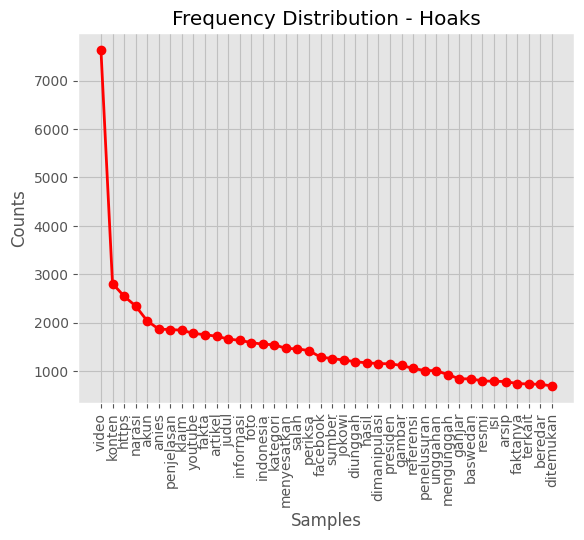

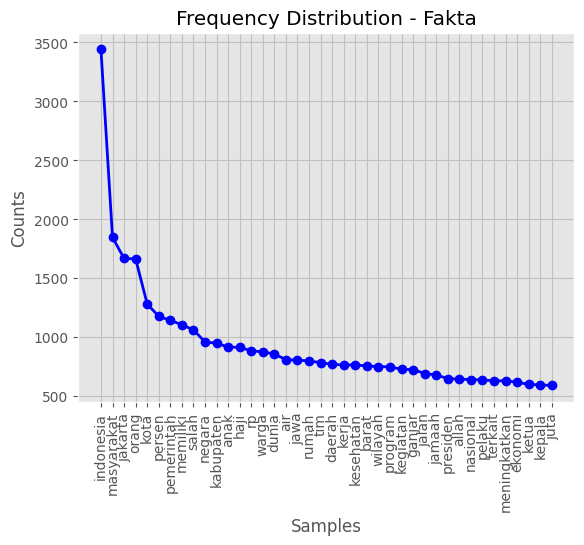

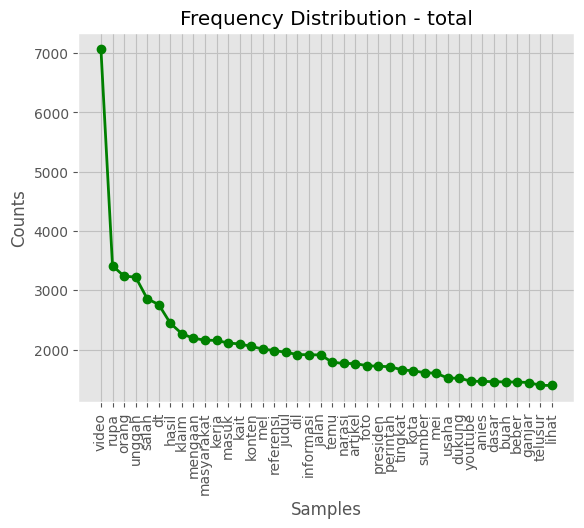

In [ ]:
# Plot Hoaks
freq_dist_hoaks.plot(40, cumulative=False, title='Frequency Distribution - Hoaks', color='red', marker='o')
plt.show()


# Plot Fakta
freq_dist_fakta.plot(40, cumulative=False, title='Frequency Distribution - Fakta', color='blue', marker='o')
plt.show()


# Plot total
freq_dist_total.plot(40, cumulative=False, title='Frequency Distribution - total', color='green', marker='o')
plt.show()

### TF-IDF Check

Iteration: 0, Max Features: 2000, Sparsity: 0.9553
Iteration: 1, Max Features: 2300, Sparsity: 0.9602
Iteration: 2, Max Features: 2600, Sparsity: 0.9641
Iteration: 3, Max Features: 2900, Sparsity: 0.9673
Iteration: 4, Max Features: 3200, Sparsity: 0.9699
Iteration: 5, Max Features: 3500, Sparsity: 0.9722
Iteration: 6, Max Features: 3800, Sparsity: 0.9741
Iteration: 7, Max Features: 4100, Sparsity: 0.9758
Iteration: 8, Max Features: 4400, Sparsity: 0.9773
Iteration: 9, Max Features: 4700, Sparsity: 0.9786
Iteration: 10, Max Features: 5000, Sparsity: 0.9798
Iteration: 11, Max Features: 5300, Sparsity: 0.9808
Iteration: 12, Max Features: 5600, Sparsity: 0.9817
Iteration: 13, Max Features: 5900, Sparsity: 0.9826
Iteration: 14, Max Features: 6200, Sparsity: 0.9833
Iteration: 15, Max Features: 6500, Sparsity: 0.9840
Iteration: 16, Max Features: 6800, Sparsity: 0.9847
Iteration: 17, Max Features: 7100, Sparsity: 0.9853
Iteration: 18, Max Features: 7400, Sparsity: 0.9858
Iteration: 19, Max Fea

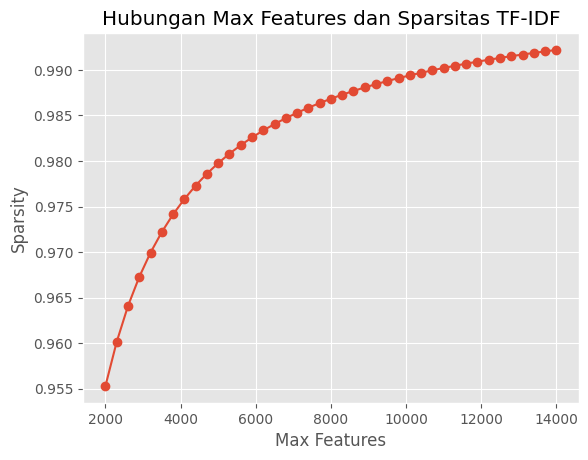

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd
import matplotlib.pyplot as plt

# Misal df_fakta adalah DataFrame yang berisi teks fakta
# Ganti 'text_bersih' dengan kolom yang sesuai pada DataFrame Anda
documents = df['text_bersih'].tolist()

# Inisialisasi nilai awal max_features
max_features = 2000

# Inisialisasi list untuk menyimpan sparsitas, max_features, dan iterasi
sparsity_list = []
max_features_list = []
iteration_list = []

# Loop sampai sparsitas mencapai 100%
iteration = 0
while max_features <= len(set(' '.join(documents).split())):
    # Inisialisasi TF-IDF Vectorizer dengan max_features yang diuji
    tfidf_vectorizer = TfidfVectorizer(max_features=max_features)

    # Fit dan transform teks menggunakan TF-IDF Vectorizer
    tfidf_matrix = tfidf_vectorizer.fit_transform(documents)

    # Hitung sparsitas matriks TF-IDF
    sparsity = 1.0 - tfidf_matrix.nnz / (tfidf_matrix.shape[0] * tfidf_matrix.shape[1])

    # Tampilkan nilai sparsitas
    print(f"Iteration: {iteration}, Max Features: {max_features}, Sparsity: {sparsity:.4f}")

    # Simpan hasil
    sparsity_list.append(sparsity)
    max_features_list.append(max_features)
    iteration_list.append(iteration)

    # Cek kondisi untuk break
    if sparsity >= 1 or iteration == 40:
        break

    # Tingkatkan nilai max_features
    max_features += 300
    iteration += 1

# Plot grafik
plt.plot(max_features_list, sparsity_list, marker='o')
plt.title('Hubungan Max Features dan Sparsitas TF-IDF')
plt.xlabel('Max Features')
plt.ylabel('Sparsity')
plt.show()


### Spliting Data Teks

Data training dan testing menyesuaikan dengan data training dan testing gambar yang terpilih

In [ ]:
# Menghapus ekstensi file dari daftar nama file training
train_img_files = [os.path.splitext(os.path.basename(filepath))[0] for filepath in train_gen.filenames]

# Menghapus ekstensi file dari daftar nama file validasi
test_img_files = [os.path.splitext(os.path.basename(filepath))[0] for filepath in val_gen.filenames]

# Menghapus ekstensi file dan hanya menyisakan nomor setelah tanda "_"
train_img_files = [re.search(r'_(\d+)', os.path.splitext(os.path.basename(filepath))[0]).group(1) for filepath in train_gen.filenames]
test_img_files = [re.search(r'_(\d+)', os.path.splitext(os.path.basename(filepath))[0]).group(1) for filepath in val_gen.filenames]

# # Menampilkan daftar file training
# print("File Training:")
# for filename in train_img_files:
#     print(filename)


# # Menampilkan daftar file validasi
# print("\nFile Validasi:")
# for filename in test_img_files:
#     print(filename)

In [ ]:
train_indices = [int(idx) for idx in train_img_files]
test_indices = [int(idx) for idx in test_img_files]

df_terpilih_train = df[df.index.isin(train_indices)]
df_terpilih_test = df[df.index.isin(test_indices)]

df_terpilih_train = df_terpilih_train[['title','text_bersih']]
df_terpilih_test = df_terpilih_test[['title','text_bersih']]

df_terpilih_train['index_terpilih'] = df_terpilih_train.index
df_terpilih_test['index_terpilih'] = df_terpilih_test.index


In [ ]:
# Gabungkan
train_df = df_gen_train.merge(df_terpilih_train, on='index_terpilih')
test_df = df_gen_val.merge(df_terpilih_test, on='index_terpilih')

### Feature Vectorization

In [ ]:
# Tetapkan seed untuk mengunci randomisasi
np.random.seed(123)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
max_features = 8900
train_tfidf_vectorizer = TfidfVectorizer(max_features=max_features)  # Sesuaikan jumlah fitur TF-IDF sesuai kebutuhan
train_tfidf_matrix = train_tfidf_vectorizer.fit_transform(train_df['text_bersih'])

# train_tfidf_array = train_tfidf_matrix.toarray()
# print (train_tfidf_array)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
max_features = 8900
test_tfidf_vectorizer = TfidfVectorizer(max_features=max_features)  # Sesuaikan jumlah fitur TF-IDF sesuai kebutuhan
test_tfidf_matrix = test_tfidf_vectorizer.fit_transform(test_df['text_bersih'])

# test_tfidf_array = test_tfidf_matrix.toarray()
# print (test_tfidf_array)

In [ ]:
# Label encoding untuk label
label_encoder = LabelEncoder()

X_train = train_tfidf_matrix
y_train = label_encoder.fit_transform(train_df['label'])

X_test = test_tfidf_matrix
y_test = label_encoder.fit_transform(test_df['label'])

In [ ]:
# Array dari X_train, X_test, y_train, dan y_test
X_train_np = X_train.toarray()
X_test_np = X_test.toarray()



In [ ]:
X_train_reshaped = X_train_np.reshape(X_train_np.shape[0], X_train_np.shape[1], 1)
X_test_reshaped = X_test_np.reshape(X_test_np.shape[0], X_test_np.shape[1], 1)

In [ ]:
# Input untuk data teks
max_sequence_length = X_train_reshaped.shape[1]  # Sesuaikan dengan panjang maksimum urutan teks
embedding_dim = X_train_reshaped.shape[2]  # Sesuaikan dengan dimensi embedding


In [ ]:
print("Bentuk train_tfidf_vectorizer:", train_tfidf_vectorizer.transform(train_df['text_bersih']).shape)
print("Bentuk test_tfidf_vectorizer:", test_tfidf_vectorizer.transform(test_df['text_bersih']).shape)
print("Bentuk X_train:", X_train.shape)
print("Bentuk X_test:", X_test.shape)
print("Bentuk X_train_np:", X_train_np.shape)
print("Bentuk X_test_np:", X_test_np.shape)
print("Bentuk X_train_reshaped:", X_train_reshaped.shape)
print("Bentuk X_test_reshaped:", X_test_reshaped.shape)
print("Bentuk y_train:", y_train.shape)
print("Bentuk y_test:", y_test.shape)


Bentuk train_tfidf_vectorizer: (3103, 8900)
Bentuk test_tfidf_vectorizer: (775, 8900)
Bentuk X_train: (3103, 8900)
Bentuk X_test: (775, 8900)
Bentuk X_train_np: (3103, 8900)
Bentuk X_test_np: (775, 8900)
Bentuk X_train_reshaped: (3103, 8900, 1)
Bentuk X_test_reshaped: (775, 8900, 1)
Bentuk y_train: (3103,)
Bentuk y_test: (775,)


# Membangun Model ML untuk Text Classification

In [ ]:
# libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline
import seaborn as sns
import scipy.stats as stats
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import train_test_split

from sklearn import svm
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix

In [ ]:
scores = []

In [ ]:
model_params = {
    'svm': {
        'model': svm.SVC(random_state=789, probability=True),
        'params' : {
        }
    },
    'logistic_regression' : {
        'model': LogisticRegression(),
        'params': {
        }
    }
}

## Training

svm
SVC(probability=True, random_state=789)


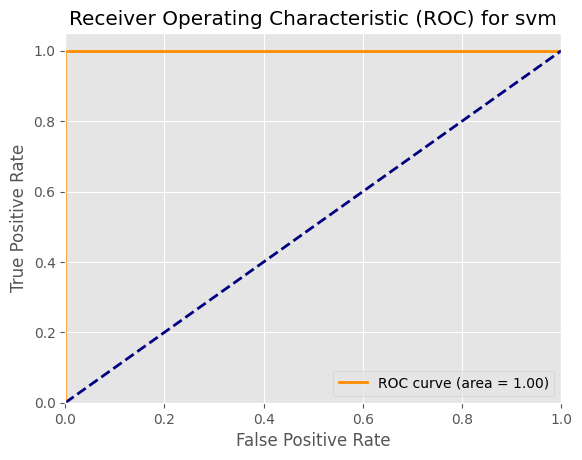

AUC for svm : 1.0
Accuracy: 1.0
Confusion Matrix:
[[1713    0]
 [   0 1390]]
logistic_regression
LogisticRegression()


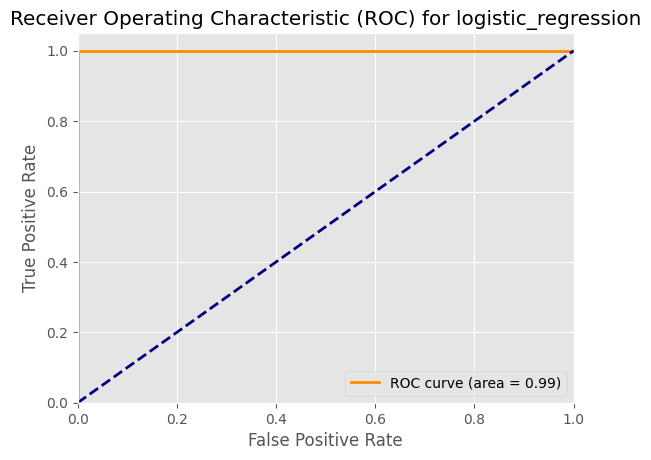

AUC for logistic_regression : 0.9928735820450469
Accuracy: 0.9935546245568805
Confusion Matrix:
[[1712    1]
 [  19 1371]]


,model,best_score,best_params,scaller,Confusion_Matrix,ROC_AUC
0,svm,1.000000,default,TF-IDF,"[[1713, 0], [0, 1390]]",1.000000
1,logistic_regression,0.993555,default,TF-IDF,"[[1712, 1], [19, 1371]]",0.992874


In [ ]:
for model_name, mp in model_params.items():
    seed = 789
    clf = mp['model']
    print(model_name)
    print(clf)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_train)

    # Menghitung ROC dan AUC
    fpr, tpr, thresholds = roc_curve(y_train, clf.predict_proba(X_train)[:,1])
    roc_auc = roc_auc_score(y_train, clf.predict(X_train))

    # Menampilkan ROC dan AUC
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) for ' + model_name)
    plt.legend(loc="lower right")
    plt.show()

    # Menampilkan AUC
    print("AUC for", model_name, ":", roc_auc)

    accuracy = accuracy_score(y_train, y_pred)
    cm = confusion_matrix(y_train, y_pred)
    print("Accuracy:", accuracy)
    print("Confusion Matrix:")
    print(cm)

    scores.append({
        'model': model_name,
        'best_score': accuracy,
        'best_params': "default",
        'scaller': 'TF-IDF',
        'Confusion_Matrix': cm,
        'ROC_AUC': roc_auc  # Tambahkan AUC ke dataframe
    })

result = pd.DataFrame(scores,columns=['model','best_score','best_params', 'scaller', 'Confusion_Matrix', 'ROC_AUC'])
result

## Testing

svm
SVC(probability=True, random_state=789)


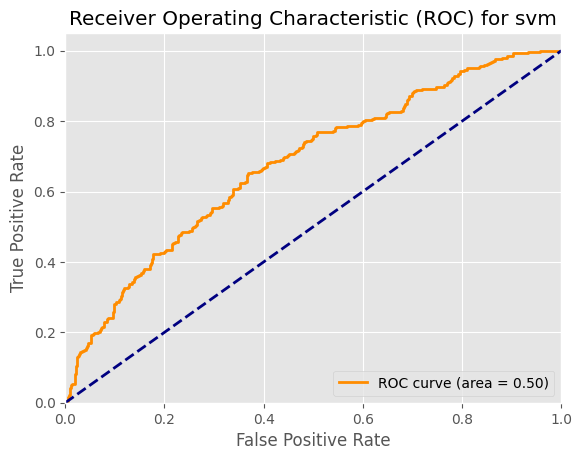

AUC for svm : 0.5005453957822726
Accuracy: 0.552258064516129
Confusion Matrix:
[[426   2]
 [345   2]]
logistic_regression
LogisticRegression()


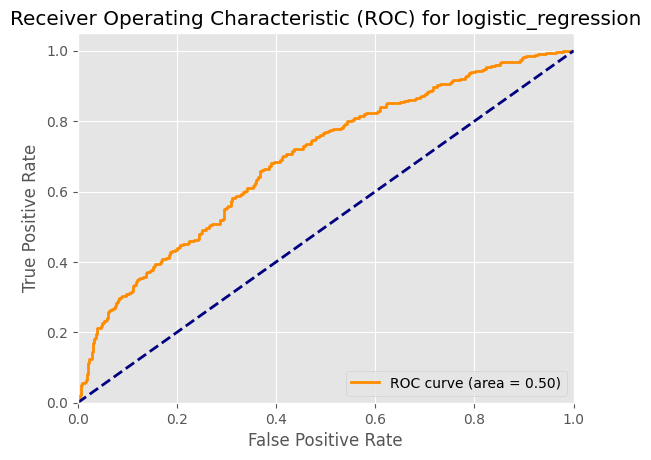

AUC for logistic_regression : 0.5028818443804035
Accuracy: 0.5548387096774193
Confusion Matrix:
[[428   0]
 [345   2]]


,model,best_score,best_params,scaller,Confusion_Matrix,ROC_AUC
0,svm,1.000000,default,TF-IDF,"[[1713, 0], [0, 1390]]",1.000000
1,logistic_regression,0.993555,default,TF-IDF,"[[1712, 1], [19, 1371]]",0.992874
2,svm,0.552258,default,TF-IDF,"[[426, 2], [345, 2]]",0.500545
3,logistic_regression,0.554839,default,TF-IDF,"[[428, 0], [345, 2]]",0.502882


In [ ]:
for model_name, mp in model_params.items():
    seed = 789
    clf = mp['model']
    print(model_name)
    print(clf)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    # Menghitung ROC dan AUC
    fpr, tpr, thresholds = roc_curve(y_test, clf.predict_proba(X_test)[:,1])
    roc_auc = roc_auc_score(y_test, clf.predict(X_test))

    # Menampilkan ROC dan AUC
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) for ' + model_name)
    plt.legend(loc="lower right")
    plt.show()

    # Menampilkan AUC
    print("AUC for", model_name, ":", roc_auc)

    accuracy = accuracy_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    print("Accuracy:", accuracy)
    print("Confusion Matrix:")
    print(cm)

    scores.append({
        'model': model_name,
        'best_score': accuracy,
        'best_params': "default",
        'scaller': 'TF-IDF',
        'Confusion_Matrix': cm,
        'ROC_AUC': roc_auc  # Tambahkan AUC ke dataframe
    })

result = pd.DataFrame(scores,columns=['model','best_score','best_params', 'scaller', 'Confusion_Matrix', 'ROC_AUC'])
result

# Membangun Model CNN

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import concatenate
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import load_model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Sequential
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
from tensorflow.keras.layers import BatchNormalization

import pickle
import matplotlib.pyplot as plt

In [ ]:
# Seeding untuk TensorFlow
tf.random.set_seed(123)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

# Mendefinisikan EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_accuracy',  # Memantau val_loss atau val_accuracy untuk early stopping
                               patience=20,          # Jumlah epoch tanpa perbaikan sebelum berhenti
                               restore_best_weights=True,  # Mengembalikan bobot terbaik pada model
                               verbose=1)           # Menampilkan pesan jika terjadi early stopping




In [ ]:
# class LossAccHistory(tf.keras.callbacks.Callback):
#     def __init__(self, file_path):
#         self.history = {'loss': [], 'accuracy': [], 'val_loss': [], 'val_accuracy': []}
#         self.file_path = file_path

#     def on_epoch_end(self, epoch, logs=None):
#         self.history['loss'].append(logs['loss'])
#         self.history['accuracy'].append(logs['accuracy'])
#         self.history['val_loss'].append(logs['val_loss'])
#         self.history['val_accuracy'].append(logs['val_accuracy'])

#         print(f'Epoch {epoch + 1}, Loss: {logs["loss"]}, Accuracy: {logs["accuracy"]}, Val Loss: {logs["val_loss"]}, Val Accuracy: {logs["val_accuracy"]}')

#         # Simpan history ke dalam file menggunakan pickle
#         with open(self.file_path, 'wb') as file:
#             pickle.dump(self.history, file)

In [ ]:
# true Positif (tp)
# True Negatif (tn)
# False positif (fp)
# False Negatif (fn)
class LossAccHistory(tf.keras.callbacks.Callback):
    def __init__(self, file_path):
        self.history = {
            'loss': [], 'accuracy': [],
            'val_loss': [], 'val_accuracy': [],
            'tp': [], 'tn': [],
            'fp': [], 'fn': [],
            'val_tp': [], 'val_tn': [],
            'val_fp': [], 'val_fn': [], 'auc':[], 'val_auc':[]

        }
        self.file_path = file_path

    def on_epoch_end(self, epoch, logs=None, validation_data=None):
        # ...

        # Update the history dictionary
        self.history['loss'].append(logs['loss'])
        self.history['accuracy'].append(logs['accuracy'])
        self.history['val_loss'].append(logs['val_loss'])
        self.history['val_accuracy'].append(logs['val_accuracy'])
        self.history['tp'].append(logs['true_positives'])
        self.history['tn'].append(logs['true_negatives'])
        self.history['fp'].append(logs['false_positives'])
        self.history['fn'].append(logs['false_negatives'])
        self.history['val_tp'].append(logs['val_true_positives'])
        self.history['val_tn'].append(logs['val_true_negatives'])
        self.history['val_fp'].append(logs['val_false_positives'])
        self.history['val_fn'].append(logs['val_false_negatives'])
        self.history['auc'].append(logs['auc'])
        self.history['val_auc'].append(logs['val_auc'])
        # ...
        # Simpan history ke dalam file menggunakan pickle
        with open(self.file_path, 'wb') as file:
            pickle.dump(self.history, file)


## Model Convolusi 2D

In [ ]:
# Load the VGG16 model with pretrained weights (include_top=False means excluding the fully connected layers)
pretrained_vgg = VGG16(include_top=False, weights='imagenet', input_shape=(width, height, 3))

# Freeze the layers of the pretrained model so they are not trained again
for layer in pretrained_vgg.layers:
    layer.trainable = False

58889256/58889256 [==============================] - 0s 0us/step


#### Menyusun Model Conv2D

In [ ]:
# Model Conv2D
model_conv2d = tf.keras.models.Sequential([
                                    pretrained_vgg,
                                    tf.keras.layers.Flatten(),
                                    tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=l2(0.05))
])

In [ ]:
# Output dari Convolusi2D
output_conv2d = model_conv2d.output

In [ ]:
# Lapisan-lapisan Dense
x = tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=l2(0.05))(output_conv2d)


In [ ]:
output = tf.keras.layers.Dense(1, activation='sigmoid',
                               name='output')(x)

In [ ]:
# Buat model2D
model2d = tf.keras.Model(inputs= model_conv2d.input,
                         outputs=output)


In [ ]:
# Compile model
model2d.compile(loss='binary_crossentropy',
                      optimizer='adam',
                      metrics=['accuracy',
                       tf.keras.metrics.TrueNegatives(name='true_negatives'),
                       tf.keras.metrics.TruePositives(name='true_positives'),
                       tf.keras.metrics.FalsePositives(name='false_positives'),
                       tf.keras.metrics.FalseNegatives(name='false_negatives'),
                       tf.keras.metrics.AUC(name='auc')
                      ])

In [ ]:
# Membuat instance dari LossAccHistory dengan menyimpan history ke dalam file 'history2D.pkl'
loss_acc_history_2D = LossAccHistory(file_path='history2D_uji3.pkl')

#### Melatih Model Conv2D

In [ ]:
# Train model
model2d.fit(X_train_images_np, y_train, epochs=100, batch_size=32, validation_data=(X_test_images_np, y_test), callbacks=[loss_acc_history_2D, early_stopping])

Epoch 1/100
97/97 [==============================] - 21s 198ms/step - loss: 12.0924 - accuracy: 0.9285 - true_negatives: 1609.0000 - true_positives: 1272.0000 - false_positives: 104.0000 - false_negatives: 118.0000 - auc: 0.9648 - val_loss: 2.0083 - val_accuracy: 0.9716 - val_true_negatives: 413.0000 - val_true_positives: 340.0000 - val_false_positives: 15.0000 - val_false_negatives: 7.0000 - val_auc: 0.9962
Epoch 2/100
97/97 [==============================] - 16s 161ms/step - loss: 1.2233 - accuracy: 0.9571 - true_negatives: 1652.0000 - true_positives: 1318.0000 - false_positives: 61.0000 - false_negatives: 72.0000 - auc: 0.9920 - val_loss: 0.7199 - val_accuracy: 0.9613 - val_true_negatives: 423.0000 - val_true_positives: 322.0000 - val_false_positives: 5.0000 - val_false_negatives: 25.0000 - val_auc: 0.9960
Epoch 3/100
97/97 [==============================] - 18s 187ms/step - loss: 0.5288 - accuracy: 0.9649 - true_negatives: 1664.0000 - true_positives: 1330.0000 - false_positives: 49

#### Save Model 2D

In [ ]:
# Simpan seluruh model ke dalam file H5 setelah pelatihan
model2d.save('model2d_uji3.h5')

#### Grafik LOSS & ACC

In [ ]:
# Plot training and validation loss
plt.plot(range(1, len(loss_acc_history.history['loss']) + 1), loss_acc_history.history['loss'], label='Training Loss')
plt.plot(range(1, len(loss_acc_history.history['val_loss']) + 1), loss_acc_history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot training and validation accuracy
plt.plot(range(1, len(loss_acc_history.history['accuracy']) + 1), loss_acc_history.history['accuracy'], label='Training Accuracy')
plt.plot(range(1, len(loss_acc_history.history['val_accuracy']) + 1), loss_acc_history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

AttributeError: ignored

#### Output Layer

In [ ]:
pretrained_vgg.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
loaded_model2d.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16_input (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 512)               12845568  
                                                                 
 dense_1 (Dense)             (None, 512)               262656    
                                                                 
 output (Dense)              (None, 1)                 513       
                                                                 
Total params: 27823425 (106.14 MB)
Trainable params: 0 (0.00 

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from tensorflow.keras.models import Model

# # Function to visualize layer outputs
# def visualize_layer_outputs(model, img, layer_index, figsize=(6, 6)):
#     # Create a model that outputs the activations of the selected layer
#     layer_outputs = [layer.output for layer in model.layers]
#     activation_model = Model(inputs=model.input, outputs=layer_outputs)

#     # Get activations for the input image
#     activations = activation_model.predict(np.expand_dims(img, axis=0))

#     # Number of filters in the selected layer
#     num_filters = activations[layer_index].shape[-1]

#     # Calculate the number of rows and columns in the subplot grid
#     rows = int(np.ceil(np.sqrt(num_filters)))
#     cols = int(np.ceil(num_filters / rows))

#     # Create a subplot grid
#     fig, axes = plt.subplots(rows, cols, figsize=figsize)

#     # Loop through filters and plot the corresponding activation
#     for i in range(num_filters):
#         row = i // cols
#         col = i % cols
#         ax = axes[row, col] if num_filters > 1 else axes

#         # Extract the activation for the i-th filter
#         activation = activations[layer_index][0, :, :, i]

#         # Plot the activation
#         ax.imshow(activation, cmap='viridis')  # Adjust the colormap as needed
#         ax.axis('off')

#         # Add a title with the layer name and filter index
#         ax.set_title(f'Layer {layer_index}, Filter {i}')

#     plt.tight_layout()
#     plt.show()

# # Choose an image from your dataset
# sample_image = X_train_images_np[0]

# # Visualize activations for each layer (adjust layer_indices as needed)
# layer_indices = range(1, 19)  # Assuming there are 18 layers in your model
# for layer_index in layer_indices:
#     visualize_layer_outputs(pretrained_vgg, sample_image, layer_index)


1/1 [==============================] - 0s 494ms/step


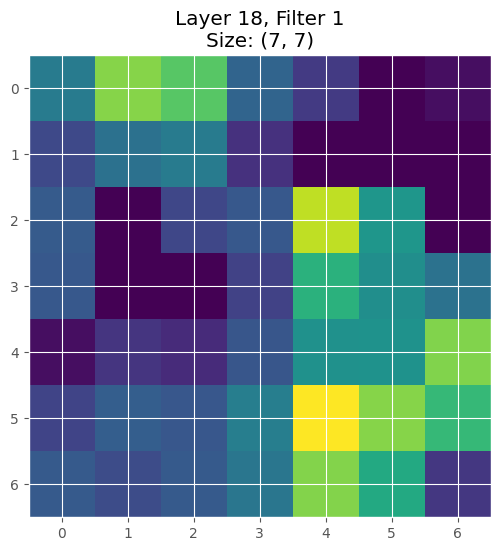

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Function to visualize layer outputs
def visualize_layer_outputs(model, img, layer_index, filter_index, figsize=(6, 6)):
    # Create a model that outputs the activations of the selected layer
    layer_outputs = [layer.output for layer in model.layers]
    activation_model = Model(inputs=model.input, outputs=layer_outputs)

    # Get activations for the input image
    activations = activation_model.predict(np.expand_dims(img, axis=0))

    # Extract the activation for the specified layer and filter
    activation = activations[layer_index][0, :, :, filter_index]

    # # Display the original image
    # plt.imshow(img)
    # plt.title('Original Image')
    # plt.show()

    # Display the activation for the selected layer and filter
    plt.figure(figsize=figsize)
    plt.imshow(activation, cmap='viridis')  # Adjust the colormap as needed
    plt.title(f'Layer {layer_index}, Filter {filter_index + 1}\nSize: {activation.shape}')
    plt.show()

# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 18  # Change to the desired layer index
filter_index_to_display = 0  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


1/1 [==============================] - 0s 451ms/step


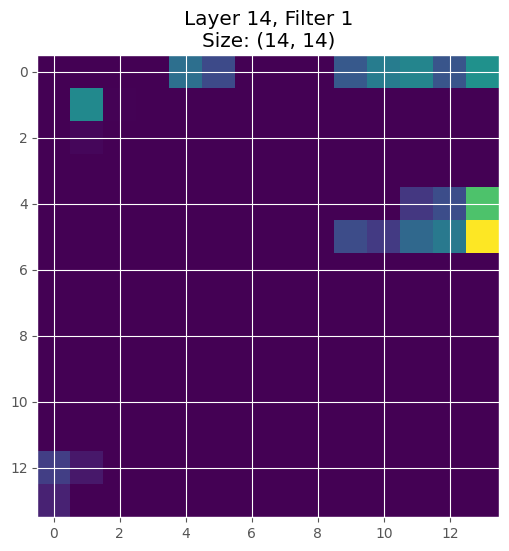

In [ ]:
# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 14  # Change to the desired layer index
filter_index_to_display = 0  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


1/1 [==============================] - 0s 270ms/step


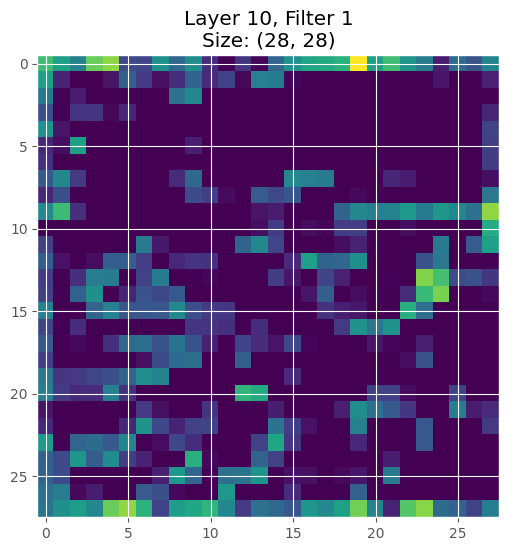

In [ ]:
# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 10  # Change to the desired layer index
filter_index_to_display = 0  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


1/1 [==============================] - 0s 496ms/step


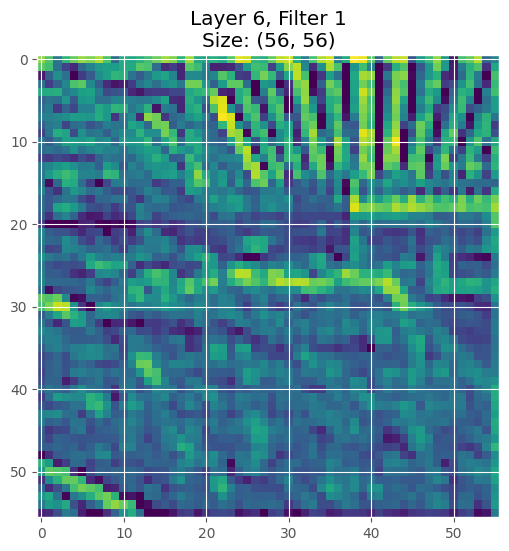

In [ ]:
# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 6  # Change to the desired layer index
filter_index_to_display = 0  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


1/1 [==============================] - 1s 515ms/step


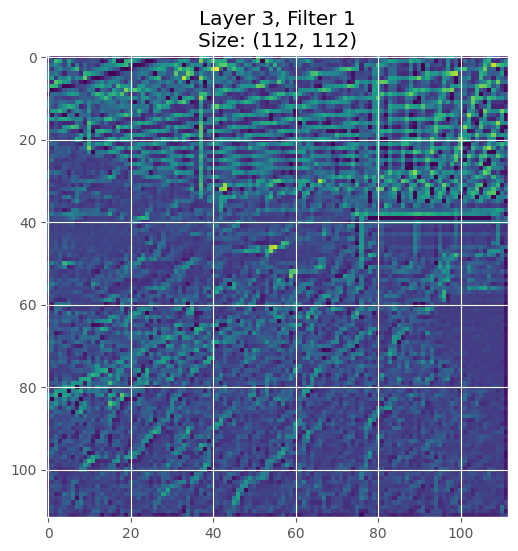

In [ ]:
# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 3  # Change to the desired layer index
filter_index_to_display = 0  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


1/1 [==============================] - 0s 358ms/step


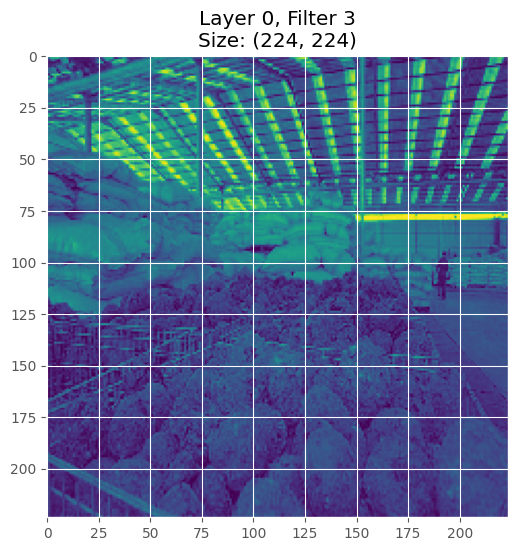

In [ ]:
# Choose an image from your dataset
sample_image = X_train_images_np[0]

# Specify the layer and filter you want to visualize
layer_to_visualize = 0  # Change to the desired layer index
filter_index_to_display = 2  # Change to the desired filter index

# Visualize the selected layer and filter
visualize_layer_outputs(pretrained_vgg, sample_image, layer_to_visualize, filter_index_to_display)


In [ ]:
def visualize_layer_output(model, input_data, layer_num, filter_num, data_idx):
    # Mendapatkan output dari layer yang diinginkan
    layer_output = model.layers[layer_num].output

    # Membuat model yang mengembalikan output dari layer tersebut
    visualization_model = tf.keras.models.Model(inputs=model.input, outputs=layer_output)

    # Mendapatkan output untuk suatu input data
    activations = visualization_model.predict(input_data)

    # Jika layer adalah Flatten layer atau Dense layer, gunakan numpy.ravel() untuk meratakan aktivasi
    if isinstance(layer_output, (tf.keras.layers.Flatten, tf.keras.layers.Dense)):
      filter_output = np.ravel(activations[data_idx])
    # else:
    # # Untuk layer lainnya, pilih indeks data dan filter yang diinginkan
    #   filter_output = activations[data_idx, :, filter_num]

    # Menampilkan output
    print(f'Output dari Layer {layer_num}, Filter {filter_num}, Data Index {data_idx}:\n{filter_output}')

# Contoh penggunaan
visualize_layer_output(loaded_model2d, X_train_images_np, layer_num=5, filter_num=1, data_idx=0)

<KerasTensor: shape=(None, 512) dtype=float32 (created by layer 'dense_1')>

## Model Convolusi 1D



```
`# This is formatted as code`
```

#### Menyusun Model Conv1D

In [ ]:
# model_conv1d = tf.keras.models.Sequential([
#     tf.keras.layers.Conv1D(64, 3, 2,activation='relu', input_shape=(max_sequence_length, embedding_dim)),
#     tf.keras.layers.Conv1D(64, 3, 2,activation='relu'),
#     tf.keras.layers.MaxPooling1D(2, 2),

#     tf.keras.layers.Conv1D(128, 3, 2,activation='relu'),
#     tf.keras.layers.Conv1D(128, 3, 2,activation='relu'),
#     tf.keras.layers.MaxPooling1D(2, 2),

#     tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     tf.keras.layers.MaxPooling1D(2, 2),

#     # tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     # tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     # tf.keras.layers.Conv1D(512, 3, 2,activation='relu'),
#     # # tf.keras.layers.MaxPooling1D(2, 2),

#     tf.keras.layers.Flatten(),
#     tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=l2(0.05))
# ])

In [ ]:
model_conv1d = tf.keras.models.Sequential([
    tf.keras.layers.Conv1D(128, 5, activation='relu', input_shape=(max_sequence_length, embedding_dim)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(128, 5, activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.GlobalMaxPooling1D(),

    # tf.keras.layers.Conv1D(128, 5, activation='relu'),
    # tf.keras.layers.BatchNormalization(),
    # tf.keras.layers.Conv1D(128, 5, activation='relu'),
    # tf.keras.layers.BatchNormalization(),
    # tf.keras.layers.GlobalMaxPooling1D(),

    # tf.keras.layers.Conv1D(512, 5, activation='relu'),
    # tf.keras.layers.BatchNormalization(),
    # tf.keras.layers.Conv1D(512, 5, activation='relu'),
    # tf.keras.layers.BatchNormalization(),
    # tf.keras.layers.Conv1D(512, 5, activation='relu'),
    # tf.keras.layers.BatchNormalization(),
    # tf.keras.layers.GlobalMaxPooling1D(),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu')
])


In [ ]:
# Output dari Convolusi1D
output_conv1d = model_conv1d.output

In [ ]:
# Lapisan-lapisan Dense
x = tf.keras.layers.Dense(512, activation='relu')(output_conv1d)
x = tf.keras.layers.BatchNormalization()(x)
x =  tf.keras.layers.ReLU()(x)
# x = tf.keras.layers.Dense(128, activation='relu')(x)
# x = tf.keras.layers.Dense(512, activation='relu')(x)

In [ ]:
output = tf.keras.layers.Dense(1, activation='sigmoid',
                               name='output')(x)

In [ ]:
# Buat model2D
model1d = tf.keras.Model(inputs= model_conv1d.input,
                         outputs=output)


In [ ]:
# Compile model
model1d.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy',
                       tf.keras.metrics.TrueNegatives(name='true_negatives'),
                       tf.keras.metrics.TruePositives(name='true_positives'),
                       tf.keras.metrics.FalsePositives(name='false_positives'),
                       tf.keras.metrics.FalseNegatives(name='false_negatives'),
                       tf.keras.metrics.AUC(name='auc')
                      ])

In [ ]:
# Objek callback untuk model pertama
loss_acc_history_1D = LossAccHistory(file_path='history1D_uji3.pkl')


#### Melatih Model Conv1D

In [ ]:
# Train model
model1d.fit(X_train_reshaped, y_train, epochs=100, batch_size=32, validation_data=(X_test_reshaped, y_test), callbacks=[loss_acc_history_1D, early_stopping])

Epoch 1/100
 6/97 [>.............................] - ETA: 10s - loss: 0.7298 - accuracy: 0.4948 - true_negatives: 60.0000 - true_positives: 35.0000 - false_positives: 42.0000 - false_negatives: 55.0000 - auc: 0.4812

97/97 [==============================] - 16s 128ms/step - loss: 0.6869 - accuracy: 0.5488 - true_negatives: 1491.0000 - true_positives: 212.0000 - false_positives: 222.0000 - false_negatives: 1178.0000 - auc: 0.5494 - val_loss: 0.6916 - val_accuracy: 0.5523 - val_true_negatives: 428.0000 - val_true_positives: 0.0000e+00 - val_false_positives: 0.0000e+00 - val_false_negatives: 347.0000 - val_auc: 0.4999
Epoch 2/100
97/97 [==============================] - 12s 122ms/step - loss: 0.6672 - accuracy: 0.5952 - true_negatives: 1565.0000 - true_positives: 282.0000 - false_positives: 148.0000 - false_negatives: 1108.0000 - auc: 0.6229 - val_loss: 0.6916 - val_accuracy: 0.5523 - val_true_negatives: 428.0000 - val_true_positives: 0.0000e+00 - val_false_positives: 0.0000e+00 - val_false_negatives: 347.0000 - val_auc: 0.4953
Epoch 3/100
97/97 [==============================] - 11s 117ms/step - loss: 0.6356 - accuracy: 0.6262 - true_negatives: 1544.0000 - true_positives: 399.0000 - false_positives: 

#### Save Model 1D

In [ ]:
# Simpan seluruh model ke dalam file H5 setelah pelatihan
model1d.save('model1d_uji3.h5')

In [ ]:
# Fungsi untuk membaca file pickle
def load_pickle_file(file_path):
    with open(file_path, 'rb') as file:
        data = pickle.load(file)
    return data

In [ ]:
loss_acc_history_1D = load_pickle_file('/content/history1D_baru.pkl')

#### Grafik LOSS & ACC

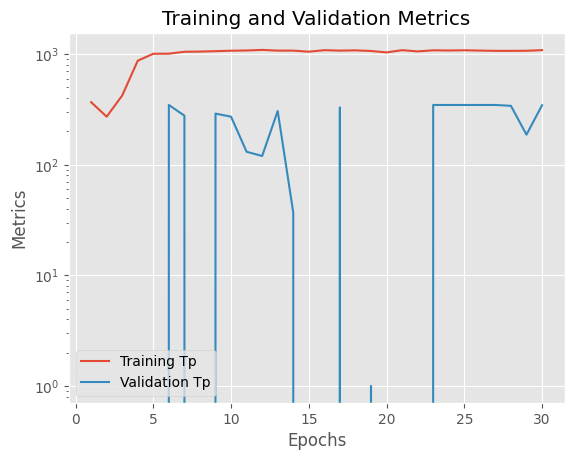

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_metrics(history, metrics=['loss', 'accuracy', 'tp', 'tn', 'fp', 'fn', 'auc'], log_scale=False):
    for metric in metrics:
        plt.plot(range(1, len(history[metric]) + 1), history[metric], label=f'Training {metric.capitalize()}')
        val_metric = f'val_{metric}'
        if val_metric in history:
            plt.plot(range(1, len(history[val_metric]) + 1), history[val_metric], label=f'Validation {metric.capitalize()}')

    plt.title('Training and Validation Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    if log_scale:
        plt.yscale('log')
    plt.legend()
    plt.show()

# Example usage:
plot_metrics(loss_acc_history_1D.history, metrics=['tp'], log_scale=True)


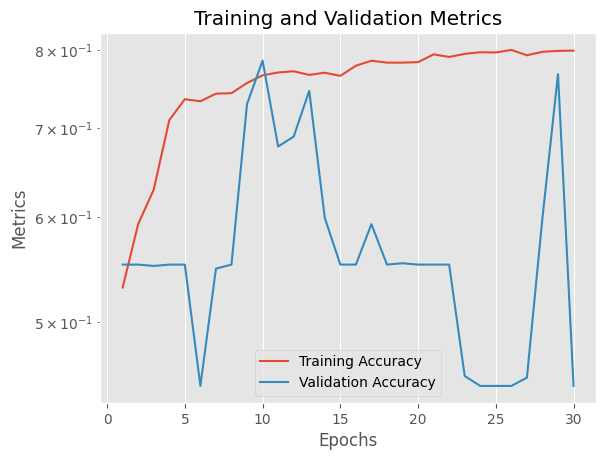

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_metrics(history, metrics=['loss', 'accuracy'], log_scale=False):
    """
    Plot training and validation metrics over epochs.

    Parameters:
        history (dict): Dictionary containing training and validation metrics.
        metrics (list): List of metrics to plot (e.g., ['loss', 'accuracy']).
        log_scale (bool): Whether to use a logarithmic scale for the y-axis.

    Returns:
        None
    """
    for metric in metrics:
        plt.plot(range(1, len(history[metric]) + 1), history[metric], label=f'Training {metric.capitalize()}')
        val_metric = f'val_{metric}'
        if val_metric in history:
            plt.plot(range(1, len(history[val_metric]) + 1), history[val_metric], label=f'Validation {metric.capitalize()}')
        else:
            print(f'Warning: {val_metric} not found in history.')

    plt.title('Training and Validation Metrics')
    plt.xlabel('Epochs')
    plt.ylabel('Metrics')
    if log_scale:
        plt.yscale('log')
    plt.legend()
    plt.show()

# Example usage:
plot_metrics(loss_acc_history_1D.history, metrics=['accuracy'], log_scale=True)


In [ ]:
print(loss_acc_history_1D.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy', 'tp', 'tn', 'fp', 'fn', 'val_tp', 'val_tn', 'val_fp', 'val_fn', 'auc', 'val_auc'])


In [ ]:
print("Validation Loss:", loss_acc_history_1D.history['val_f1_score'])
print("Validation Accuracy:", loss_acc_history_1D.history['val_accuracy'])


Validation Loss: []
Validation Accuracy: []


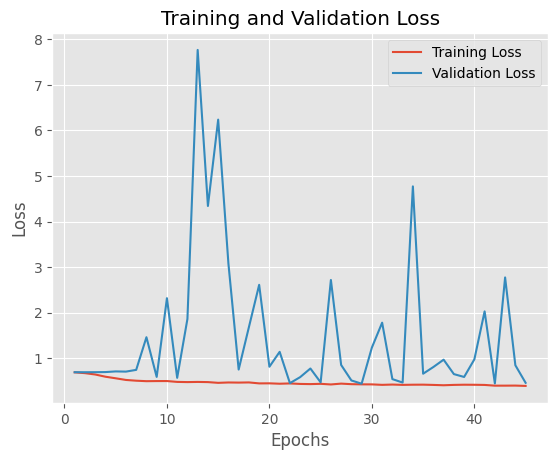

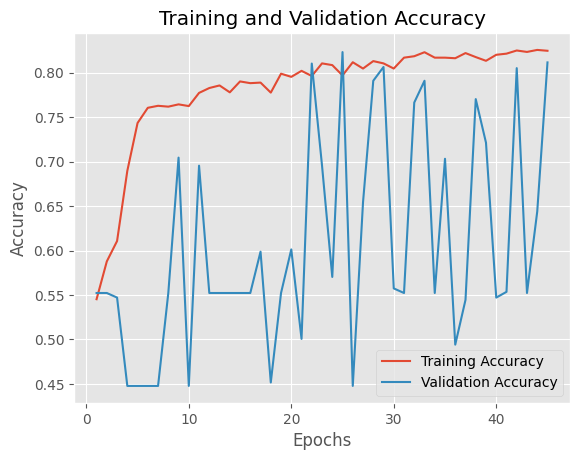

In [ ]:
# Plot training and validation loss
plt.plot(range(1, len(loss_acc_history_1D.history['loss']) + 1), loss_acc_history_1D.history['loss'], label='Training Loss')
plt.plot(range(1, len(loss_acc_history_1D.history['val_loss']) + 1), loss_acc_history_1D.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot training and validation accuracy
plt.plot(range(1, len(loss_acc_history_1D.history['accuracy']) + 1), loss_acc_history_1D.history['accuracy'], label='Training Accuracy')
plt.plot(range(1, len(loss_acc_history_1D.history['val_accuracy']) + 1), loss_acc_history_1D.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

#### Output Layer

In [ ]:
model1d.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4_input (InputLayer  [(None, 8900, 1)]         0         
 )                                                               
                                                                 
 conv1d_4 (Conv1D)           (None, 8896, 128)         768       
                                                                 
 batch_normalization_7 (Bat  (None, 8896, 128)         512       
 chNormalization)                                                
                                                                 
 conv1d_5 (Conv1D)           (None, 8892, 128)         82048     
                                                                 
 batch_normalization_8 (Bat  (None, 8892, 128)         512       
 chNormalization)                                                
                                                           

In [ ]:
def visualize_layer_output(model, layer_num, filter_num, data_idx):
    # Mendapatkan output dari layer yang diinginkan
    layer_output = model.layers[layer_num].output

    # Membuat model yang mengembalikan output dari layer tersebut
    visualization_model = tf.keras.models.Model(inputs=model.input, outputs=layer_output)

    # Mendapatkan output untuk suatu input data
    sample_input = np.random.rand(1, max_sequence_length, embedding_dim)  # Ganti dengan input data sesuai kebutuhan
    activations = visualization_model.predict(sample_input)

    # Jika layer adalah Flatten layer atau Dense layer, gunakan numpy.ravel() untuk meratakan aktivasi
    if isinstance(layer_output, (tf.keras.layers.Flatten, tf.keras.layers.Dense)):
      filter_output = np.ravel(activations[data_idx])
    else:
    # Untuk layer lainnya, pilih indeks data dan filter yang diinginkan
      filter_output = activations[data_idx, :, filter_num]

    # Menampilkan output
    print(f'Output dari Layer {layer_num}, Filter {filter_num}, Data Index {data_idx}:\n{filter_output}')

# Contoh penggunaan
visualize_layer_output(model1d, layer_num=1, filter_num=63, data_idx=0)


1/1 [==============================] - 0s 47ms/step
Output dari Layer 1, Filter 63, Data Index 0:
[0.         0.02306578 0.03332821 ... 0.         0.         0.        ]


In [ ]:
import numpy as np

def visualize_all_layer_outputs(model, input_data, data_idx=0, filter_num=0):
    # Loop melalui semua layer pada model
    for layer_num, layer in enumerate(model.layers):
        # Dapatkan output dari layer tersebut
        layer_output = layer.output

        # Buat model yang mengembalikan output dari layer saat ini
        visualization_model = tf.keras.models.Model(inputs=model.input, outputs=layer_output)

        # Dapatkan output untuk suatu input data
        activations = visualization_model.predict(input_data)

        # Jika layer adalah Flatten layer atau Dense layer, gunakan numpy.ravel() untuk meratakan aktivasi
        if isinstance(layer, (tf.keras.layers.Flatten, tf.keras.layers.Dense)):
            filter_output = np.ravel(activations[data_idx])
        else:
            # Untuk layer lainnya, pilih indeks data dan filter yang diinginkan
            filter_output = activations[data_idx, :, filter_num]

        # Tampilkan output
        print(f'Output dari Layer {layer_num}, Filter {filter_num}, Indeks Data {data_idx}:\n{filter_output}')

# Contoh penggunaan
visualize_all_layer_outputs(model1d, X_train_reshaped, data_idx=0, filter_num=0)


97/97 [==============================] - 0s 4ms/step


InternalError: ignored

## Model Gabungan

In [ ]:
# Gabungkan output menggunakan lapisan concatenate
merged = concatenate([output_conv2d, output_conv1d])

# Lapisan-lapisan Dense
x = tf.keras.layers.Dense(512, activation='relu')(merged)
x = tf.keras.layers.BatchNormalization()(x)
x =  tf.keras.layers.ReLU()(x)
# x = tf.keras.layers.Dense(128, activation='relu')(x)
# x = tf.keras.layers.Dense(512, activation='relu')(x)

# Output layer
output = tf.keras.layers.Dense(1, activation='sigmoid', name='output')(x)

# Buat model gabungan
combined_model = tf.keras.Model(inputs=[model_conv2d.input, model_conv1d.input], outputs=output)

# Compile model
combined_model.compile(loss='binary_crossentropy',
                      optimizer='adam',
                      metrics=['accuracy',
                       tf.keras.metrics.TrueNegatives(name='true_negatives'),
                       tf.keras.metrics.TruePositives(name='true_positives'),
                       tf.keras.metrics.FalsePositives(name='false_positives'),
                       tf.keras.metrics.FalseNegatives(name='false_negatives'),
                       tf.keras.metrics.AUC(name='auc')
                      ])

# Membuat instance dari LossAccHistory dengan menyimpan history ke dalam file 'history.pkl'
loss_acc_history_comb = LossAccHistory(file_path='historyCombModel_uji3.pkl')

#### Melatih Model Comb

In [ ]:

# Train model
combined_model.fit([X_train_images_np, X_train_reshaped], y_train, epochs=100, batch_size=32, validation_data=([X_test_images_np, X_test_reshaped], y_test),callbacks=[loss_acc_history_comb, early_stopping])


Epoch 1/100
97/97 [==============================] - 59s 445ms/step - loss: 3.5812 - accuracy: 0.9468 - true_negatives: 1633.0000 - true_positives: 1305.0000 - false_positives: 80.0000 - false_negatives: 85.0000 - auc: 0.9863 - val_loss: 0.4945 - val_accuracy: 0.9432 - val_true_negatives: 424.0000 - val_true_positives: 307.0000 - val_false_positives: 4.0000 - val_false_negatives: 40.0000 - val_auc: 0.9901
Epoch 2/100
97/97 [==============================] - 29s 296ms/step - loss: 0.4607 - accuracy: 0.9520 - true_negatives: 1641.0000 - true_positives: 1313.0000 - false_positives: 72.0000 - false_negatives: 77.0000 - auc: 0.9892 - val_loss: 0.4643 - val_accuracy: 0.9394 - val_true_negatives: 386.0000 - val_true_positives: 342.0000 - val_false_positives: 42.0000 - val_false_negatives: 5.0000 - val_auc: 0.9921
Epoch 3/100
97/97 [==============================] - 30s 306ms/step - loss: 0.4102 - accuracy: 0.9581 - true_negatives: 1647.0000 - true_positives: 1326.0000 - false_positives: 66.00

#### Save Model Comb

In [ ]:

# Simpan seluruh model ke dalam file H5 setelah pelatihan
combined_model.save('combined_uji3.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


# Loaded_MOdel: Hasil pelatihan Model

## Model2D VGG 16

In [ ]:

# Muat kembali model dari file H5
loaded_model2d = load_model('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/model2d_VGG16_512_512.h5')

In [ ]:
# Bekukan bobot model yang sudah dimuat
for layer in loaded_model2d.layers:
    layer.trainable = False


In [ ]:
# Kompilasi model setelah mengatur lapisan-lapisan menjadi tidak dapat dilatih
loaded_model2d.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Coba melatih model yang telah dimuat kembali
loaded_model2d.fit(X_train_images_np, y_train, epochs=1, batch_size=32, validation_data=(X_test_images_np, y_test))


/usr/local/lib/python3.10/dist-packages/tensorflow/python/util/dispatch.py:1260: SyntaxWarning: In loss categorical_crossentropy, expected y_pred.shape to be (batch_size, num_classes) with num_classes > 1. Received: y_pred.shape=(None, 1). Consider using 'binary_crossentropy' if you only have 2 classes.
  return dispatch_target(*args, **kwargs)


97/97 [==============================] - 33s 253ms/step - loss: 0.1249 - accuracy: 0.9900 - val_loss: 0.1249 - val_accuracy: 0.9845


In [ ]:
y_pred_prob = loaded_model2d.predict(X_test_images_np)

25/25 [==============================] - 3s 120ms/step


In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = roc_auc_score(y_test, y_pred_prob)

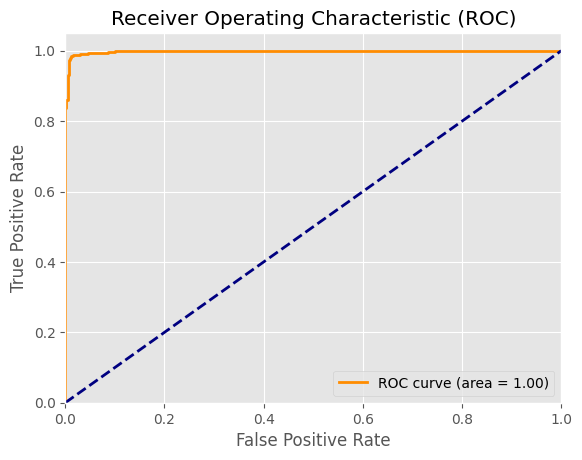

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

### LOSS ACC

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/history2D_baru.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory2D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data



In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")


0.9845161437988281
Nilai tertinggi val_accuracy: 0.9845161437988281 pada epoch ke-5


In [ ]:

def plot_metric(history, metric, log_scale=False, smooth_window=None, vertical_line_epoch=None):
    if smooth_window:
        smooth_metric = np.convolve(history[metric], np.ones(smooth_window)/smooth_window, mode='valid')
        plt.plot(range(1, len(smooth_metric) + 1), smooth_metric, label=f'Training {metric.capitalize()} (Smoothed)')
    else:
        plt.plot(range(1, len(history[metric]) + 1), history[metric], label=f'Training {metric.capitalize()}')

    val_metric = f'val_{metric}'
    if val_metric in history:
        if smooth_window:
            smooth_val_metric = np.convolve(history[val_metric], np.ones(smooth_window)/smooth_window, mode='valid')
            plt.plot(range(1, len(smooth_val_metric) + 1), smooth_val_metric, label=f'Validation {metric.capitalize()} (Smoothed)')
        else:
            plt.plot(range(1, len(history[val_metric]) + 1), history[val_metric], label=f'Validation {metric.capitalize()}')

    if vertical_line_epoch:
        plt.axvline(x=vertical_line_epoch, color='r', linestyle='--', label=f'Epoch {vertical_line_epoch}')

        # Tampilkan nilai metric pada epoch yang berpotongan dengan garis vertical
        intersect_value_train = history[metric][vertical_line_epoch - 1]
        intersect_value_val = history[val_metric][vertical_line_epoch - 1]
        plt.text(vertical_line_epoch, intersect_value_train, f'{intersect_value_train:.4f}', color='r')
        plt.text(vertical_line_epoch, intersect_value_val, f'{intersect_value_val:.4f}', color='dodgerblue')

    plt.title(f'Training and Validation {metric.capitalize()}')
    plt.xlabel('Epochs')
    plt.ylabel(metric.capitalize())
    if log_scale:
        plt.yscale('log')
    plt.legend()
    plt.show()




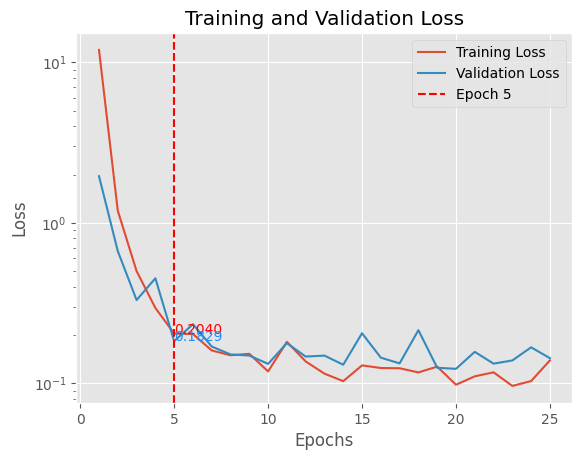

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=None, vertical_line_epoch=5)

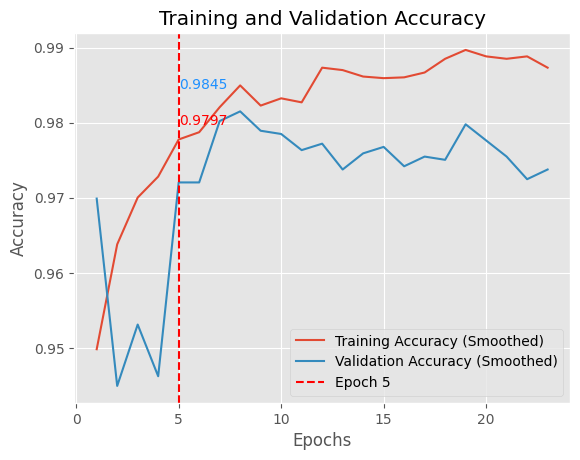

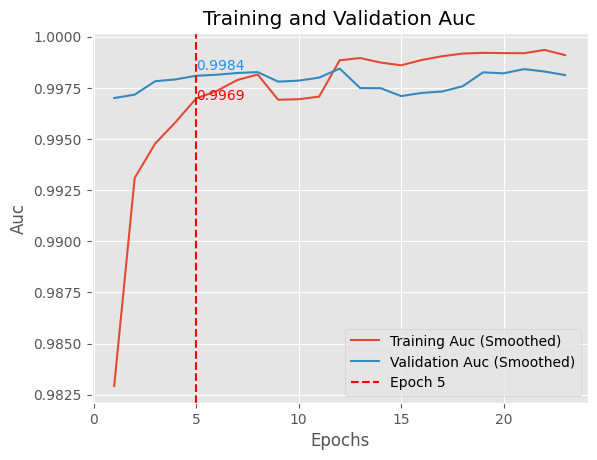

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=5)

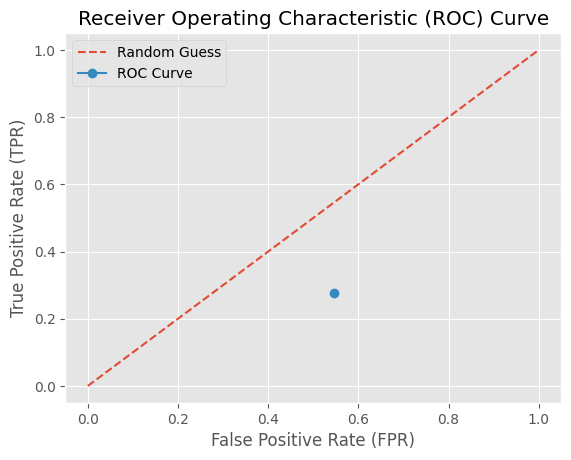

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate TPR and FPR
def calculate_roc_points(tp, tn, fp, fn):
    tpr = tp / (tp + fn) * 0.5
    fpr = fp / (fp + tn)
    return tpr, fpr

# Example confusion matrix
tp = 10
tn = 5
fp = 6
fn = 8

# Calculate TPR and FPR for the example confusion matrix
tpr, fpr = calculate_roc_points(tp, tn, fp, fn)

# Plot ROC curve
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Guess')
plt.plot(fpr, tpr, marker='o', label='ROC Curve')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.grid(True)
plt.show()


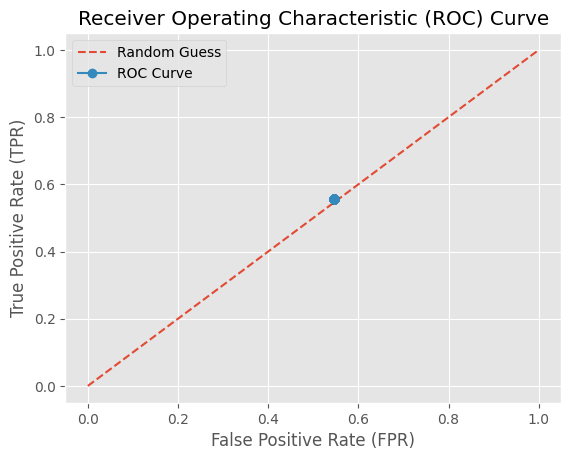

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate TPR and FPR for given threshold
def calculate_roc_points(tp, tn, fp, fn, threshold):
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)
    return tpr, fpr

# Example confusion matrix
tp = 10
tn = 5
fp = 6
fn = 8

# Generate various thresholds
thresholds = np.linspace(0, 1, 100)

# Initialize lists to store TPR and FPR values
tpr_values = []
fpr_values = []

# Calculate TPR and FPR for each threshold
for threshold in thresholds:
    tpr, fpr = calculate_roc_points(tp, tn, fp, fn, threshold)
    tpr_values.append(tpr)
    fpr_values.append(fpr)

# Plot ROC curve
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Guess')
plt.plot(fpr_values, tpr_values, marker='o', label='ROC Curve')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.grid(True)
plt.show()


### LOSS ACC Uji 1

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history2D_uji1.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory2D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data



In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")


0.9845161437988281
Nilai tertinggi val_accuracy: 0.9845161437988281 pada epoch ke-5


In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=None, vertical_line_epoch=5)

NameError: name 'plot_metric' is not defined

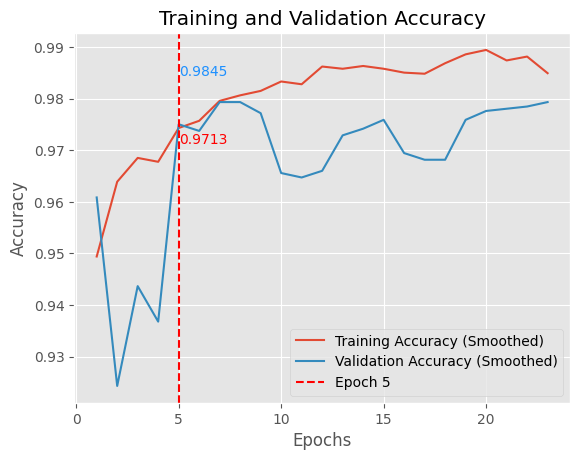

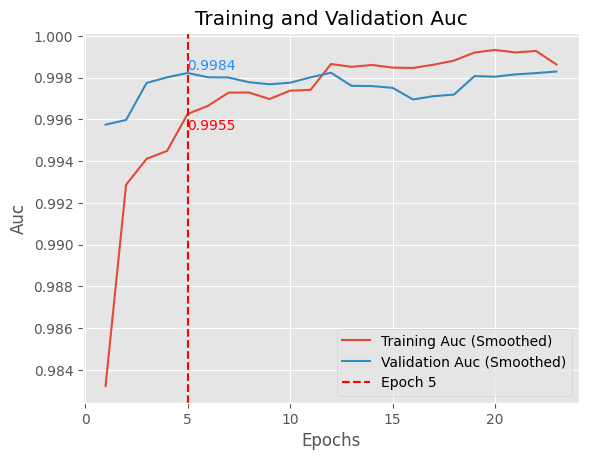

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=5)

### LOSS ACC Uji 2

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history2D_uji2.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory2D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data



In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")


0.9870967864990234
Nilai tertinggi val_accuracy: 0.9870967864990234 pada epoch ke-45


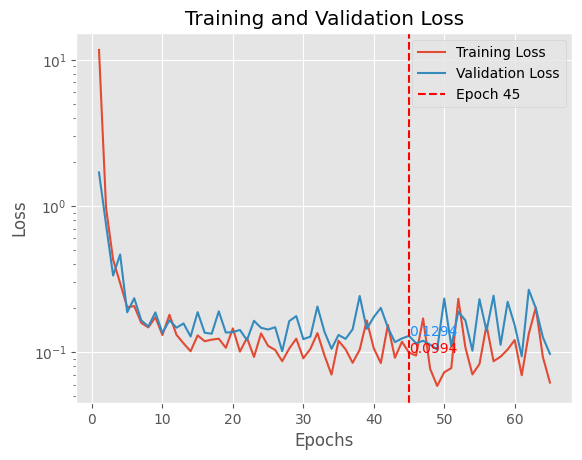

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=None, vertical_line_epoch=45)

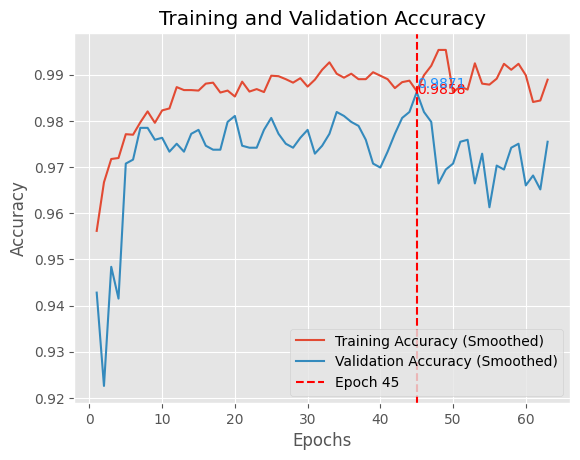

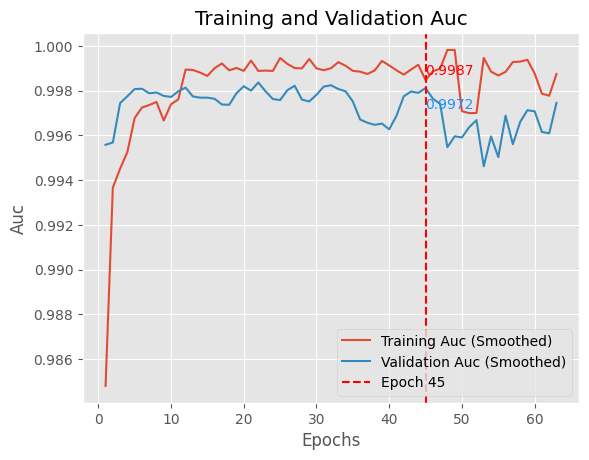

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=45)

### LOSS ACC Uji 3

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history2D_uji3.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory2D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data



In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")


0.9845161437988281
Nilai tertinggi val_accuracy: 0.9845161437988281 pada epoch ke-17


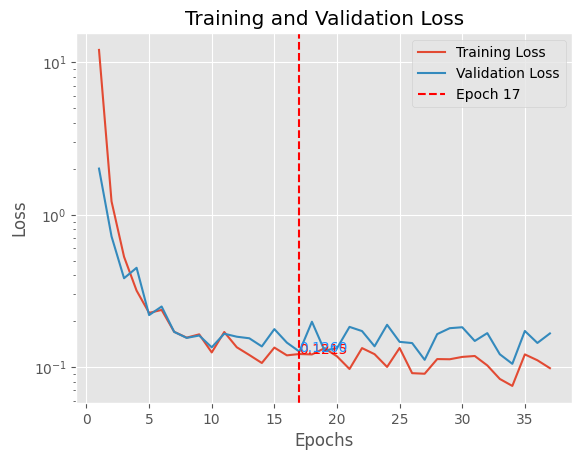

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=None, vertical_line_epoch=17)

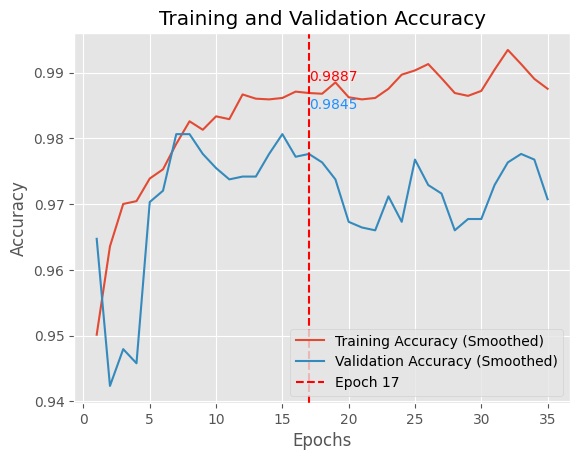

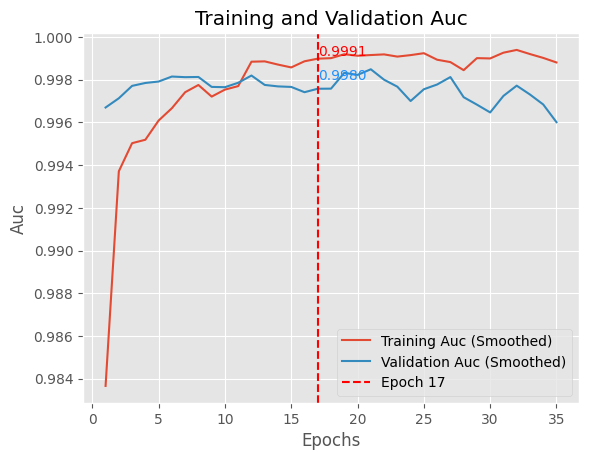

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=17)

## Model1D

In [ ]:

# Muat kembali model dari file H5
loaded_model1d = load_model('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/model1d_vgg_512.h5')

In [ ]:
# Bekukan bobot model yang sudah dimuat
for layer in loaded_model1d.layers:
    layer.trainable = False


In [ ]:
# Kompilasi model setelah mengatur lapisan-lapisan menjadi tidak dapat dilatih
loaded_model1d.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Coba melatih model yang telah dimuat kembali
loaded_model1d.fit( X_train_reshaped, y_train, epochs=1, batch_size=32, validation_data=( X_test_reshaped, y_test))


/usr/local/lib/python3.10/dist-packages/tensorflow/python/util/dispatch.py:1260: SyntaxWarning: In loss categorical_crossentropy, expected y_pred.shape to be (batch_size, num_classes) with num_classes > 1. Received: y_pred.shape=(None, 1). Consider using 'binary_crossentropy' if you only have 2 classes.
  return dispatch_target(*args, **kwargs)


97/97 [==============================] - 6s 48ms/step - loss: 0.0000e+00 - accuracy: 0.8250 - val_loss: 0.0000e+00 - val_accuracy: 0.8232


In [ ]:
y_pred_prob = loaded_model1d.predict(X_test_reshaped)

25/25 [==============================] - 1s 29ms/step


In [ ]:
print(y_pred_prob)

[[1.37216877e-02]
 [9.78185654e-01]
 [2.09196638e-02]
 [4.03843634e-02]
 [2.57074684e-01]
 [3.54573578e-01]
 [3.36864024e-01]
 [1.23980619e-01]
 [7.49993265e-01]
 [1.75952092e-01]
 [7.84077227e-01]
 [3.50731723e-02]
 [2.74938978e-02]
 [1.06976330e-02]
 [3.03495497e-01]
 [8.34960282e-01]
 [2.18480781e-01]
 [5.53089827e-02]
 [6.51129484e-02]
 [6.09000176e-02]
 [3.50969166e-01]
 [3.32570113e-02]
 [3.92230377e-02]
 [2.42977738e-01]
 [2.19203487e-01]
 [9.95134041e-02]
 [6.17299378e-01]
 [2.64176071e-01]
 [4.12346795e-02]
 [2.07061749e-02]
 [3.74695033e-01]
 [4.53308150e-02]
 [3.38246599e-02]
 [6.56506941e-02]
 [5.20481309e-03]
 [2.56223651e-03]
 [3.14383842e-02]
 [1.38254017e-02]
 [7.37015232e-02]
 [1.65093988e-02]
 [1.20349437e-01]
 [1.33321574e-02]
 [9.25187767e-01]
 [2.06975229e-02]
 [2.06605271e-02]
 [3.66026424e-02]
 [9.36642647e-01]
 [4.14903164e-02]
 [5.97909331e-01]
 [6.69041872e-01]
 [1.21256612e-01]
 [4.44657030e-03]
 [1.30593795e-02]
 [1.68411396e-02]
 [9.15151387e-02]
 [4.843984

In [ ]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = roc_auc_score(y_test, y_pred_prob)

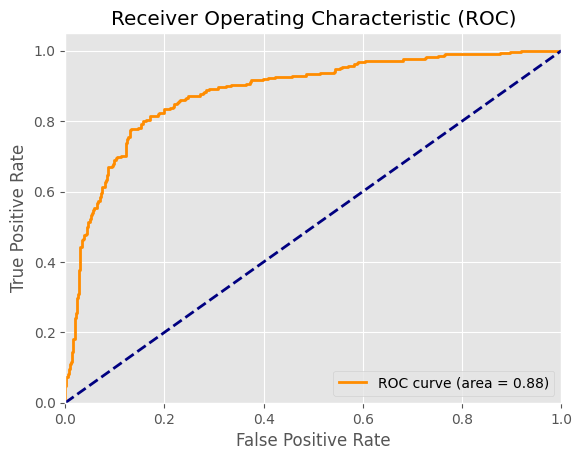

In [ ]:
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

### LOSS ACC

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history1D_baru.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory1D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.8232257962226868
Nilai tertinggi val_accuracy: 0.8232257962226868 pada epoch ke-37


In [ ]:

def plot_metric(history, metric, log_scale=False, smooth_window=None, vertical_line_epoch=None):
    if smooth_window:
        smooth_metric = np.convolve(history[metric], np.ones(smooth_window)/smooth_window, mode='valid')
        plt.plot(range(1, len(smooth_metric) + 1), smooth_metric, label=f'Training {metric.capitalize()} (Smoothed)')
    else:
        plt.plot(range(1, len(history[metric]) + 1), history[metric], label=f'Training {metric.capitalize()}')

    val_metric = f'val_{metric}'
    if val_metric in history:
        if smooth_window:
            smooth_val_metric = np.convolve(history[val_metric], np.ones(smooth_window)/smooth_window, mode='valid')
            plt.plot(range(1, len(smooth_val_metric) + 1), smooth_val_metric, label=f'Validation {metric.capitalize()} (Smoothed)')
        else:
            plt.plot(range(1, len(history[val_metric]) + 1), history[val_metric], label=f'Validation {metric.capitalize()}')

    if vertical_line_epoch:
        plt.axvline(x=vertical_line_epoch, color='r', linestyle='--', label=f'Epoch {vertical_line_epoch}')

        # Tampilkan nilai metric pada epoch yang berpotongan dengan garis vertical
        intersect_value_train = history[metric][vertical_line_epoch - 1]
        intersect_value_val = history[val_metric][vertical_line_epoch - 1]
        plt.text(vertical_line_epoch, intersect_value_train, f'{intersect_value_train:.4f}', color='r')
        plt.text(vertical_line_epoch, intersect_value_val, f'{intersect_value_val:.4f}', color='dodgerblue')

    plt.title(f'Training and Validation {metric.capitalize()}')
    plt.xlabel('Epochs')
    plt.ylabel(metric.capitalize())
    if log_scale:
        plt.yscale('log')
    plt.legend()
    plt.show()




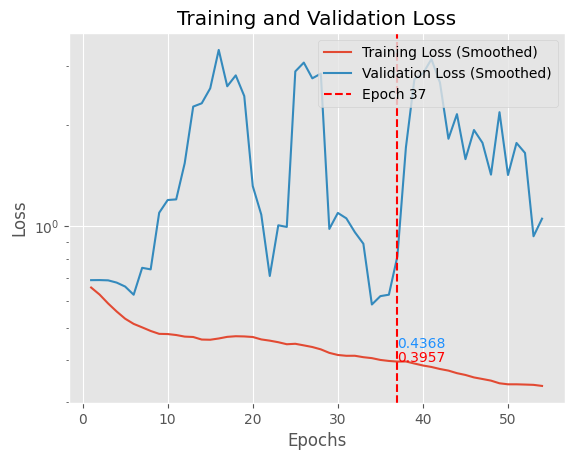

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=4, vertical_line_epoch=37)

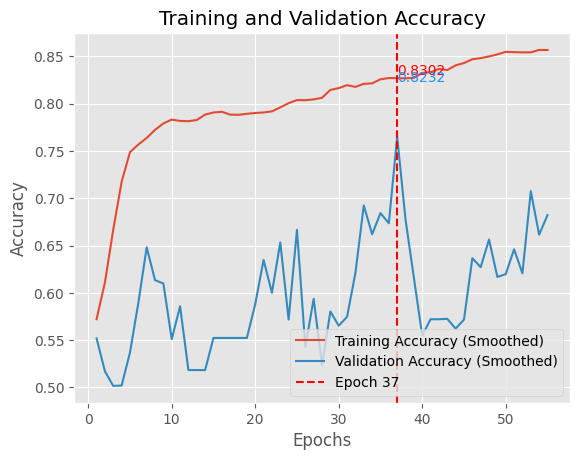

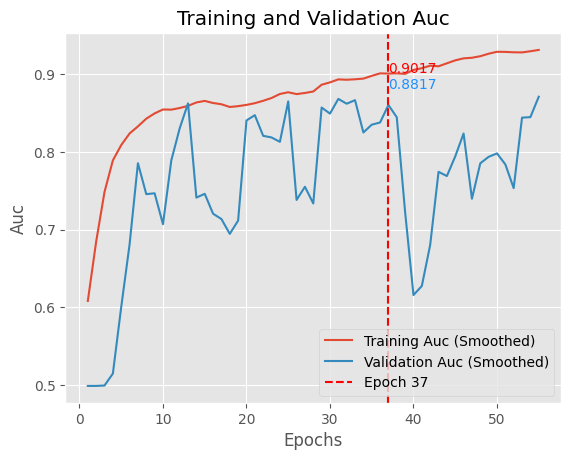

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=37)

### LOSS ACC uji 1

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history1D_uji1.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory1D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.7858064770698547
Nilai tertinggi val_accuracy: 0.7858064770698547 pada epoch ke-10


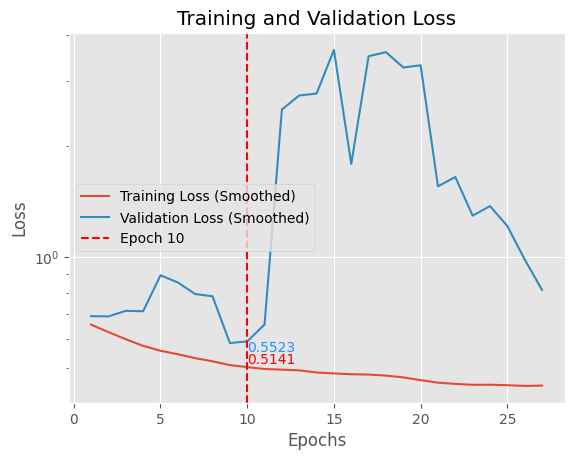

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=4, vertical_line_epoch=10)

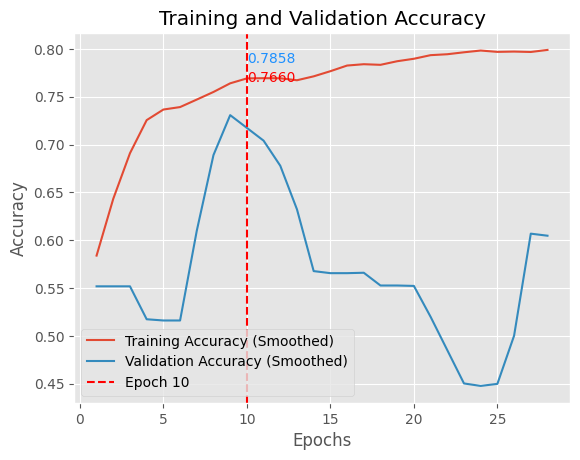

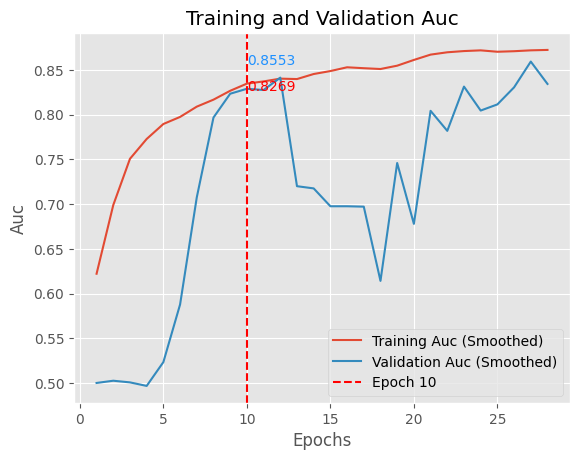

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=10)

### LOSS ACC Uji 2

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history1D_uji2.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory1D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.7858064770698547
Nilai tertinggi val_accuracy: 0.7858064770698547 pada epoch ke-10


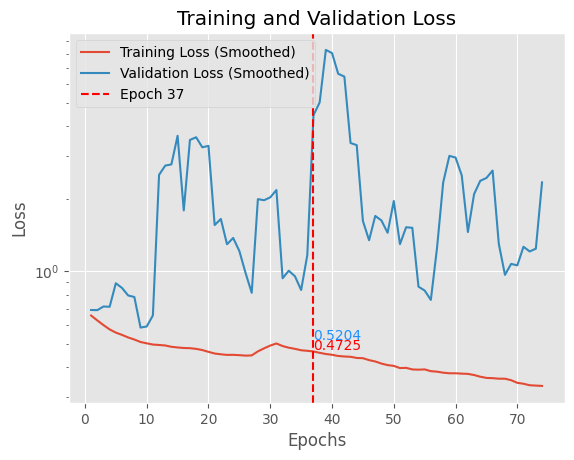

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=4, vertical_line_epoch=37)

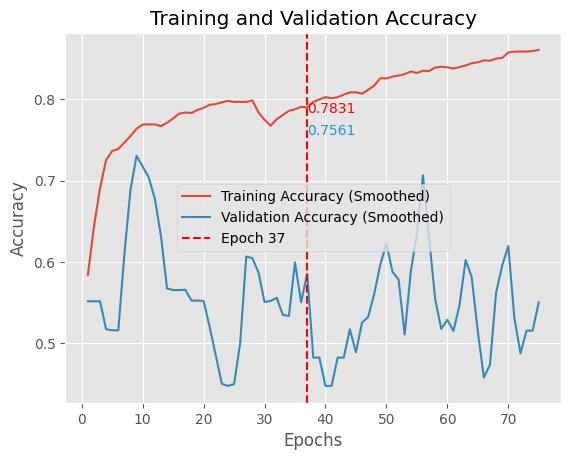

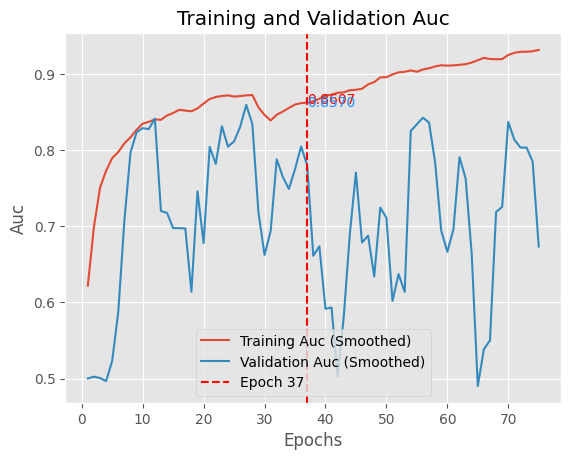

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=37)

### LOSS ACC Uji 3

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/history1D_uji3.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory1D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.8309677243232727
Nilai tertinggi val_accuracy: 0.8309677243232727 pada epoch ke-34


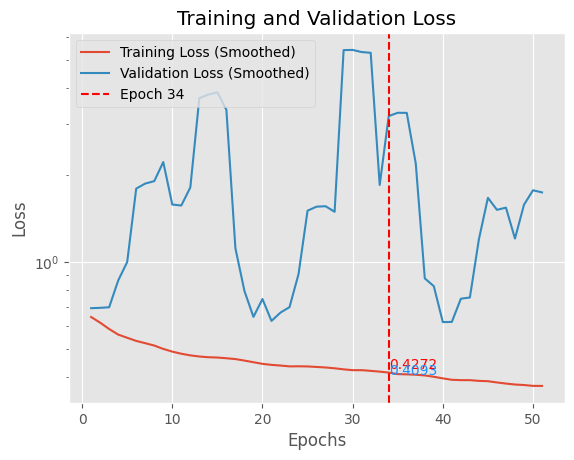

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=4, vertical_line_epoch=34)

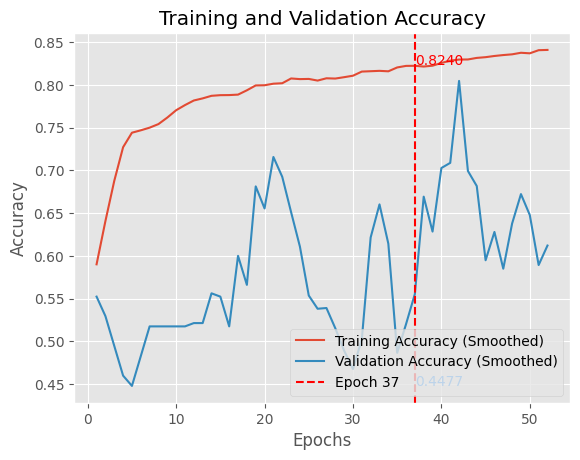

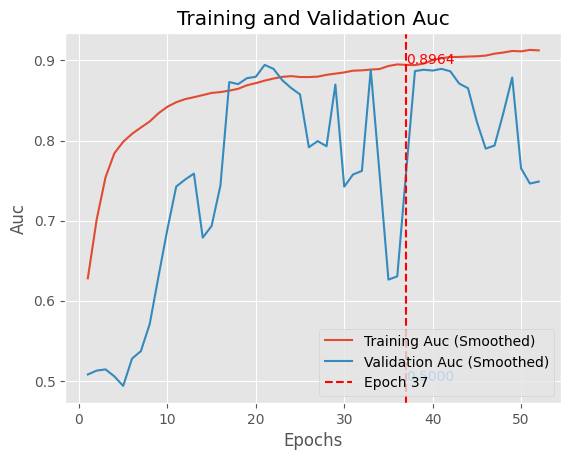

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=False, smooth_window=3, vertical_line_epoch=37)

## Combine Model

In [ ]:

# Muat kembali model dari file H5
loaded_combined_model = load_model('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/combined_model_vgg16.h5.h5')

In [ ]:
# Bekukan bobot model yang sudah dimuat
for layer in loaded_combined_model.layers:
    layer.trainable = False


In [ ]:
# Kompilasi model setelah mengatur lapisan-lapisan menjadi tidak dapat dilatih
loaded_combined_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Display model summary to ensure it's loaded correctly
loaded_combined_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 conv1d_input (InputLayer)   [(None, 8900, 1)]            0         []                            
                                                                                                  
 conv1d (Conv1D)             (None, 8896, 128)            768       ['conv1d_input[0][0]']        
                                                                                                  
 batch_normalization (Batch  (None, 8896, 128)            512       ['conv1d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv1d_1 (Conv1D)           (None, 8892, 128)            82048     ['batch_normalization[0]

In [ ]:
# Coba melatih model yang telah dimuat kembali
loaded_combined_model.fit([X_train_images_np, X_train_reshaped], y_train, epochs=1, batch_size=32, validation_data=([X_test_images_np, X_test_reshaped], y_test))

/usr/local/lib/python3.10/dist-packages/tensorflow/python/util/dispatch.py:1260: SyntaxWarning: In loss categorical_crossentropy, expected y_pred.shape to be (batch_size, num_classes) with num_classes > 1. Received: y_pred.shape=(None, 1). Consider using 'binary_crossentropy' if you only have 2 classes.
  return dispatch_target(*args, **kwargs)


97/97 [==============================] - 23s 226ms/step - loss: 0.0664 - accuracy: 0.9974 - val_loss: 0.0664 - val_accuracy: 0.9935


25/25 [==============================] - 4s 145ms/step


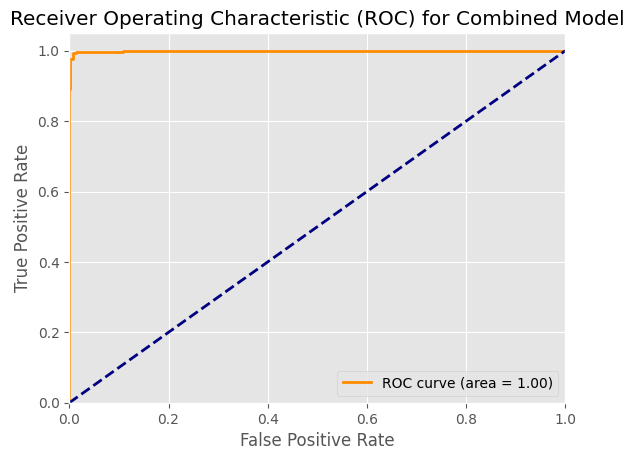

In [ ]:
# Prediksi pada data uji
y_pred_prob_combined = loaded_combined_model.predict([X_test_images_np, X_test_reshaped])

# Menghitung ROC curve
fpr_combined, tpr_combined, thresholds_combined = roc_curve(y_test, y_pred_prob_combined)

# Menghitung AUC
roc_auc_combined = roc_auc_score(y_test, y_pred_prob_combined)

# Plot ROC curve
plt.figure()
plt.plot(fpr_combined, tpr_combined, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_combined)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) for Combined Model')
plt.legend(loc="lower right")
plt.show()

In [ ]:
print(y_pred_prob_combined)

[[2.32187659e-07]
 [1.80330392e-06]
 [3.70536669e-04]
 [1.29881395e-08]
 [1.16808712e-02]
 [2.79821361e-05]
 [5.55761570e-09]
 [5.47863692e-06]
 [5.48953631e-06]
 [4.02631983e-03]
 [5.03528497e-07]
 [1.93382732e-07]
 [7.36954235e-06]
 [2.37446187e-07]
 [7.06505496e-04]
 [1.47119934e-07]
 [3.24579401e-06]
 [4.88100050e-05]
 [1.32165060e-05]
 [5.44460258e-04]
 [7.78032609e-06]
 [3.41575251e-05]
 [1.22760241e-07]
 [3.28603562e-08]
 [6.46730996e-06]
 [6.10127521e-04]
 [3.16860132e-06]
 [2.14080501e-07]
 [1.15838908e-02]
 [1.84312281e-08]
 [2.08586711e-03]
 [7.69442529e-04]
 [9.77963805e-01]
 [2.16461714e-07]
 [1.42098443e-07]
 [1.75618129e-06]
 [4.20821925e-05]
 [6.80606263e-07]
 [7.15727026e-07]
 [1.03442952e-04]
 [1.90354615e-06]
 [1.23980249e-06]
 [1.92474231e-01]
 [4.75791012e-06]
 [5.20239082e-05]
 [1.07122355e-06]
 [1.36350130e-03]
 [4.40050007e-06]
 [6.88540423e-03]
 [6.52791440e-01]
 [2.03078756e-07]
 [4.79435357e-07]
 [4.03956980e-01]
 [7.60063870e-08]
 [2.46888585e-03]
 [3.884611

### LOSS ACC

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/historyCombModel_baru.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistorycomb.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.9935483932495117
Nilai tertinggi val_accuracy: 0.9935483932495117 pada epoch ke-33


In [ ]:

def plot_metric(history, metric, log_scale=False, smooth_window=None, vertical_line_epoch=None):
    if smooth_window:
        smooth_metric = np.convolve(history[metric], np.ones(smooth_window)/smooth_window, mode='valid')
        plt.plot(range(1, len(smooth_metric) + 1), smooth_metric, label=f'Training {metric.capitalize()} (Smoothed)')
    else:
        plt.plot(range(1, len(history[metric]) + 1), history[metric], label=f'Training {metric.capitalize()}')

    val_metric = f'val_{metric}'
    if val_metric in history:
        if smooth_window:
            smooth_val_metric = np.convolve(history[val_metric], np.ones(smooth_window)/smooth_window, mode='valid')
            plt.plot(range(1, len(smooth_val_metric) + 1), smooth_val_metric, label=f'Validation {metric.capitalize()} (Smoothed)')
        else:
            plt.plot(range(1, len(history[val_metric]) + 1), history[val_metric], label=f'Validation {metric.capitalize()}')

    if vertical_line_epoch:
        plt.axvline(x=vertical_line_epoch, color='r', linestyle='--', label=f'Epoch {vertical_line_epoch}')

        # Tampilkan nilai metric pada epoch yang berpotongan dengan garis vertical
        intersect_value_train = history[metric][vertical_line_epoch - 1]
        intersect_value_val = history[val_metric][vertical_line_epoch - 1]
        plt.text(vertical_line_epoch, intersect_value_train, f'{intersect_value_train:.4f}', color='r')
        plt.text(vertical_line_epoch, intersect_value_val, f'{intersect_value_val:.4f}', color='dodgerblue')

    plt.title(f'Training and Validation {metric.capitalize()}')
    plt.xlabel('Epochs')
    plt.ylabel(metric.capitalize())
    if log_scale:
        plt.yscale('log')
    plt.legend()
    plt.show()




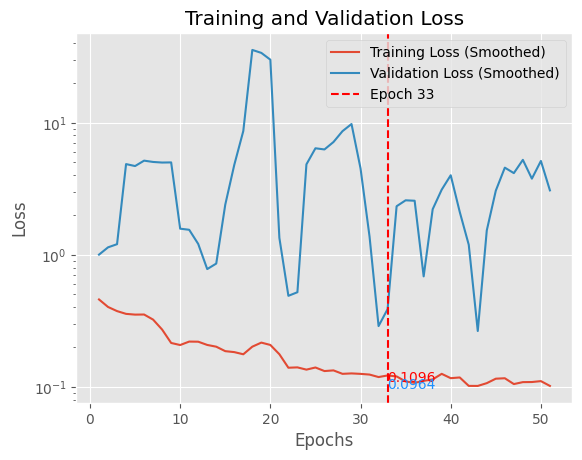

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=33)

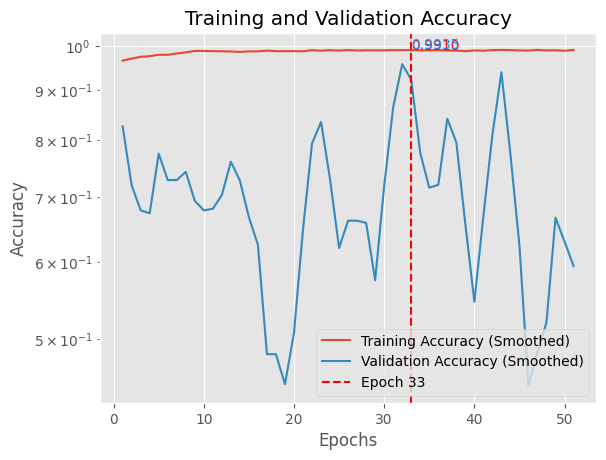

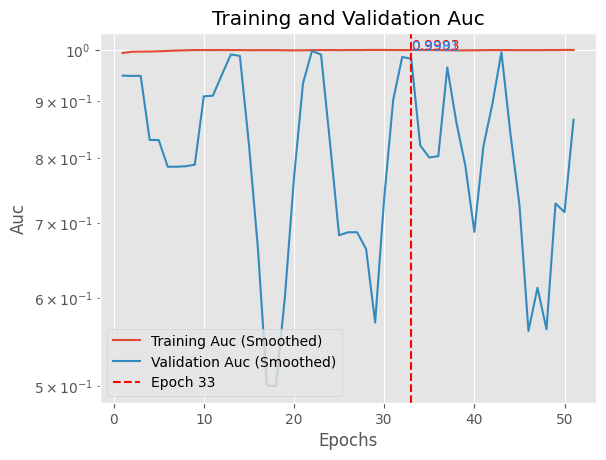

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=33)

### LOSS ACC Uji 1

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/historyCombModel_uji1.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistorycomb.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.9845161437988281
Nilai tertinggi val_accuracy: 0.9845161437988281 pada epoch ke-26


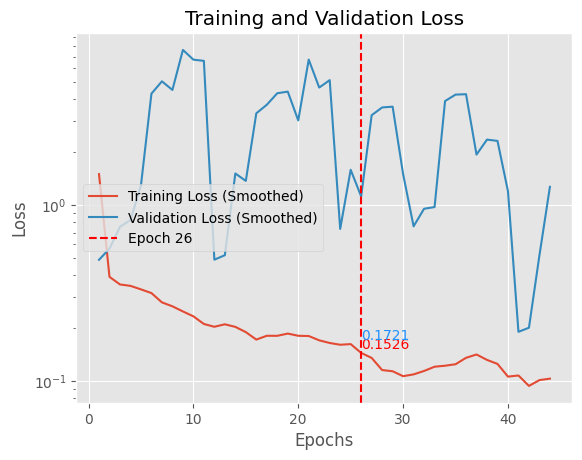

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=26)

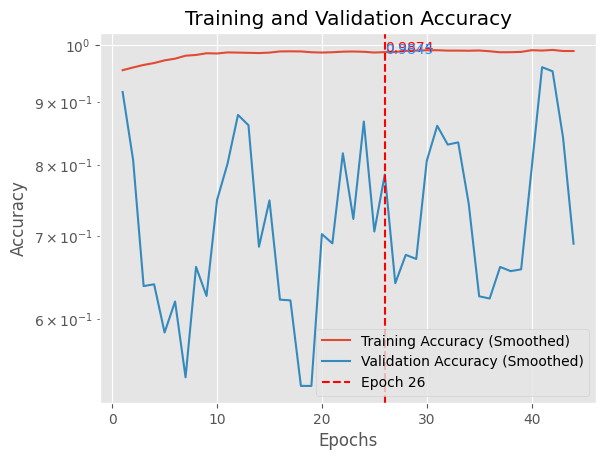

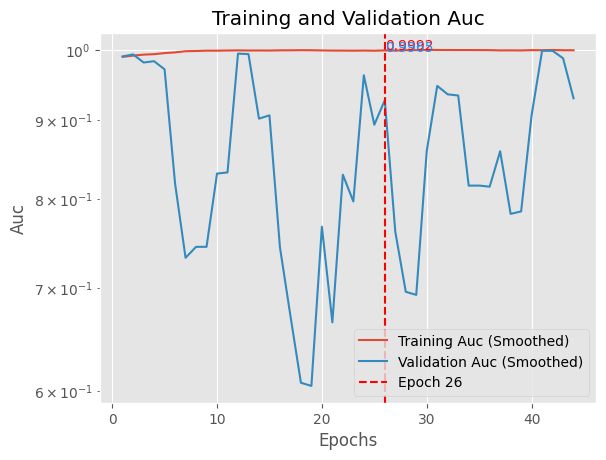

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=26)

### LOSS ACC Uji 2

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/historyCombModel_uji2.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistorycomb.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.9780645370483398
Nilai tertinggi val_accuracy: 0.9780645370483398 pada epoch ke-11


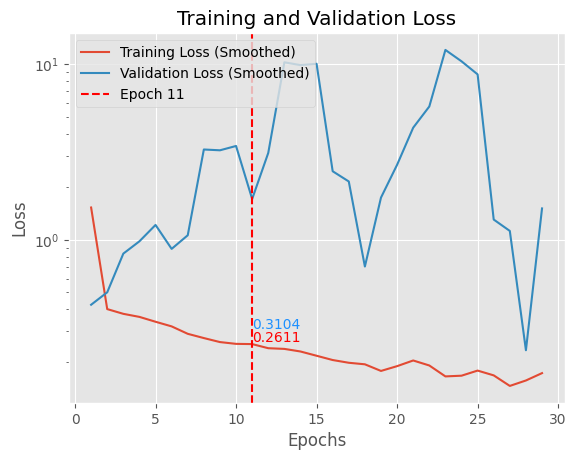

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=11)

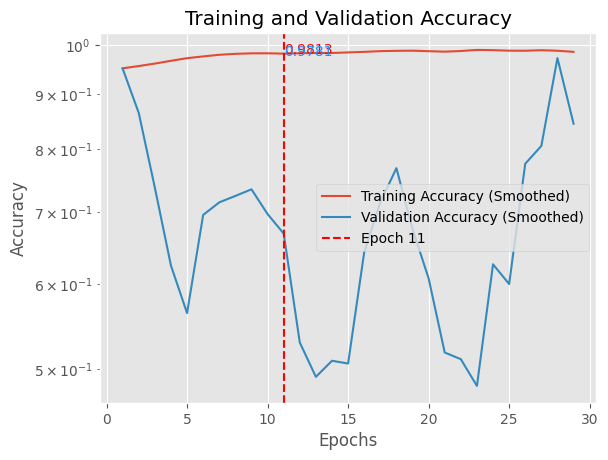

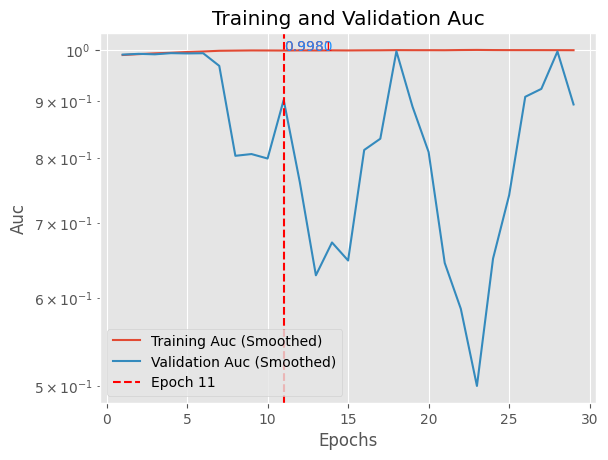

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=11)

### LOSS ACC Uji 3

In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/historyCombModel_uji3.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistorycomb.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data


In [ ]:
import numpy as np

# Mendapatkan nilai tertinggi dari val_accuracy
max_val_accuracy = np.max(loaded_loss_acc_history.history['val_accuracy'])

print(max_val_accuracy)
# Mendapatkan indeks dari nilai tertinggi
epoch_with_max_val_accuracy = np.argmax(loaded_loss_acc_history.history['val_accuracy'])

print(f"Nilai tertinggi val_accuracy: {max_val_accuracy} pada epoch ke-{epoch_with_max_val_accuracy + 1}")

0.9819355010986328
Nilai tertinggi val_accuracy: 0.9819355010986328 pada epoch ke-32


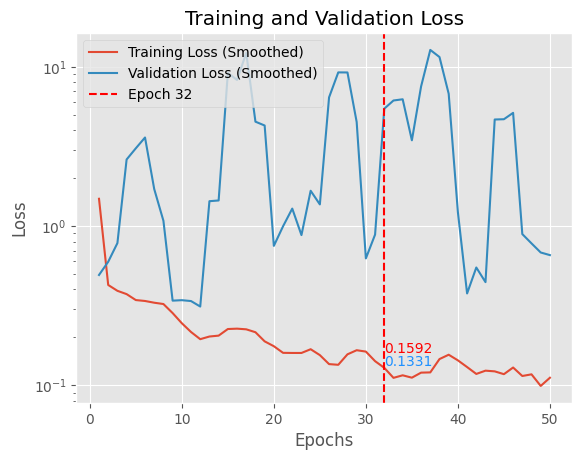

In [ ]:
# Example usage:
metrics_to_plot = ['loss']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=32)

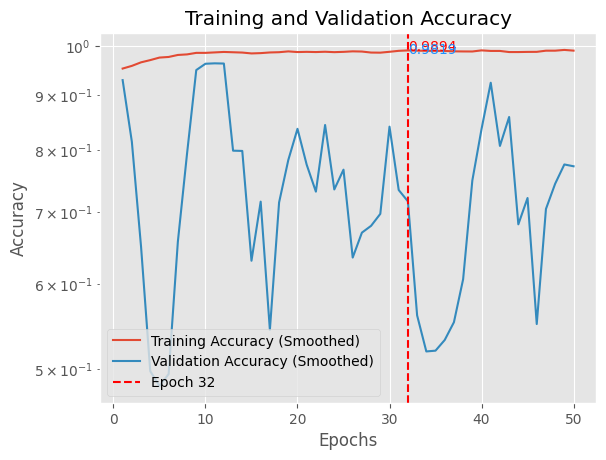

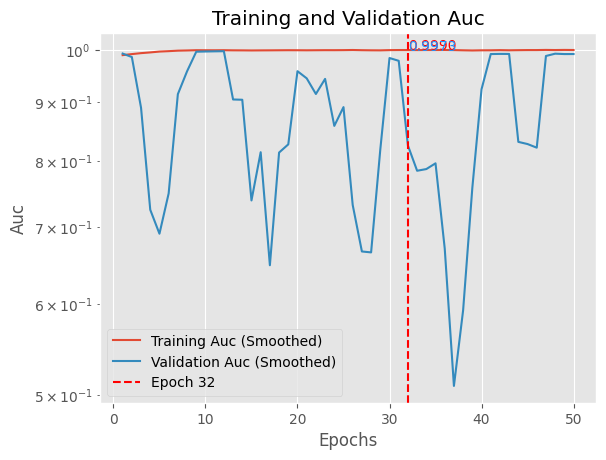

In [ ]:
# Example usage:
metrics_to_plot = ['accuracy', 'auc']
for metric in metrics_to_plot:
    plot_metric(loaded_loss_acc_history.history, metric, log_scale=True, smooth_window=3, vertical_line_epoch=32)

# Uji Statistik

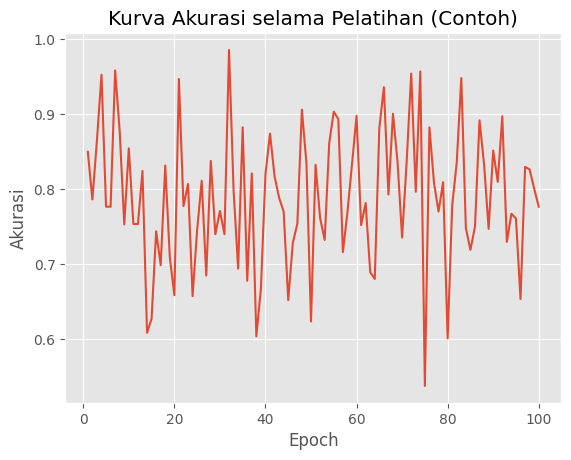

Mean Akurasi: 0.7896153482605907
Median Akurasi: 0.7873043708220288
Standar Deviasi Akurasi: 0.09036161766446296


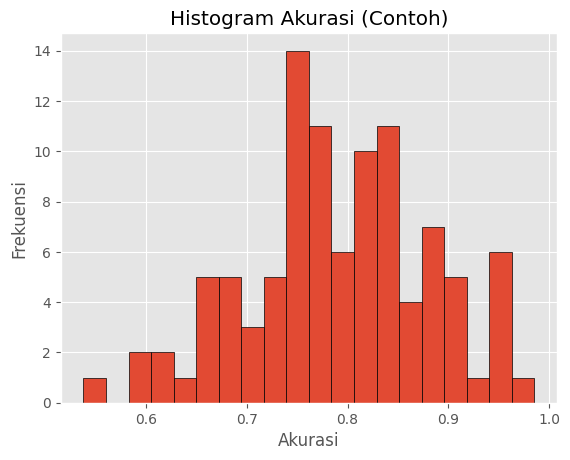

Uji Shapiro-Wilk p-value: 0.6551519632339478


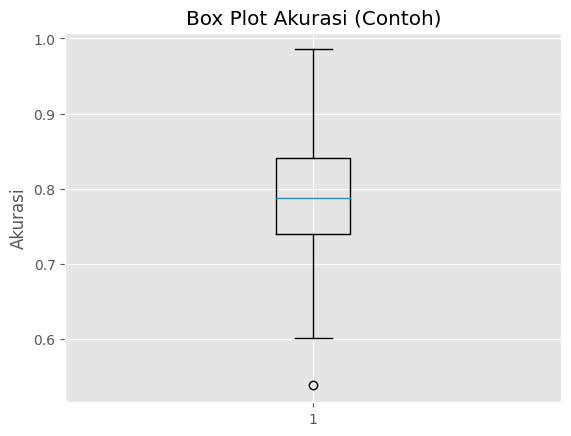

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

# Contoh data akurasi pada setiap epoch
np.random.seed(42)
akurasi = np.random.normal(loc=0.8, scale=0.1, size=100)  # Contoh distribusi normal

# Visualisasi kurva akurasi
plt.plot(range(1, 101), akurasi)
plt.xlabel('Epoch')
plt.ylabel('Akurasi')
plt.title('Kurva Akurasi selama Pelatihan (Contoh)')
plt.show()

# Statistik Deskriptif
mean_akurasi = np.mean(akurasi)
median_akurasi = np.median(akurasi)
std_akurasi = np.std(akurasi)

print(f"Mean Akurasi: {mean_akurasi}")
print(f"Median Akurasi: {median_akurasi}")
print(f"Standar Deviasi Akurasi: {std_akurasi}")

# Histogram
plt.hist(akurasi, bins=20, edgecolor='black')
plt.xlabel('Akurasi')
plt.ylabel('Frekuensi')
plt.title('Histogram Akurasi (Contoh)')
plt.show()

# Uji Normalitas (Shapiro-Wilk)
stat, p_value = stats.shapiro(akurasi)
print(f"Uji Shapiro-Wilk p-value: {p_value}")

# Box Plot
plt.boxplot(akurasi)
plt.ylabel('Akurasi')
plt.title('Box Plot Akurasi (Contoh)')
plt.show()


In [ ]:
# Buka file menggunakan mode 'rb' (read binary)
with open('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/history2D_baru.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

# Buat instance LossAccHistory
loaded_loss_acc_history = LossAccHistory(file_path='dummyhistory2D.pkl')
# Assign loaded data to the history attribute
loaded_loss_acc_history.history = loaded_data

In [ ]:
import os
import pickle

# Direktori tempat file history disimpan
directory_path = '/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/'

# Mendapatkan list file dalam direktori
file_list = os.listdir(directory_path)

# Mengambil hanya file dengan ekstensi .pkl
history_files = [file for file in file_list if file.endswith('.pkl')]

# Dictionary untuk menyimpan data dari setiap file
data_dict = {}

# Mengambil dan memproses data dari setiap file
for file_name in history_files:
    # Buka file
    with open(os.path.join(directory_path, file_name), 'rb') as file:
        loaded_data = pickle.load(file)

    # Menambahkan data ke dalam dictionary
    data_dict[file_name] = loaded_data

# Menyimpan masing-masing data ke dalam variabel sesuai dengan nama filenya
history1D_baru = data_dict['history1D_baru.pkl']
history1D_uji1 = data_dict['history1D_uji1.pkl']
history1D_uji2 = data_dict['history1D_uji2.pkl']
history1D_uji3 = data_dict['history1D_uji3.pkl']
history2D_baru = data_dict['history2D_baru.pkl']
history2D_uji1 = data_dict['history2D_uji1.pkl']
history2D_uji2 = data_dict['history2D_uji2.pkl']
history2D_uji3 = data_dict['history2D_uji3.pkl']
historyCombModel_baru = data_dict['historyCombModel_baru.pkl']
historyCombModel_uji1 = data_dict['historyCombModel_uji1.pkl']
historyCombModel_uji2 = data_dict['historyCombModel_uji2.pkl']
historyCombModel_uji3 = data_dict['historyCombModel_uji3.pkl']

In [ ]:
print(len(history2D_baru['loss']))
print(len(history2D_uji1['loss']))
print(len(history2D_uji2['loss']))
print(len(history2D_uji3['loss']))

25
25
65
37


In [ ]:
import os
import pickle

def read_and_store_history(directory_path, variable_names=None, file_extension='.pkl'):
    """
    Membaca dan menyimpan data dari setiap file dalam direktori ke dalam variabel sesuai nama filenya.

    Parameters:
    - directory_path (str): Path ke direktori yang berisi file history.
    - variable_names (list): Nama variabel yang akan digunakan untuk menyimpan data.
    - file_extension (str): Ekstensi file yang akan dibaca.

    Returns:
    - data_dict (dict): Dictionary yang berisi data dari setiap file, dengan nama file sebagai kunci.
    """

    # Mendapatkan list file dalam direktori
    file_list = os.listdir(directory_path)

    # Mengambil hanya file dengan ekstensi yang sesuai
    history_files = [file for file in file_list if file.endswith(file_extension)]

    # Dictionary untuk menyimpan data dari setiap file
    data_dict = {}

    # Mengambil dan memproses data dari setiap file
    for file_name in history_files:
        # Mendapatkan nama variable yang sesuai
        variable_name = file_name.replace(file_extension, '')
        if variable_names is not None and variable_name not in variable_names:
            continue

        # Buka file
        with open(os.path.join(directory_path, file_name), 'rb') as file:
            loaded_data = pickle.load(file)

        # Menambahkan data ke dalam dictionary
        data_dict[variable_name] = loaded_data

    return data_dict

# Contoh penggunaan fungsi
variable_names = ['history2D_baru', 'history2D_uji1', 'history2D_uji2', 'history2D_uji3']
data_dict = read_and_store_history('/content/drive/MyDrive/Colab Notebooks/ml_storage/TA/', variable_names)

# Menyimpan masing-masing data ke dalam variabel sesuai dengan nama filenya
history2D_baru = data_dict.get('history2D_baru')
history2D_uji1 = data_dict.get('history2D_uji1')
history2D_uji2 = data_dict.get('history2D_uji2')
history2D_uji3 = data_dict.get('history2D_uji3')


In [ ]:
print(len(history2D_baru['loss']))
print(len(history2D_uji1['loss']))
print(len(history2D_uji2['loss']))
print(len(history2D_uji3['loss']))

25
25
65
37


In [ ]:
# Dataset pertama
data1 = {'loss': [10.0, 9.5, 9.8, 9.2, 9.7],
         'accuracy': [0.9, 0.92, 0.91, 0.93, 0.89],
         'val_loss': [1.8, 1.5, 1.6, 1.4, 1.7]}

# Dataset kedua
data2 = {'loss': [11.0, 11.2, 11.5, 10.8, 11.3],
         'accuracy': [0.88, 0.87, 0.89, 0.86, 0.88],
         'val_loss': [1.9, 1.7, 1.8, 1.6, 1.9]}

# Dataset ketiga
data3 = {'loss': [9.5, 9.0, 9.2, 9.4, 9.1],
         'accuracy': [0.94, 0.95, 0.93, 0.96, 0.94],
         'val_loss': [1.7, 1.4, 1.5, 1.3, 1.6]}

In [ ]:
import pandas as pd
import scipy.stats as stats

def anova_analysis(data1, data2, data3):
    """
    Melakukan uji ANOVA pada tiga dataset dan menampilkan tabel hasil.

    Parameters:
    - data1, data2, data3: Dictionary yang berisi loss, accuracy, dan val_loss.

    Returns:
    - Tabel hasil ANOVA.
    """

    # Menyiapkan data untuk ANOVA
    loss_data = [data1['loss'], data2['loss'], data3['loss']]
    accuracy_data = [data1['accuracy'], data2['accuracy'], data3['accuracy']]
    val_loss_data = [data1['val_loss'], data2['val_loss'], data3['val_loss']]

    # Melakukan uji ANOVA
    loss_anova = stats.f_oneway(*loss_data)
    accuracy_anova = stats.f_oneway(*accuracy_data)
    val_loss_anova = stats.f_oneway(*val_loss_data)

    # Menyiapkan tabel hasil
    result_table = pd.DataFrame({
        'Metric': ['Loss', 'Accuracy', 'Val Loss'],
        'F-Statistic': [loss_anova.statistic, accuracy_anova.statistic, val_loss_anova.statistic],
        'P-Value': [loss_anova.pvalue, accuracy_anova.pvalue, val_loss_anova.pvalue],
        'Significant': [loss_anova.pvalue < 0.05, accuracy_anova.pvalue < 0.05, val_loss_anova.pvalue < 0.05]
    })

    return result_table

# Contoh penggunaan fungsi pada dataset yang diberikan
result_table = anova_analysis(data1, data2, data3)
print(result_table)


     Metric  F-Statistic       P-Value  Significant
0      Loss    73.645933  1.827788e-07         True
1  Accuracy    34.000000  1.139063e-05         True
2  Val Loss     4.507463  3.466733e-02         True


In [ ]:
loss_data = [[1,1,0,1],[1,0,1,1],[1,1,1,0]]

In [ ]:
loss_data

[[1, 1, 0, 1], [1, 0, 1, 1], [1, 1, 1, 0]]

In [ ]:
loss_anova = stats.f_oneway(*loss_data)
loss_anova

F_onewayResult(statistic=0.0, pvalue=1.0)

In [ ]:
import pandas as pd
import scipy.stats as stats

def perform_anova(*datasets):
    """
    Melakukan uji Anova untuk beberapa dataset.

    Parameters:
    - datasets: Dataset yang akan diuji. Setiap dataset harus berisi kunci yang sama.

    Returns:
    - dataframe: Dataframe berisi nilai p untuk setiap kunci dan variabel.
    """

    # Menggabungkan data dari semua dataset
    all_data = {key: [] for key in datasets[0].keys()}
    for dataset in datasets:
        for key, values in dataset.items():
            all_data[key].extend(values)

    # Menyiapkan data dalam format yang diperlukan oleh uji Anova
    data_for_anova = [values for key, values in all_data.items()]

    # Melakukan uji Anova
    statistic, p_value = stats.f_oneway(*data_for_anova)

    # Menyusun hasil ke dalam dataframe
    result_data = {'Key': list(all_data.keys()), 'P-Value': p_value}
    result_df = pd.DataFrame(result_data)

    return result_df

# Menggunakan fungsi untuk melakukan uji Anova
anova_result = perform_anova(history2D_baru)

print(anova_result)


             Key  P-Value
0           loss      0.0
1       accuracy      0.0
2       val_loss      0.0
3   val_accuracy      0.0
4             tp      0.0
5             tn      0.0
6             fp      0.0
7             fn      0.0
8         val_tp      0.0
9         val_tn      0.0
10        val_fp      0.0
11        val_fn      0.0
12           auc      0.0
13       val_auc      0.0


In [ ]:
import pandas as pd
import scipy.stats as stats

def anova_analysis(metrics, *datasets):
    """
    Melakukan uji ANOVA pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - metrics: Tuple berisi string-string nama metrik yang ingin diuji (misalnya, 'loss', 'accuracy', 'val_loss').
    - *datasets: Tuple berisi dictionary yang berisi metrik yang ingin diuji untuk setiap dataset.

    Returns:
    - Tabel hasil ANOVA untuk setiap metrik.
    """

    # Menyiapkan data untuk ANOVA
    metric_data = {metric: [data[metric] for data in datasets] for metric in metrics}

    # Melakukan uji ANOVA untuk setiap metrik
    result_tables = []
    for metric in metrics:
        metric_anova = stats.f_oneway(*metric_data[metric])

        # Menyiapkan tabel hasil untuk setiap metrik
        result_table = pd.DataFrame({
            'Metric': [metric],
            'F-Statistic': [metric_anova.statistic],
            'P-Value': [metric_anova.pvalue],
            'Significant': [metric_anova.pvalue < 0.05]
        })

        result_tables.append(result_table)

    return result_tables

# Contoh penggunaan fungsi pada dataset yang diberikan
metrics = ('loss', 'accuracy', 'val_loss')
result_tables = anova_analysis(metrics, data1, data2, data3)

for result_table in result_tables:
    print(result_table)


  Metric  F-Statistic       P-Value  Significant
0   loss    73.645933  1.827788e-07         True
     Metric  F-Statistic   P-Value  Significant
0  accuracy         34.0  0.000011         True
     Metric  F-Statistic   P-Value  Significant
0  val_loss     4.507463  0.034667         True


In [ ]:
import pandas as pd
import scipy.stats as stats

def anova_analysis(datasets, metrics, alpha=0.05):
    """
    Melakukan uji ANOVA pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - Tabel hasil ANOVA untuk setiap metrik.
    """

    # Menyiapkan data untuk ANOVA
    data_dict = {metric: [dataset[metric] for dataset in datasets] for metric in metrics}

    # Melakukan uji ANOVA untuk setiap metrik
    result_tables = []
    for metric in metrics:
        metric_anova = stats.f_oneway(*data_dict[metric])

        # Menyiapkan tabel hasil untuk setiap metrik
        result_table = pd.DataFrame({
            'Metric': [metric],
            'F-Statistic': [metric_anova.statistic],
            'P-Value': [metric_anova.pvalue],
            'Significant': [metric_anova.pvalue < alpha]
        })

        result_tables.append(result_table)

    return result_tables

# Contoh penggunaan fungsi pada dataset yang diberikan
data1 = {'loss': [10.0, 9.5, 9.8, 9.2, 9.7],
         'accuracy': [0.9, 0.92, 0.91, 0.93, 0.89],
         'val_loss': [1.8, 1.5, 1.6, 1.4, 1.7]}

data2 = {'loss': [11.0, 11.2, 11.5, 10.8, 11.3],
         'accuracy': [0.88, 0.87, 0.89, 0.86, 0.88],
         'val_loss': [1.9, 1.7, 1.8, 1.6, 1.9]}

data3 = {'loss': [9.5, 9.0, 9.2, 9.4, 9.1],
         'accuracy': [0.94, 0.95, 0.93, 0.96, 0.94],
         'val_loss': [1.7, 1.4, 1.5, 1.3, 1.6]}

datasets = [data1, data2, data3]
metrics = ['loss', 'accuracy', 'val_loss']
result_tables = anova_analysis(datasets, metrics, alpha=0.05)

for result_table in result_tables:
    print(result_table)


  Metric  F-Statistic       P-Value  Significant
0   loss    73.645933  1.827788e-07         True
     Metric  F-Statistic   P-Value  Significant
0  accuracy         34.0  0.000011         True
     Metric  F-Statistic   P-Value  Significant
0  val_loss     4.507463  0.034667         True


In [ ]:
import pandas as pd
import scipy.stats as stats

def anova_analysis(datasets, metrics, alpha=0.05):
    """
    Melakukan uji ANOVA pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji ANOVA untuk setiap metrik.
    """

    # Menyiapkan data untuk ANOVA
    data_dict = {metric: [dataset[metric] for dataset in datasets] for metric in metrics}

    # Melakukan uji ANOVA untuk setiap metrik
    result_dict = {'Metric': [], 'F-Statistic': [], 'P-Value': [], 'Significant': []}
    for metric in metrics:
        metric_anova = stats.f_oneway(*data_dict[metric])

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['F-Statistic'].append(metric_anova.statistic)
        result_dict['P-Value'].append(metric_anova.pvalue)
        result_dict['Significant'].append(metric_anova.pvalue < alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df

# Contoh penggunaan fungsi pada dataset yang diberikan
data1 = {'loss': [10.0, 9.5, 9.8, 9.2, 9.7],
         'accuracy': [0.9, 0.92, 0.91, 0.93, 0.89],
         'val_loss': [1.8, 1.5, 1.6, 1.4, 1.7]}

data2 = {'loss': [11.0, 11.2, 11.5, 10.8, 11.3],
         'accuracy': [0.88, 0.87, 0.89, 0.86, 0.88],
         'val_loss': [1.9, 1.7, 1.8, 1.6, 1.9]}

data3 = {'loss': [9.5, 9.0, 9.2, 9.4, 9.1],
         'accuracy': [0.94, 0.95, 0.93, 0.96, 0.94],
         'val_loss': [1.7, 1.4, 1.5, 1.3, 1.6]}

datasets = [data1, data2, data3]
metrics = ['loss', 'accuracy', 'val_loss']
result_df = anova_analysis(datasets, metrics, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)


     Metric  F-Statistic       P-Value  Significant
0      loss    73.645933  1.827788e-07         True
1  accuracy    34.000000  1.139063e-05         True
2  val_loss     4.507463  3.466733e-02         True


In [ ]:
import pandas as pd
import statsmodels.stats.multicomp as mc

def anova_and_posthoc(datasets, metrics, alpha=0.05):
    """
    Melakukan uji ANOVA dan post hoc (Tukey's HSD) pada beberapa metrik untuk dataset yang diberikan
    dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji ANOVA dan post hoc (Tukey's HSD) untuk setiap metrik.
    """

    # Menyiapkan data untuk ANOVA
    data_dict = {metric: [dataset[metric] for dataset in datasets] for metric in metrics}

    # Melakukan uji ANOVA untuk setiap metrik
    result_dict = {'Metric': [], 'F-Statistic': [], 'P-Value': [], 'Significant': []}
    posthoc_dict = {}
    for metric in metrics:
        metric_anova = stats.f_oneway(*data_dict[metric])

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['F-Statistic'].append(metric_anova.statistic)
        result_dict['P-Value'].append(metric_anova.pvalue)
        result_dict['Significant'].append(metric_anova.pvalue < alpha)

        # Melakukan uji post hoc (Tukey's HSD)
        posthoc = mc.MultiComparison(pd.DataFrame(data_dict[metric]).stack().reset_index(drop=True),
                                     pd.DataFrame(data_dict[metric]).stack().index.get_level_values(0))
        posthoc_result = posthoc.tukeyhsd(alpha=alpha)

        # Menyimpan hasil uji post hoc ke dalam dictionary
        posthoc_dict[metric] = posthoc_result

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df, posthoc_dict

# Contoh penggunaan fungsi pada dataset yang diberikan
result_anova, result_posthoc = anova_and_posthoc(datasets, metrics, alpha=0.05)

# Menampilkan hasil uji ANOVA
print("Hasil Uji ANOVA:")
print(result_anova)

# Menampilkan hasil uji post hoc (Tukey's HSD) untuk setiap metrik
for metric, posthoc_result in result_posthoc.items():
    print(f"\nHasil Uji Post Hoc (Tukey's HSD) untuk {metric}:")
    print(posthoc_result.summary())



Hasil Uji ANOVA:
     Metric  F-Statistic       P-Value  Significant
0      loss    73.645933  1.827788e-07         True
1  accuracy    34.000000  1.139063e-05         True
2  val_loss     4.507463  3.466733e-02         True

Hasil Uji Post Hoc (Tukey's HSD) untuk loss:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
     0      1     1.52    0.0  1.0746  1.9654   True
     0      2     -0.4 0.0801 -0.8454  0.0454  False
     1      2    -1.92    0.0 -2.3654 -1.4746   True
----------------------------------------------------

Hasil Uji Post Hoc (Tukey's HSD) untuk accuracy:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj  lower  upper  reject
--------------------------------------------------
     0      1   -0.034 0.0037 -0.056 -0.012   True
     0      2    0.034 0.0037  0.012  0.056   True
     1      2    0.068    0.0  0.046   0.09   True
-

## uji barlett

In [ ]:
import pandas as pd
import scipy.stats as stats

def homogeneity_test(datasets, metrics, sample_size, alpha=0.05):
    """
    Melakukan uji homogenitas Barlett pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah data atau sample yang diambil dari setiap dataset. Harus sama untuk setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji homogenitas Barlett untuk setiap metrik.
    """

    # Menyiapkan data untuk uji homogenitas Barlett
    data_dict = {metric: [dataset[metric][:sample_size] for dataset in datasets] for metric in metrics}

    # Melakukan uji homogenitas Barlett untuk setiap metrik
    result_dict = {'Metric': [], 'Statistic': [], 'P-Value': [], 'Homogeneous': []}
    for metric in metrics:
        metric_barlett = stats.bartlett(*data_dict[metric])

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['Statistic'].append(metric_barlett.statistic)
        result_dict['P-Value'].append(metric_barlett.pvalue)
        result_dict['Homogeneous'].append(metric_barlett.pvalue > alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3, history2D_baru, history2D_uji1, history2D_uji2, history2D_uji3, historyCombModel_baru,
historyCombModel_uji1, historyCombModel_uji2, historyCombModel_uji3]
metrics = ['loss', 'accuracy', 'val_loss', 'tp', 'tn', 'fp', 'fn']
result_df = homogeneity_test(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

     Metric   Statistic       P-Value  Homogeneous
0      loss  298.657953  1.679724e-57        False
1  accuracy  135.211104  1.530332e-23        False
2  val_loss  188.006703  2.271000e-34        False
3        tp  265.823623  1.346341e-50        False
4        tn  128.019948  4.377282e-22        False
5        fp  128.019948  4.377282e-22        False
6        fn  265.823623  1.346341e-50        False


## Uji F

In [ ]:
import pandas as pd
import scipy.stats as stats

def anova_analysis(datasets, metrics, sample_size, alpha=0.05):
    """
    Melakukan uji ANOVA pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah data atau sample yang diambil dari setiap dataset. Harus sama untuk setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji ANOVA untuk setiap metrik.
    """

    # Menyiapkan data untuk ANOVA
    data_dict = {metric: [dataset[metric][:sample_size] for dataset in datasets] for metric in metrics}

    # Melakukan uji ANOVA untuk setiap metrik
    result_dict = {'Metric': [], 'F-Statistic': [], 'P-Value': [], 'Significant': []}
    for metric in metrics:
        metric_anova = stats.f_oneway(*data_dict[metric])

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['F-Statistic'].append(metric_anova.statistic)
        result_dict['P-Value'].append(metric_anova.pvalue)
        result_dict['Significant'].append(metric_anova.pvalue < alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3, history2D_baru, history2D_uji1, history2D_uji2, history2D_uji3, historyCombModel_baru, .pkl']
historyCombModel_uji1, historyCombModel_uji2, historyCombModel_uji3

In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3, history2D_baru, history2D_uji1, history2D_uji2, history2D_uji3, historyCombModel_baru,
historyCombModel_uji1, historyCombModel_uji2, historyCombModel_uji3]
metrics = ['loss', 'accuracy', 'val_loss', 'tp', 'tn', 'fp', 'fn']
result_df = anova_analysis(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

     Metric  F-Statistic       P-Value  Significant
0      loss     0.428071  9.405296e-01        False
1  accuracy    75.776250  1.437586e-45         True
2  val_loss     1.943702  4.138457e-02         True
3        tp    17.691034  1.474178e-19         True
4        tn    44.274445  5.891283e-35         True
5        fp    44.274445  5.891283e-35         True
6        fn    17.691034  1.474178e-19         True


## Uji Tukey's HSD

In [ ]:
import pandas as pd
import statsmodels.stats.multicomp as multi

def tukeys_test(datasets, metrics, sample_size, alpha=0.05):
    """
    Melakukan uji Tukey's HSD pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah sampel yang diambil dari setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji Tukey's HSD untuk setiap metrik.
    """

    # Menggabungkan semua data menjadi satu dataset besar
    combined_data = pd.DataFrame()
    for metric in metrics:
        for i, dataset in enumerate(datasets):
            key_name = f"{metric}_dataset{i + 1}"
            combined_data[key_name] = dataset[metric][:sample_size]

    # Mengumpulkan data dalam bentuk yang sesuai dengan input Tukey's HSD
    data_tuples = []
    for metric in metrics:
        for i, dataset in enumerate(datasets):
            key_name = f"{metric}_dataset{i + 1}"
            metric_data = dataset[metric][:sample_size]
            data_tuples.extend([(key_name, value) for value in metric_data])

    # Membuat DataFrame untuk input Tukey's HSD
    tukey_input = pd.DataFrame(data_tuples, columns=['Group', 'Value'])

    # Melakukan uji Tukey's HSD
    tukey_result = multi.pairwise_tukeyhsd(tukey_input['Value'], tukey_input['Group'], alpha=alpha)

    # Mengkonversi hasil ke dalam DataFrame
    tukey_df = pd.DataFrame(data=tukey_result._results_table.data[1:], columns=tukey_result._results_table.data[0])

    return tukey_df


In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3]
metrics = ['accuracy']
result_df = tukeys_test(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

              group1             group2  meandiff   p-adj   lower   upper  \
0  accuracy_dataset1  accuracy_dataset2   -0.0004  1.0000 -0.0999  0.0992   
1  accuracy_dataset1  accuracy_dataset3   -0.0004  1.0000 -0.0999  0.0992   
2  accuracy_dataset1  accuracy_dataset4    0.0027  0.9999 -0.0969  0.1023   
3  accuracy_dataset2  accuracy_dataset3    0.0000  1.0000 -0.0996  0.0996   
4  accuracy_dataset2  accuracy_dataset4    0.0030  0.9998 -0.0965  0.1026   
5  accuracy_dataset3  accuracy_dataset4    0.0030  0.9998 -0.0965  0.1026   

   reject  
0   False  
1   False  
2   False  
3   False  
4   False  
5   False  


## Uji Normalitas

In [ ]:
import scipy.stats as stats
import pandas as pd

def normality_test(datasets, metrics, sample_size=None, alpha=0.05):
    """
    Melakukan uji distribusi normalitas (Shapiro-Wilk, Kolmogorov-Smirnov, Anderson-Darling) pada beberapa metrik
    untuk dataset yang diberikan.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.
    - sample_size: Jumlah data yang diambil untuk setiap metrik. Jika None, maka diambil semua data.

    Returns:
    - DataFrame berisi hasil uji normalitas untuk setiap metrik.
    """

    # Membuat dictionary untuk menyimpan hasil uji normalitas
    result_dict = {'Metric': [], 'W-Statistic (Shapiro)': [], 'P-Value (Shapiro)': [],
                   'Normal (Shapiro, p > 0.05)': [], 'W-Statistic (Kolmogorov-Smirnov)': [],
                   'P-Value (Kolmogorov-Smirnov)': [], 'Normal (Kolmogorov-Smirnov, p > 0.05)': [],
                   'Anderson-Darling Statistic': [], 'Critical Values (Anderson-Darling)': [],
                   'Significance Level (Anderson-Darling)': [], 'Normal (Anderson-Darling, p > 0.05)': []}

    # Melakukan uji normalitas untuk setiap metrik
    for metric in metrics:
        for i, dataset in enumerate(datasets):
            key_name = f"{metric}_dataset{i + 1}"

            # Mengambil sample_size data jika ditentukan
            data_sample = dataset[metric][:sample_size] if sample_size else dataset[metric]

            # Uji Shapiro-Wilk
            shapiro_statistic, shapiro_p_value = stats.shapiro(data_sample)
            shapiro_normality = shapiro_p_value > alpha

            # Uji Kolmogorov-Smirnov
            ks_statistic, ks_p_value = stats.kstest(data_sample, 'norm')
            ks_normality = ks_p_value > alpha

            # Uji Anderson-Darling
            anderson_statistic, anderson_critical, anderson_significance = stats.anderson(data_sample, 'norm')
            anderson_normality = anderson_significance > alpha

            # Menambahkan hasil uji ke dalam result_dict
            result_dict['Metric'].append(key_name)
            result_dict['W-Statistic (Shapiro)'].append(shapiro_statistic)
            result_dict['P-Value (Shapiro)'].append(shapiro_p_value)
            result_dict['Normal (Shapiro, p > 0.05)'].append(shapiro_normality)
            result_dict['W-Statistic (Kolmogorov-Smirnov)'].append(ks_statistic)
            result_dict['P-Value (Kolmogorov-Smirnov)'].append(ks_p_value)
            result_dict['Normal (Kolmogorov-Smirnov, p > 0.05)'].append(ks_normality)
            result_dict['Anderson-Darling Statistic'].append(anderson_statistic)
            result_dict['Critical Values (Anderson-Darling)'].append(anderson_critical)
            result_dict['Significance Level (Anderson-Darling)'].append(anderson_significance)
            result_dict['Normal (Anderson-Darling, p > 0.05)'].append(anderson_normality)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3]
metrics = ['accuracy']
result_df = normality_test(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

              Metric  W-Statistic (Shapiro)  P-Value (Shapiro)  \
0  accuracy_dataset1               0.825114           0.029217   
1  accuracy_dataset2               0.810070           0.019212   
2  accuracy_dataset3               0.810070           0.019212   
3  accuracy_dataset4               0.801503           0.015121   

   Normal (Shapiro, p > 0.05)  W-Statistic (Kolmogorov-Smirnov)  \
0                       False                          0.706443   
1                       False                          0.702213   
2                       False                          0.702213   
3                       False                          0.708437   

   P-Value (Kolmogorov-Smirnov)  Normal (Kolmogorov-Smirnov, p > 0.05)  \
0                      0.000015                                  False   
1                      0.000018                                  False   
2                      0.000018                                  False   
3                      0.000014      

## Uji Z dan T

In [ ]:
import numpy as np
import scipy.stats as stats

def ZTEST(sample1, sample2):
    """
    Melakukan uji Z (z-test) untuk dua sampel independen.

    Parameters:
    - sample1: Data dari sampel pertama.
    - sample2: Data dari sampel kedua.

    Returns:
    - z_statistic: Nilai statistik Z.
    - z_p_value: Nilai p dari uji Z.
    """
    mean1, mean2 = np.mean(sample1), np.mean(sample2)
    var1, var2 = np.var(sample1, ddof=1), np.var(sample2, ddof=1)
    n1, n2 = len(sample1), len(sample2)

    z_statistic = (mean1 - mean2) / np.sqrt((var1 / n1) + (var2 / n2))
    z_p_value = 2 * (1 - stats.norm.cdf(abs(z_statistic)))

    return z_statistic, z_p_value


def multiple_t_z_test(datasets, metrics, sample_size, alpha):
    """
    Melakukan uji t (Student) dan uji Z (z-test) untuk beberapa metrik pada dataset yang diberikan.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah data yang diambil dari setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji t dan uji Z untuk setiap metrik.
    """
    result_dict = {'Metric': [], 'T-Statistic': [], 'T-P-Value': [], 'T-Significant': [], 'Z-Statistic': [], 'Z-P-Value': [], 'Z-Significant': []}

    for metric in metrics:
        data_samples = [dataset[metric][:sample_size] for dataset in datasets]

        # Melakukan uji t (Student)
        t_statistic, t_p_value = stats.ttest_ind(data_samples[0], data_samples[1])

        # Melakukan uji Z (z-test)
        z_statistic, z_p_value = ZTEST(data_samples[0], data_samples[1])

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['T-Statistic'].append(t_statistic)
        result_dict['T-P-Value'].append(t_p_value)
        result_dict['T-Significant'].append(t_p_value < alpha)
        result_dict['Z-Statistic'].append(z_statistic)
        result_dict['Z-P-Value'].append(z_p_value)
        result_dict['Z-Significant'].append(z_p_value < alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
datasets = [history1D_baru, history1D_uji1]
metrics = ['accuracy']
result_df = multiple_t_z_test(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

     Metric  T-Statistic  T-P-Value  T-Significant  Z-Statistic  Z-P-Value  \
0  accuracy     0.009202   0.992759          False     0.009202   0.992658   

   Z-Significant  
0          False  


In [ ]:
def pairwise_t_z_test(datasets, metrics, sample_size, alpha):
    """
    Melakukan uji t (Student) dan uji Z (z-test) secara berpasangan untuk beberapa metrik pada semua kombinasi dataset.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah data yang diambil dari setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji t dan uji Z untuk setiap metrik pada semua kombinasi dataset.
    """
    result_dict = {'Dataset 1': [], 'Dataset 2': [], 'Metric': [], 'T-Statistic': [], 'T-P-Value': [], 'T-Significant': [], 'Z-Statistic': [], 'Z-P-Value': [], 'Z-Significant': []}

    # Iterasi untuk setiap kombinasi dataset
    for i in range(len(datasets)):
        for j in range(i+1, len(datasets)):
            dataset1_name = f'Dataset {i+1}'
            dataset2_name = f'Dataset {j+1}'

            for metric in metrics:
                # Mengambil sample dari masing-masing dataset
                data_sample1 = datasets[i][metric][:sample_size]
                data_sample2 = datasets[j][metric][:sample_size]

                # Melakukan uji t (Student)
                t_statistic, t_p_value = stats.ttest_ind(data_sample1, data_sample2)

                # Melakukan uji Z (z-test)
                z_statistic, z_p_value = ZTEST(data_sample1, data_sample2)

                # Menambahkan hasil uji ke dalam result_dict
                result_dict['Dataset 1'].append(dataset1_name)
                result_dict['Dataset 2'].append(dataset2_name)
                result_dict['Metric'].append(metric)
                result_dict['T-Statistic'].append(t_statistic)
                result_dict['T-P-Value'].append(t_p_value)
                result_dict['T-Significant'].append(t_p_value < alpha)
                result_dict['Z-Statistic'].append(z_statistic)
                result_dict['Z-P-Value'].append(z_p_value)
                result_dict['Z-Significant'].append(z_p_value < alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3]
metrics = ['accuracy']
result_df = pairwise_t_z_test(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

   Dataset 1  Dataset 2    Metric  T-Statistic  T-P-Value  T-Significant  \
0  Dataset 1  Dataset 2  accuracy     0.009202   0.992759          False   
1  Dataset 1  Dataset 3  accuracy     0.009202   0.992759          False   
2  Dataset 1  Dataset 4  accuracy    -0.070565   0.944522          False   
3  Dataset 2  Dataset 3  accuracy     0.000000   1.000000          False   
4  Dataset 2  Dataset 4  accuracy    -0.085682   0.932665          False   
5  Dataset 3  Dataset 4  accuracy    -0.085682   0.932665          False   

   Z-Statistic  Z-P-Value  Z-Significant  
0     0.009202   0.992658          False  
1     0.009202   0.992658          False  
2    -0.070565   0.943744          False  
3     0.000000   1.000000          False  
4    -0.085682   0.931719          False  
5    -0.085682   0.931719          False  


## Uji Chi-square

In [ ]:
import pandas as pd
import scipy.stats as stats

def chi_square_test(datasets, metrics, alpha=0.05):
    """
    Melakukan uji chi-square pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji chi-square untuk setiap metrik.
    """

    # Menyiapkan data untuk uji chi-square
    data_dict = {metric: [dataset[metric] for dataset in datasets] for metric in metrics}

    # Melakukan uji chi-square untuk setiap metrik
    result_dict = {'Metric': [], 'Chi-Square': [], 'P-Value': [], 'Homogeneous': []}
    for metric in metrics:
        # Menghitung tabel kontingensi dari data
        contingency_table = pd.crosstab(data_dict[metric][0], data_dict[metric][1])

        # Melakukan uji chi-square
        chi2_statistic, p_value, _, _ = stats.chi2_contingency(contingency_table)

        # Menambahkan hasil uji ke dalam result_dict
        result_dict['Metric'].append(metric)
        result_dict['Chi-Square'].append(chi2_statistic)
        result_dict['P-Value'].append(p_value)
        result_dict['Homogeneous'].append(p_value > alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
import pandas as pd
import scipy.stats as stats

def homogeneity_chisquare(datasets, metrics, sample_size, alpha=0.05):
    """
    Melakukan uji homogenitas chi-square pada beberapa metrik untuk dataset yang diberikan dan menampilkan tabel hasil.

    Parameters:
    - datasets: List berisi dataset, setiap dataset adalah dictionary dengan keys yang sesuai dengan metrics.
    - metrics: List berisi nama metrik yang ingin diuji.
    - sample_size: Jumlah data atau sample yang diambil dari setiap dataset. Harus sama untuk setiap dataset.
    - alpha: Nilai alpha untuk menentukan tingkat signifikansi.

    Returns:
    - DataFrame berisi hasil uji homogenitas chi-square untuk setiap metrik.
    """

    # Menyiapkan data untuk uji homogenitas chi-square
    data_dict = {metric: [dataset[metric][:sample_size] for dataset in datasets] for metric in metrics}

    # Melakukan uji homogenitas chi-square untuk setiap pasangan metrik
    result_dict = {'Metric Pair': [], 'Chi-Square Statistic': [], 'P-Value': [], 'Homogeneous': []}
    for i in range(len(metrics) - 1):
        for j in range(i + 1, len(metrics)):
            metric1, metric2 = metrics[i], metrics[j]
            observed_values = pd.crosstab(data_dict[metric1], data_dict[metric2]).values

            # Melakukan uji chi-square
            chi2_stat, p_value, _, _ = stats.chi2_contingency(observed_values)

            # Menambahkan hasil uji ke dalam result_dict
            result_dict['Metric Pair'].append(f'{metric1} - {metric2}')
            result_dict['Chi-Square Statistic'].append(chi2_stat)
            result_dict['P-Value'].append(p_value)
            result_dict['Homogeneous'].append(p_value > alpha)

    # Membuat DataFrame dari result_dict
    result_df = pd.DataFrame(result_dict)

    return result_df


In [ ]:
datasets = [history1D_baru, history1D_uji1, history1D_uji2, history1D_uji3]
metrics = ['accuracy']
result_df = homogeneity_chisquare(datasets, metrics, 10, alpha=0.05)

# Menampilkan hasil uji ANOVA
print(result_df)

Empty DataFrame
Columns: [Metric Pair, Chi-Square Statistic, P-Value, Homogeneous]
Index: []


In [ ]:
np.max(history2D_baru['val_accuracy'])

0.9845161437988281

https://www.medcalc.org/manual/roc-curves.php

## jjjj

In [ ]:
print((history2D_baru).keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy', 'tp', 'tn', 'fp', 'fn', 'val_tp', 'val_tn', 'val_fp', 'val_fn', 'auc', 'val_auc'])


In [ ]:
print((history2D_baru['val_auc'])[0])

0.9966502785682678


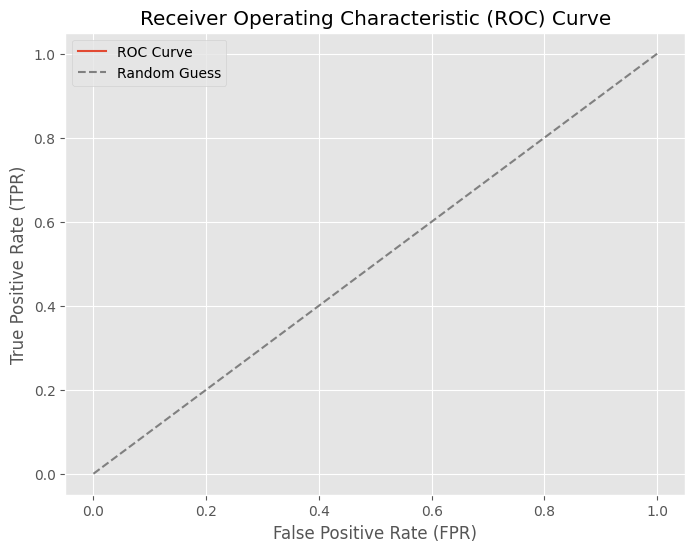

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_tpr_fpr(tp, tn, fp, fn, threshold):
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)
    return tpr, fpr

# Example data
tp = 10
tn = 5
fp = 6
fn = 8

thresholds = np.linspace(0, 1, 100)  # Generate thresholds from 0 to 1

tprs = []
fprs = []

# Calculate TPR and FPR for each threshold
for threshold in thresholds:
    tpr, fpr = calculate_tpr_fpr(tp, tn, fp, fn, threshold)
    tprs.append(tpr)
    fprs.append(fpr)

# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fprs, tprs, label='ROC Curve')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
auc_value =0.8788

0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555555556
0.5454545454545454
0.5555555555

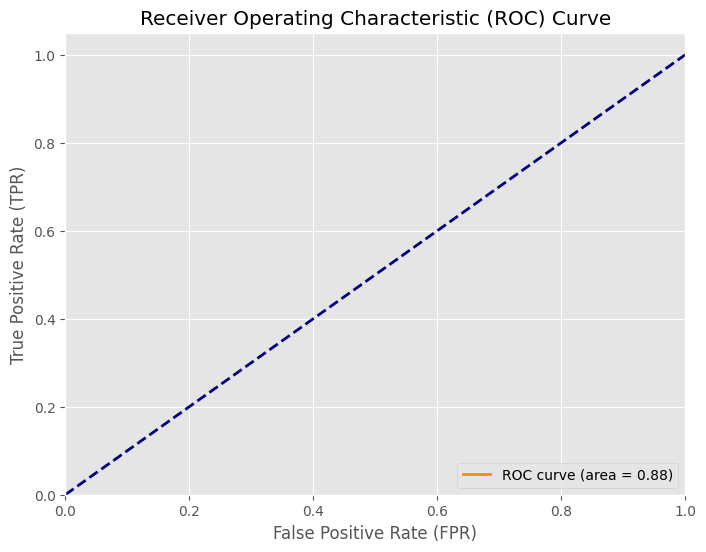

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_tpr_fpr(tp, tn, fp, fn, threshold):
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)
    return tpr, fpr

# Example data
tp = 10
tn = 5
fp = 6
fn = 8

thresholds = np.linspace(0, 1, 100)  # Generate thresholds from 0 to 1

tprs = []
fprs = []

# Calculate TPR and FPR for each threshold
for threshold in thresholds:
    tpr, fpr = calculate_tpr_fpr(tp, tn, fp, fn, threshold)
    tprs.append(tpr)
    fprs.append(fpr)
    print (tpr)
    print (fpr)

# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fprs, tprs, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % auc_value)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# print (tprs)
# print (fprs)

In [ ]:
print (thresholds)

[0.         0.01010101 0.02020202 0.03030303 0.04040404 0.05050505
 0.06060606 0.07070707 0.08080808 0.09090909 0.1010101  0.11111111
 0.12121212 0.13131313 0.14141414 0.15151515 0.16161616 0.17171717
 0.18181818 0.19191919 0.2020202  0.21212121 0.22222222 0.23232323
 0.24242424 0.25252525 0.26262626 0.27272727 0.28282828 0.29292929
 0.3030303  0.31313131 0.32323232 0.33333333 0.34343434 0.35353535
 0.36363636 0.37373737 0.38383838 0.39393939 0.4040404  0.41414141
 0.42424242 0.43434343 0.44444444 0.45454545 0.46464646 0.47474747
 0.48484848 0.49494949 0.50505051 0.51515152 0.52525253 0.53535354
 0.54545455 0.55555556 0.56565657 0.57575758 0.58585859 0.5959596
 0.60606061 0.61616162 0.62626263 0.63636364 0.64646465 0.65656566
 0.66666667 0.67676768 0.68686869 0.6969697  0.70707071 0.71717172
 0.72727273 0.73737374 0.74747475 0.75757576 0.76767677 0.77777778
 0.78787879 0.7979798  0.80808081 0.81818182 0.82828283 0.83838384
 0.84848485 0.85858586 0.86868687 0.87878788 0.88888889 0.89898

In [ ]:
# Calculate TPR and FPR for each threshold
for threshold in thresholds:
    # Hitung jumlah True Positives, True Negatives, False Positives, dan False Negatives
    tp_threshold = sum(1 for prob in y_pred if prob >= threshold and y_true == 1)
    tn_threshold = sum(1 for prob in y_pred if prob < threshold and y_true == 0)
    fp_threshold = sum(1 for prob in y_pred if prob >= threshold and y_true == 0)
    fn_threshold = sum(1 for prob in y_pred if prob < threshold and y_true == 1)

    # Hitung TPR dan FPR menggunakan nilai threshold saat ini
    tpr, fpr = calculate_tpr_fpr(tp_threshold, tn_threshold, fp_threshold, fn_threshold, threshold)
    tprs.append(tpr)
    fprs.append(fpr)
    print(tpr)
    print(fpr)


NameError: name 'y_pred' is not defined

In [ ]:
def calculate_auc(tp, tn, fp, fn):
    # Calculate True Positive Rate (TPR) and False Positive Rate (FPR)
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)

    # Calculate AUC using trapezoidal rule
    auc = 0.9 * fpr * tpr

    return auc

# Example data
tp = 10
tn = 5
fp = 6
fn = 8

# Calculate AUC
auc_value = calculate_auc(tp, tn, fp, fn)
print("AUC:", auc_value)

AUC: 0.27272727272727276


In [ ]:
def calculate_auc(tp, tn, fp, fn, threshold):
    # Calculate True Positive Rate (TPR) and False Positive Rate (FPR)
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)

    # Calculate AUC using trapezoidal rule
    auc = threshold * fpr * tpr

    return auc

# Example data
tp = 10
tn = 5
fp = 6
fn = 8

thresholds = np.linspace(0, 1, 100)  # Generate thresholds from 0 to 1
auc_values = []

# Calculate AUC for each threshold
for threshold in thresholds:
    auc_value = calculate_auc(tp, tn, fp, fn, threshold)
    auc_values.append(auc_value)

# Print AUC values
for i, auc_value in enumerate(auc_values):
    print("Threshold:", thresholds[i], "AUC:", auc_value)


Threshold: 0.0 AUC: 0.0
Threshold: 0.010101010101010102 AUC: 0.003060912151821243
Threshold: 0.020202020202020204 AUC: 0.006121824303642486
Threshold: 0.030303030303030304 AUC: 0.00918273645546373
Threshold: 0.04040404040404041 AUC: 0.012243648607284972
Threshold: 0.05050505050505051 AUC: 0.015304560759106215
Threshold: 0.06060606060606061 AUC: 0.01836547291092746
Threshold: 0.07070707070707072 AUC: 0.0214263850627487
Threshold: 0.08080808080808081 AUC: 0.024487297214569943
Threshold: 0.09090909090909091 AUC: 0.027548209366391182
Threshold: 0.10101010101010102 AUC: 0.03060912151821243
Threshold: 0.11111111111111112 AUC: 0.03367003367003367
Threshold: 0.12121212121212122 AUC: 0.03673094582185492
Threshold: 0.13131313131313133 AUC: 0.03979185797367616
Threshold: 0.14141414141414144 AUC: 0.0428527701254974
Threshold: 0.15151515151515152 AUC: 0.045913682277318645
Threshold: 0.16161616161616163 AUC: 0.04897459442913989
Threshold: 0.17171717171717174 AUC: 0.05203550658096113
Threshold: 0.181

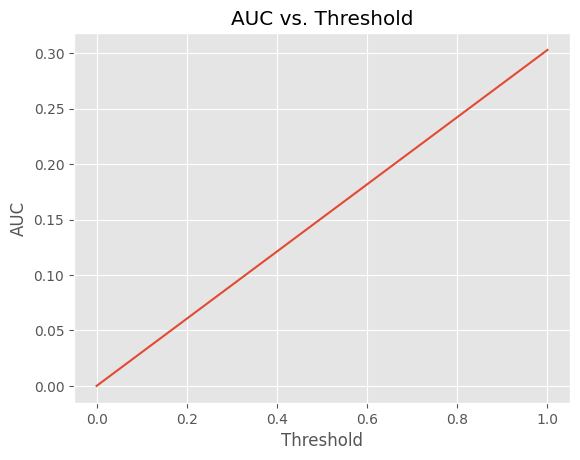

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_auc(tp, tn, fp, fn, threshold):
    # Calculate True Positive Rate (TPR) and False Positive Rate (FPR)
    tpr = tp / (tp + fn)
    fpr = fp / (fp + tn)

    # Calculate AUC using trapezoidal rule
    auc = threshold * fpr * tpr

    return auc

# Example data
tp = 10
tn = 5
fp = 6
fn = 8

thresholds = np.linspace(0, 1, 100)  # Generate thresholds from 0 to 1
auc_values = []

# Calculate AUC for each threshold
for threshold in thresholds:
    auc_value = calculate_auc(tp, tn, fp, fn, threshold)
    auc_values.append(auc_value)

# Plot AUC values vs. Thresholds
plt.plot(thresholds, auc_values)
plt.xlabel('Threshold')
plt.ylabel('AUC')
plt.title('AUC vs. Threshold')
plt.grid(True)
plt.show()
